[Multimedia & Lab] Gachon ConvNet Challenge

Task : **Hint-based Image Colorization**

> Hint-based colorization reconstructs complete colorful images by propagating the color hint given by users. Each solution should first convert the provided RGB image to LAB image. The output will be a predicted "AB" image that will be concatenated with the input L image to produce the final colorized image.

We create U-net based Model and L1 loss, PSNR loss function. But PSNR loss function is the best model we got.





# Get Dataset from Google Drive

In [ ]:
from google.colab import drive  
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
import os
import zipfile
import tqdm

file_name = "Multimedia_dataset.zip"
zip_path = os.path.join('/content/drive/MyDrive/Multimedia_dataset.zip')

!cp "{zip_path}" .
!unzip -q "{file_name}"
!rm "{file_name}"

# Color-Hint Transform

In [ ]:
import torch
from torch.autograd import Variable
from torchvision import transforms

import cv2
import random
import numpy as np

class ColorHintTransform(object):
  def __init__(self, size=256, mode="training"):
    super(ColorHintTransform, self).__init__()
    self.size = size
    self.mode = mode
    self.transform = transforms.Compose([transforms.ToTensor()])

  def bgr_to_lab(self, img):
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, ab = lab[:, :, 0], lab[:, :, 1:]
    return l, ab

  def hint_mask(self, bgr, threshold=[0.95, 0.97, 0.99]):
    h, w, c = bgr.shape
    mask_threshold = random.choice(threshold) # 3 threshold random choice
    mask = np.random.random([h, w, 1]) > mask_threshold # Create a mask with only hint values
    return mask

  def img_to_mask(self, mask_img):
    mask = mask_img[:, :, 0, np.newaxis] >= 255
    return mask

  def __call__(self, img, mask_img=None):
    threshold = [0.95, 0.97, 0.99]
    if (self.mode == "training") | (self.mode == "validation"):
      image = cv2.resize(img, (self.size, self.size))
      mask = self.hint_mask(image, threshold)

      hint_image = image * mask # hint_image we know

      l, ab = self.bgr_to_lab(image) # split image into l and ab
      l_hint, ab_hint = self.bgr_to_lab(hint_image) # split hint_image into l and ab
      return self.transform(l), self.transform(ab), self.transform(ab_hint), self.transform(mask) # l, ab, ab_hint, mask transform apply # Add mask


    elif self.mode == "testing": 
      image = cv2.resize(img, (self.size, self.size))
      mask = self.img_to_mask(mask_img)
      hint_image = image * self.img_to_mask(mask_img) # Changing the image itself to hint_image

      l, _ = self.bgr_to_lab(image)
      _, ab_hint = self.bgr_to_lab(hint_image)

      return self.transform(l), self.transform(ab_hint), self.transform(mask) 

    else:
      return NotImplementedError

# Dataloader for Colorization Dataset

In [ ]:
import torch
import torch.utils.data  as data
import os
import cv2
from google.colab.patches import cv2_imshow

class ColorHintDataset(data.Dataset):
  def __init__(self, root_path, size):
    super(ColorHintDataset, self).__init__()

    self.root_path = root_path
    self.size = size
    self.transforms = None
    self.examples = None
    self.hint = None
    self.mask = None

  def set_mode(self, mode):
    self.mode = mode
    self.transforms = ColorHintTransform(self.size, mode)
    if mode == "training":
      train_dir = os.path.join(self.root_path, "train")
      self.examples = [os.path.join(self.root_path, "train", dirs) for dirs in os.listdir(train_dir)]
    elif mode == "validation":
      val_dir = os.path.join(self.root_path, "validation")
      self.examples = [os.path.join(self.root_path, "validation", dirs) for dirs in os.listdir(val_dir)]
    elif mode == "testing":
      hint_dir = os.path.join(self.root_path, "hint")
      mask_dir = os.path.join(self.root_path, "mask")
      self.hint = [os.path.join(self.root_path, "hint", dirs) for dirs in os.listdir(hint_dir)]
      self.mask = [os.path.join(self.root_path, "mask", dirs) for dirs in os.listdir(mask_dir)]
    else:
      raise NotImplementedError

  def __len__(self):
    if self.mode != "testing":
      return len(self.examples)
    else:
      return len(self.hint)

  def __getitem__(self, idx):
    if self.mode == "testing":
      hint_file_name = self.hint[idx]
      mask_file_name = self.mask[idx]
      hint_img = cv2.imread(hint_file_name)
      mask_img = cv2.imread(mask_file_name) # Add mask


      input_l, input_hint, input_mask = self.transforms(hint_img, mask_img)
      sample = {"l": input_l, "hint": input_hint, "mask": input_mask,
                "file_name": "image_%06d.png" % int(os.path.basename(hint_file_name).split('.')[0])} # Add mask

    else:
      file_name = self.examples[idx]
      img = cv2.imread(file_name)
      l, ab, hint, mask = self.transforms(img) # Add mask
      sample = {"l": l, "ab": ab, "hint": hint, "mask": mask} # Add mask

    return sample

# Example for Loading

In [ ]:
import torch
import torch.utils.data  as data
import os
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from torchvision import transforms
import tqdm
from PIL import Image
import numpy as np

def tensor2im(input_image, imtype=np.uint8): # Tensor type -> image type
  if isinstance(input_image, torch.Tensor):
      image_tensor = input_image.data
  else:
      return input_image
  image_numpy = image_tensor[0].cpu().float().numpy()
  if image_numpy.shape[0] == 1:
      image_numpy = np.tile(image_numpy, (3, 1, 1))
  image_numpy = np.clip((np.transpose(image_numpy, (1, 2, 0)) ),0, 1) * 255.0
  return image_numpy.astype(imtype)

# Change to your data root directory
root_path = "/content/"
# Depend on runtime setting
use_cuda = True

# Get dataset
train_dataset = ColorHintDataset(root_path, 128)
train_dataset.set_mode("training")
print('Train length : ', len(train_dataset))

val_dataset = ColorHintDataset(root_path, 128)
val_dataset.set_mode("validation")
print('Validation length : ', len(val_dataset))

Train length :  4500
Validation length :  500


# Network Construction(Previous)



In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# U-net Based Model
class UnetGenerator(nn.Module):
  def __init__(self, norm_layer=nn.BatchNorm2d):
    super(UnetGenerator, self).__init__()

    self.model_down1 = nn.Sequential(
        nn.Conv2d(4, 64, kernel_size=3, stride=1, padding=1, bias=True),  # l, a, b, mask --> 4 input channels
        norm_layer(64),
        nn.ReLU(),
        nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1, bias=True),
        nn.BatchNorm2d(64),
    )
    
    self.model_down2 = nn.Sequential(
        nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1, bias=True),
        norm_layer(128),
        nn.ReLU(),
        nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1, bias=True),
        nn.BatchNorm2d(128),
    )

    self.model_down3 = nn.Sequential(
        nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1, bias=True),
        norm_layer(256),
        nn.ReLU(),
        nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1, bias=True),
        nn.BatchNorm2d(256),
    )

    self.model_down4 = nn.Sequential(
        nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=1, bias=True),
        norm_layer(512),
        nn.ReLU(),
        nn.Conv2d(512, 512, kernel_size=3, stride=1, padding=1, bias=True),
        nn.BatchNorm2d(512),
    )

    self.pool = nn.MaxPool2d(kernel_size=2, stride=2, padding=0)

    self.model_bridge = nn.Sequential(
        nn.Conv2d(512, 1024, kernel_size=3, stride=1, padding=1, bias=True),
        norm_layer(1024),
        nn.ReLU(),
        nn.Conv2d(1024, 1024, kernel_size=3, stride=1, padding=1, bias=True),
        nn.BatchNorm2d(1024),
        )
    
    self.model_trans1 = nn.Sequential(
        nn.ConvTranspose2d(1024, 512, kernel_size=3, stride=2, padding=1, output_padding=1),
        nn.BatchNorm2d(512),
        nn.ReLU(),
        )
     
    self.model_up1 = nn.Sequential(
        nn.Conv2d(1024, 512, kernel_size=3, stride=1, padding=1),
        nn.BatchNorm2d(512),
        nn.ReLU(),
        nn.Conv2d(512, 512, kernel_size=3, stride=1, padding=1),
        nn.BatchNorm2d(512),
        )
     
    self.model_trans2 = nn.Sequential(
        nn.ConvTranspose2d(512, 256, kernel_size=3, stride=2, padding=1, output_padding=1),
        nn.BatchNorm2d(256),
        nn.ReLU(),
        )
     
    self.model_up2 = nn.Sequential(
        nn.Conv2d(512, 256, kernel_size=3, stride=1, padding=1),
        nn.BatchNorm2d(256),
        nn.ReLU(),
        nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1),
        nn.BatchNorm2d(256),
        )
     
    self.model_trans3 = nn.Sequential(
        nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
        nn.BatchNorm2d(128),
        nn.ReLU(),
        )
     
    self.model_up3 = nn.Sequential(
        nn.Conv2d(256, 128, kernel_size=3, stride=1, padding=1),
        nn.BatchNorm2d(128),
        nn.ReLU(),
        nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
        nn.BatchNorm2d(128),
        )
     
    self.model_trans4 = nn.Sequential(
        nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
        nn.ReLU(),
        nn.ReLU(),
        )
     
    self.model_up4 = nn.Sequential(
        nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1),
        nn.ReLU(),
        nn.ReLU(),
        nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1),
        nn.ReLU(64),
        )
     
    self.model_out = nn.Sequential(
        nn.Conv2d(64, 3, 3, 1, 1), # l, a, b --> 3 output channels
        nn.Tanh(),
        )

  def forward(self, input_lab):
    down1 = self.model_down1(input_lab)
    pool1 = self.pool(down1)
    down2 = self.model_down2(pool1)
    pool2 = self.pool(down2)
    down3 = self.model_down3(pool2)
    pool3 = self.pool(down3)
    down4 = self.model_down4(pool3)
    pool4 = self.pool(down4)

    bridge = self.model_bridge(pool4)

    trans1 = self.model_trans1(bridge)
    concat1 = torch.cat([trans1, down4], dim=1)
    up1 = self.model_up1(concat1)
    trans2 = self.model_trans2(up1)
    concat2 = torch.cat([trans2, down3], dim=1)
    up2 = self.model_up2(concat2)
    trans3 = self.model_trans3(up2)
    concat3 = torch.cat([trans3, down2], dim=1)
    up3 = self.model_up3(concat3)
    trans4 = self.model_trans4(up3)
    concat4 = torch.cat([trans4, down1], dim=1)
    up4 = self.model_up4(concat4)

    return self.model_out(up4)
    

# Network Training

In [ ]:
import torch
import torch.utils.data  as data
import os
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from torchvision import transforms
import tqdm
from PIL import Image
import numpy as np

def tensor2im(input_image, imtype=np.uint8):
  if isinstance(input_image, torch.Tensor):
      image_tensor = input_image.data
  else:
      return input_image
  image_numpy = image_tensor[0].cpu().float().numpy()
  if image_numpy.shape[0] == 1:
      image_numpy = np.tile(image_numpy, (3, 1, 1))
  image_numpy = np.clip((np.transpose(image_numpy, (1, 2, 0)) ),0, 1) * 255.0
  return image_numpy.astype(imtype)

# Change to your data root directory
root_path = "/content/"
# Depend on runtime setting
use_cuda = True

train_dataset = ColorHintDataset(root_path, 128)
train_dataset.set_mode("training")

train_dataloader = data.DataLoader(train_dataset, batch_size=4, shuffle=True)

for i, data in enumerate(tqdm.tqdm(train_dataloader)):
  if use_cuda:
    l = data["l"].to('cuda')
    ab = data["ab"].to('cuda')
    hint = data["hint"].to('cuda')
    mask = data["mask"].to('cuda') # Add mask

  
  gt_image = torch.cat((l, ab), dim=1)
  #print('\n===== img size =====\n', gt_image.shape)
  hint_image = torch.cat((l, hint), dim=1)
  #print('===== hint size =====\n', hint_image.shape)

  gt_np = tensor2im(gt_image)
  hint_np = tensor2im(hint_image)

  gt_bgr = cv2.cvtColor(gt_np, cv2.COLOR_LAB2BGR)
  hint_bgr = cv2.cvtColor(hint_np, cv2.COLOR_LAB2BGR)
  

100%|██████████| 1125/1125 [00:24<00:00, 45.54it/s]


# L1 Loss

In [ ]:
import torch
import torch.utils.data  as data
import os
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from torchvision import transforms
import torch.optim as optim
import tqdm
from PIL import Image
import numpy as np

# Change to your data root directory
root_path = "/content/"
# Depend on runtime setting
device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 

train_dataset = ColorHintDataset(root_path, 128)
train_dataset.set_mode("training")

val_dataset = ColorHintDataset(root_path, 128)
val_dataset.set_mode("validation")

train_dataloader = data.DataLoader(train_dataset, batch_size=4, shuffle=True)
val_dataloader = data.DataLoader(val_dataset, batch_size=4, shuffle=True)

# ================== define helper function ==================

class AverageMeter(object):
  def __init__(self):
    self.reset()
  def reset(self):
    self.val, self.avg, self.sum, self.count = 0, 0, 0, 0
  def update(self, val, n=1):
    self.val = val
    self.sum += val * n
    self.count += n
    self.avg = self.sum / self.count

# ================== define train and validation ==================

def train(model, train_dataloader, optimizer, criterion, epoch):
  print('\n[Training] epoch {} '.format(epoch))
  model.train()
  losses = AverageMeter()
  
  for i, data in enumerate(train_dataloader):
    
    # if use_cuda:
    l = data["l"].cuda()
    ab = data["ab"].cuda()
    hint = data["hint"].cuda()
    mask = data["mask"].cuda()  # Add mask

    
    # concat
    gt_image = torch.cat((l, ab), dim=1).cuda()
    #print('\n===== img size =====\n', gt_image.shape)
    hint_image = torch.cat((l, hint, mask), dim=1).cuda()  # Add mask
    #print('===== hint size =====\n', hint_image.shape)

    # run forward
    output_ab = model(hint_image)
    loss = criterion(output_ab, gt_image)
    losses.update(loss.item(), hint_image.size(0))

    # compute gradient and optimize
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if i%100==0:
      print('Train Epoch : [{}] [{} / {}]\tLoss{loss.val:.4f}'.format(epoch, i, len(train_dataloader),loss=losses))


def validation(model, train_dataloader, criterion, epoch):
  model.eval()
  losses = AverageMeter()
  
  for i, data in enumerate(val_dataloader):
    
    # if use_cuda:
    l = data["l"].cuda()
    ab = data["ab"].cuda()
    hint = data["hint"].cuda()
    mask = data["mask"].cuda() # Add mask


    # concat
    gt_image = torch.cat((l, ab), dim=1).cuda()
    #print('\n===== img size =====\n', gt_image.shape)
    hint_image = torch.cat((l, hint, mask), dim=1).cuda() # Add mask
    #print('===== hint size =====\n', hint_image.shape)

    # run model and store loss
    output_ab = model(hint_image)
    loss = criterion(output_ab, gt_image)
    losses.update(loss.item(), hint_image.size(0))

    if i%100==0:
      print('Validation Epoch : [{} / {}]\tLoss{loss.val:.4f}'.format(i, len(val_dataloader),loss=losses))
      
    gt_np = tensor2im(gt_image)
    #print('\n===== gt size =====\n', gt_np.shape)
    hint_np = tensor2im(output_ab)
    #print('===== hint size =====\n', hint_np.shape)

    gt_bgr = cv2.cvtColor(gt_np, cv2.COLOR_LAB2BGR)
    hint_bgr = cv2.cvtColor(hint_np, cv2.COLOR_LAB2BGR)

    os.makedirs('/content/ground_truth',exist_ok=True)
    cv2.imwrite('/content/ground_truth/gt_'+str(i)+'.jpg',gt_bgr)

    os.makedirs('/content/predictions',exist_ok=True)
    cv2.imwrite('/content/predictions/pred_'+str(i)+'.jpg',hint_bgr)
  
  return losses.avg

# ====================================================

model = UnetGenerator() # load model
print(model)

criterion = nn.L1Loss()
optimizer = optim.Adam(model.parameters(), lr=0.00025)

epochs = 150
best_losses = 1e10

save_path = './Result'
os.makedirs(save_path, exist_ok=True)
output_path = os.path.join(save_path, 'validation_model.tar')

model.cuda()
          
for epoch in range(epochs):
  train(model, train_dataloader, optimizer, criterion, epoch)
  with torch.no_grad():
    val_losses = validation(model, val_dataloader, criterion, epoch)
    print('========== LR ==========\n')


  
  if best_losses > val_losses:
    best_losses = val_losses
    torch.save(model.state_dict(), '/content/drive/MyDrive/Myungji/L1Loss/L1Loss-epoch-{}-losses-{:.5f}.pth'.format(epoch + 1, best_losses))
    

UnetGenerator(
  (model_down1): Sequential(
    (0): Conv2d(4, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (model_down2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (model_down3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d

# Use Scheduler

In [ ]:
import torch
import torch.utils.data  as data
import os
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from torchvision import transforms
import torch.optim as optim
import tqdm
from PIL import Image
import numpy as np

# Change to your data root directory
root_path = "/content/"
# Depend on runtime setting
device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 

train_dataset = ColorHintDataset(root_path, 128)
train_dataset.set_mode("training")

val_dataset = ColorHintDataset(root_path, 128)
val_dataset.set_mode("validation")

train_dataloader = data.DataLoader(train_dataset, batch_size=4, shuffle=True)
val_dataloader = data.DataLoader(val_dataset, batch_size=4, shuffle=True)

# ================== define helper function ==================

class AverageMeter(object):
  def __init__(self):
    self.reset()
  def reset(self):
    self.val, self.avg, self.sum, self.count = 0, 0, 0, 0
  def update(self, val, n=1):
    self.val = val
    self.sum += val * n
    self.count += n
    self.avg = self.sum / self.count

# ================== define train and validation ==================

def train(model, train_dataloader, optimizer, criterion, epoch):
  print('\n[Training] epoch {} '.format(epoch))
  model.train()
  losses = AverageMeter()
  
  for i, data in enumerate(train_dataloader):
    
    # if use_cuda:
    l = data["l"].cuda()
    ab = data["ab"].cuda()
    hint = data["hint"].cuda()
    mask = data["mask"].cuda()
    
    # concat
    gt_image = torch.cat((l, ab), dim=1).cuda()
    #print('\n===== img size =====\n', gt_image.shape)
    hint_image = torch.cat((l, hint, mask), dim=1).cuda()
    #print('===== hint size =====\n', hint_image.shape)

    # run forward
    output_ab = model(hint_image)
    loss = criterion(output_ab, gt_image)
    losses.update(loss.item(), hint_image.size(0))

    # compute gradient and optimize
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if i%100==0:
      print('Train Epoch : [{}] [{} / {}]\tLoss{loss.val:.4f}'.format(epoch, i, len(train_dataloader),loss=losses))


def validation(model, val_dataloader, criterion, epoch):
  model.eval()
  losses = AverageMeter()
  
  for i, data in enumerate(val_dataloader):
    
    # if use_cuda:
    l = data["l"].cuda()
    ab = data["ab"].cuda()
    hint = data["hint"].cuda()
    mask = data["mask"].cuda()

    # concat
    gt_image = torch.cat((l, ab), dim=1).cuda()
    #print('\n===== img size =====\n', gt_image.shape)
    hint_image = torch.cat((l, hint, mask), dim=1).cuda()
    #print('===== hint size =====\n', hint_image.shape)

    # run model and store loss
    output_ab = model(hint_image)
    loss = criterion(output_ab, gt_image)
    losses.update(loss.item(), hint_image.size(0))

    if i%10==0:
      print('Validation Epoch : [{} / {}]\tLoss{loss.val:.4f}'.format(i, len(val_dataloader),loss=losses))
      
    gt_np = tensor2im(gt_image)
    #print('\n===== gt size =====\n', gt_np.shape)
    hint_np = tensor2im(output_ab)
    #print('===== hint size =====\n', hint_np.shape)

    gt_bgr = cv2.cvtColor(gt_np, cv2.COLOR_LAB2BGR)
    hint_bgr = cv2.cvtColor(hint_np, cv2.COLOR_LAB2BGR)

    os.makedirs('/content/ground_truth',exist_ok=True)
    cv2.imwrite('/content/ground_truth/gt_'+str(i)+'.jpg',gt_bgr)

    os.makedirs('/content/predictions',exist_ok=True)
    cv2.imwrite('/content/predictions/pred_'+str(i)+'.jpg',hint_bgr)
  
  return losses.avg

# ====================================================

model = UnetGenerator(in_dim=3, out_dim=3, num_filter=64)
print(model)

criterion = nn.L1Loss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=10)
epochs = 35
best_losses = 1e10

save_path = './result'
os.makedirs(save_path, exist_ok=True)
output_path = os.path.join(save_path, 'validation_model.tar')

model.cuda()
          
for epoch in range(epochs):
  train(model, train_dataloader, optimizer, criterion, epoch)
  with torch.no_grad():
    val_losses = validation(model, val_dataloader, criterion, epoch)
    scheduler.step(val_losses)
  
  if best_losses > val_losses:
    best_losses = val_losses
    torch.save(model.state_dict(), '/content/drive/MyDrive/Myungji/L1Loss_S/L1Loss_S-epoch-{}-losses-{:.5f}.pth'.format(epoch + 1, best_losses))
    


===== Initiating U-Net =====

UnetGenerator(
  (down_1): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (pool_1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (down_2): Sequential(
    (0): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_run

# PSNR Loss

[Training] epoch 0 
Train Epoch : [0] [0 / 1125]	Loss-11.1026
Train Epoch : [0] [100 / 1125]	Loss-29.9425
Train Epoch : [0] [200 / 1125]	Loss-31.0866
Train Epoch : [0] [300 / 1125]	Loss-30.6865
Train Epoch : [0] [400 / 1125]	Loss-28.2536
Train Epoch : [0] [500 / 1125]	Loss-31.0105
Train Epoch : [0] [600 / 1125]	Loss-28.2788
Train Epoch : [0] [700 / 1125]	Loss-31.0466
Train Epoch : [0] [800 / 1125]	Loss-30.9794
Train Epoch : [0] [900 / 1125]	Loss-28.3934
Train Epoch : [0] [1000 / 1125]	Loss-28.0528
Train Epoch : [0] [1100 / 1125]	Loss-32.2798
Validation Epoch : [0 / 125]	Loss-31.2831


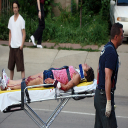

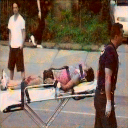

Validation Epoch : [100 / 125]	Loss-32.4062


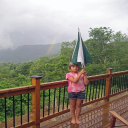

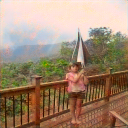

[Training] epoch 1 
Train Epoch : [1] [0 / 1125]	Loss-30.4182
Train Epoch : [1] [100 / 1125]	Loss-37.0833
Train Epoch : [1] [200 / 1125]	Loss-30.4005
Train Epoch : [1] [300 / 1125]	Loss-29.6123
Train Epoch : [1] [400 / 1125]	Loss-34.1746
Train Epoch : [1] [500 / 1125]	Loss-36.8147
Train Epoch : [1] [600 / 1125]	Loss-33.1495
Train Epoch : [1] [700 / 1125]	Loss-32.3659
Train Epoch : [1] [800 / 1125]	Loss-30.7233
Train Epoch : [1] [900 / 1125]	Loss-33.3453
Train Epoch : [1] [1000 / 1125]	Loss-32.6273
Train Epoch : [1] [1100 / 1125]	Loss-31.7869
Validation Epoch : [0 / 125]	Loss-35.2884


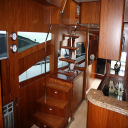

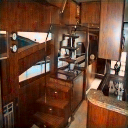

Validation Epoch : [100 / 125]	Loss-35.6207


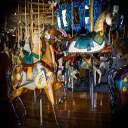

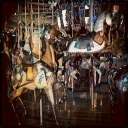

[Training] epoch 2 
Train Epoch : [2] [0 / 1125]	Loss-32.6106
Train Epoch : [2] [100 / 1125]	Loss-36.4498
Train Epoch : [2] [200 / 1125]	Loss-32.6994
Train Epoch : [2] [300 / 1125]	Loss-36.5622
Train Epoch : [2] [400 / 1125]	Loss-36.5754
Train Epoch : [2] [500 / 1125]	Loss-35.2522
Train Epoch : [2] [600 / 1125]	Loss-37.4470
Train Epoch : [2] [700 / 1125]	Loss-33.7659
Train Epoch : [2] [800 / 1125]	Loss-32.9806
Train Epoch : [2] [900 / 1125]	Loss-35.5275
Train Epoch : [2] [1000 / 1125]	Loss-34.7186
Train Epoch : [2] [1100 / 1125]	Loss-34.8052
Validation Epoch : [0 / 125]	Loss-38.3150


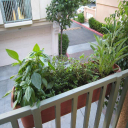

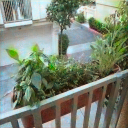

Validation Epoch : [100 / 125]	Loss-38.4980


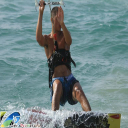

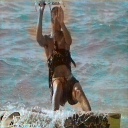

[Training] epoch 3 
Train Epoch : [3] [0 / 1125]	Loss-36.1742
Train Epoch : [3] [100 / 1125]	Loss-32.8834
Train Epoch : [3] [200 / 1125]	Loss-37.4005
Train Epoch : [3] [300 / 1125]	Loss-34.9649
Train Epoch : [3] [400 / 1125]	Loss-38.3514
Train Epoch : [3] [500 / 1125]	Loss-36.5577
Train Epoch : [3] [600 / 1125]	Loss-29.3083
Train Epoch : [3] [700 / 1125]	Loss-35.6894
Train Epoch : [3] [800 / 1125]	Loss-37.8788
Train Epoch : [3] [900 / 1125]	Loss-37.9828
Train Epoch : [3] [1000 / 1125]	Loss-36.8620
Train Epoch : [3] [1100 / 1125]	Loss-37.8566
Validation Epoch : [0 / 125]	Loss-37.1251


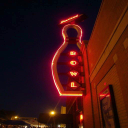

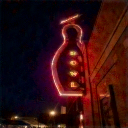

Validation Epoch : [100 / 125]	Loss-35.3055


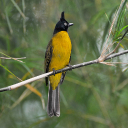

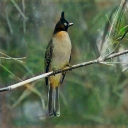

[Training] epoch 4 
Train Epoch : [4] [0 / 1125]	Loss-35.9573
Train Epoch : [4] [100 / 1125]	Loss-36.9157
Train Epoch : [4] [200 / 1125]	Loss-37.4693
Train Epoch : [4] [300 / 1125]	Loss-37.4415
Train Epoch : [4] [400 / 1125]	Loss-35.9563
Train Epoch : [4] [500 / 1125]	Loss-35.4699
Train Epoch : [4] [600 / 1125]	Loss-37.3151
Train Epoch : [4] [700 / 1125]	Loss-36.4487
Train Epoch : [4] [800 / 1125]	Loss-37.5295
Train Epoch : [4] [900 / 1125]	Loss-34.7292
Train Epoch : [4] [1000 / 1125]	Loss-39.2767
Train Epoch : [4] [1100 / 1125]	Loss-36.9358
Validation Epoch : [0 / 125]	Loss-40.1835


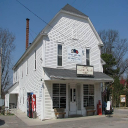

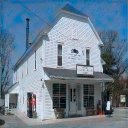

Validation Epoch : [100 / 125]	Loss-37.5762


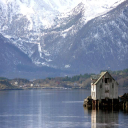

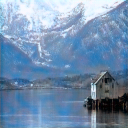

[Training] epoch 5 
Train Epoch : [5] [0 / 1125]	Loss-39.9686
Train Epoch : [5] [100 / 1125]	Loss-34.8086
Train Epoch : [5] [200 / 1125]	Loss-36.9775
Train Epoch : [5] [300 / 1125]	Loss-36.9427
Train Epoch : [5] [400 / 1125]	Loss-36.5460
Train Epoch : [5] [500 / 1125]	Loss-37.1782
Train Epoch : [5] [600 / 1125]	Loss-34.9636
Train Epoch : [5] [700 / 1125]	Loss-39.5829
Train Epoch : [5] [800 / 1125]	Loss-39.1169
Train Epoch : [5] [900 / 1125]	Loss-33.3254
Train Epoch : [5] [1000 / 1125]	Loss-32.5602
Train Epoch : [5] [1100 / 1125]	Loss-37.6668
Validation Epoch : [0 / 125]	Loss-38.5065


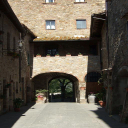

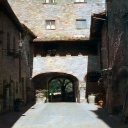

Validation Epoch : [100 / 125]	Loss-37.9107


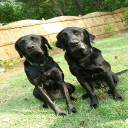

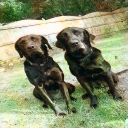

[Training] epoch 6 
Train Epoch : [6] [0 / 1125]	Loss-32.3309
Train Epoch : [6] [100 / 1125]	Loss-39.0428
Train Epoch : [6] [200 / 1125]	Loss-34.8941
Train Epoch : [6] [300 / 1125]	Loss-33.5088
Train Epoch : [6] [400 / 1125]	Loss-38.2804
Train Epoch : [6] [500 / 1125]	Loss-38.3818
Train Epoch : [6] [600 / 1125]	Loss-37.8562
Train Epoch : [6] [700 / 1125]	Loss-37.5507
Train Epoch : [6] [800 / 1125]	Loss-37.3971
Train Epoch : [6] [900 / 1125]	Loss-37.2495
Train Epoch : [6] [1000 / 1125]	Loss-38.3536
Train Epoch : [6] [1100 / 1125]	Loss-38.2842
Validation Epoch : [0 / 125]	Loss-39.5885


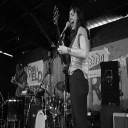

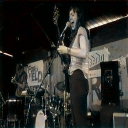

Validation Epoch : [100 / 125]	Loss-38.0170


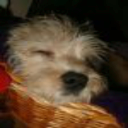

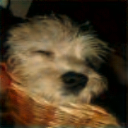

[Training] epoch 7 
Train Epoch : [7] [0 / 1125]	Loss-39.1781
Train Epoch : [7] [100 / 1125]	Loss-37.2395
Train Epoch : [7] [200 / 1125]	Loss-41.8726
Train Epoch : [7] [300 / 1125]	Loss-35.4586
Train Epoch : [7] [400 / 1125]	Loss-38.1007
Train Epoch : [7] [500 / 1125]	Loss-36.2377
Train Epoch : [7] [600 / 1125]	Loss-38.5861
Train Epoch : [7] [700 / 1125]	Loss-38.6909
Train Epoch : [7] [800 / 1125]	Loss-40.3690
Train Epoch : [7] [900 / 1125]	Loss-36.7612
Train Epoch : [7] [1000 / 1125]	Loss-39.4982
Train Epoch : [7] [1100 / 1125]	Loss-37.6701
Validation Epoch : [0 / 125]	Loss-36.6675


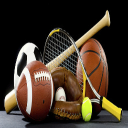

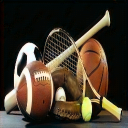

Validation Epoch : [100 / 125]	Loss-36.7107


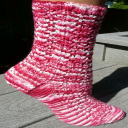

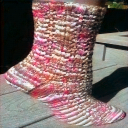

[Training] epoch 8 
Train Epoch : [8] [0 / 1125]	Loss-34.9253
Train Epoch : [8] [100 / 1125]	Loss-38.3592
Train Epoch : [8] [200 / 1125]	Loss-39.0305
Train Epoch : [8] [300 / 1125]	Loss-39.1398
Train Epoch : [8] [400 / 1125]	Loss-39.0744
Train Epoch : [8] [500 / 1125]	Loss-39.1422
Train Epoch : [8] [600 / 1125]	Loss-37.7338
Train Epoch : [8] [700 / 1125]	Loss-35.1871
Train Epoch : [8] [800 / 1125]	Loss-38.3750
Train Epoch : [8] [900 / 1125]	Loss-37.2348
Train Epoch : [8] [1000 / 1125]	Loss-38.8041
Train Epoch : [8] [1100 / 1125]	Loss-36.7700
Validation Epoch : [0 / 125]	Loss-35.8415


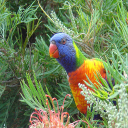

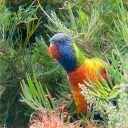

Validation Epoch : [100 / 125]	Loss-39.0882


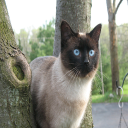

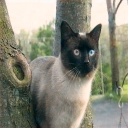

[Training] epoch 9 
Train Epoch : [9] [0 / 1125]	Loss-38.7778
Train Epoch : [9] [100 / 1125]	Loss-34.7041
Train Epoch : [9] [200 / 1125]	Loss-38.0328
Train Epoch : [9] [300 / 1125]	Loss-35.2822
Train Epoch : [9] [400 / 1125]	Loss-41.7698
Train Epoch : [9] [500 / 1125]	Loss-41.4581
Train Epoch : [9] [600 / 1125]	Loss-38.2726
Train Epoch : [9] [700 / 1125]	Loss-35.0084
Train Epoch : [9] [800 / 1125]	Loss-37.3233
Train Epoch : [9] [900 / 1125]	Loss-35.9017
Train Epoch : [9] [1000 / 1125]	Loss-35.7513
Train Epoch : [9] [1100 / 1125]	Loss-35.4658
Validation Epoch : [0 / 125]	Loss-36.5893


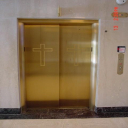

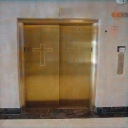

Validation Epoch : [100 / 125]	Loss-39.3277


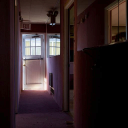

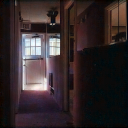

[Training] epoch 10 
Train Epoch : [10] [0 / 1125]	Loss-38.5230
Train Epoch : [10] [100 / 1125]	Loss-33.2635
Train Epoch : [10] [200 / 1125]	Loss-37.9387
Train Epoch : [10] [300 / 1125]	Loss-37.7986
Train Epoch : [10] [400 / 1125]	Loss-37.3311
Train Epoch : [10] [500 / 1125]	Loss-37.6169
Train Epoch : [10] [600 / 1125]	Loss-39.1787
Train Epoch : [10] [700 / 1125]	Loss-42.3541
Train Epoch : [10] [800 / 1125]	Loss-34.5315
Train Epoch : [10] [900 / 1125]	Loss-40.4884
Train Epoch : [10] [1000 / 1125]	Loss-37.4328
Train Epoch : [10] [1100 / 1125]	Loss-41.0662
Validation Epoch : [0 / 125]	Loss-37.6099


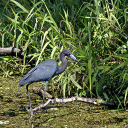

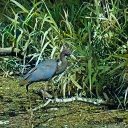

Validation Epoch : [100 / 125]	Loss-38.5930


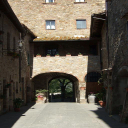

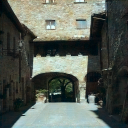

[Training] epoch 11 
Train Epoch : [11] [0 / 1125]	Loss-39.1919
Train Epoch : [11] [100 / 1125]	Loss-37.2473
Train Epoch : [11] [200 / 1125]	Loss-37.8526
Train Epoch : [11] [300 / 1125]	Loss-40.9607
Train Epoch : [11] [400 / 1125]	Loss-35.9118
Train Epoch : [11] [500 / 1125]	Loss-36.7571
Train Epoch : [11] [600 / 1125]	Loss-39.1939
Train Epoch : [11] [700 / 1125]	Loss-39.8316
Train Epoch : [11] [800 / 1125]	Loss-42.0923
Train Epoch : [11] [900 / 1125]	Loss-34.4926
Train Epoch : [11] [1000 / 1125]	Loss-39.0224
Train Epoch : [11] [1100 / 1125]	Loss-36.9289
Validation Epoch : [0 / 125]	Loss-40.8995


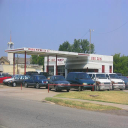

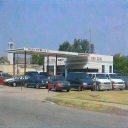

Validation Epoch : [100 / 125]	Loss-39.5390


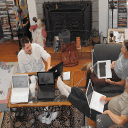

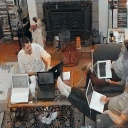

[Training] epoch 12 
Train Epoch : [12] [0 / 1125]	Loss-39.2335
Train Epoch : [12] [100 / 1125]	Loss-38.6615
Train Epoch : [12] [200 / 1125]	Loss-38.9636
Train Epoch : [12] [300 / 1125]	Loss-36.7903
Train Epoch : [12] [400 / 1125]	Loss-39.4607
Train Epoch : [12] [500 / 1125]	Loss-37.6553
Train Epoch : [12] [600 / 1125]	Loss-36.6845
Train Epoch : [12] [700 / 1125]	Loss-39.2211
Train Epoch : [12] [800 / 1125]	Loss-38.4131
Train Epoch : [12] [900 / 1125]	Loss-39.2685
Train Epoch : [12] [1000 / 1125]	Loss-39.9473
Train Epoch : [12] [1100 / 1125]	Loss-34.3051
Validation Epoch : [0 / 125]	Loss-39.2896


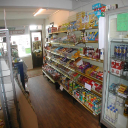

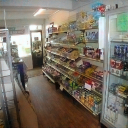

Validation Epoch : [100 / 125]	Loss-40.6108


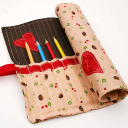

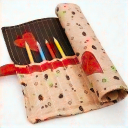

[Training] epoch 13 
Train Epoch : [13] [0 / 1125]	Loss-39.1130
Train Epoch : [13] [100 / 1125]	Loss-39.5376
Train Epoch : [13] [200 / 1125]	Loss-40.5630
Train Epoch : [13] [300 / 1125]	Loss-38.7318
Train Epoch : [13] [400 / 1125]	Loss-38.4828
Train Epoch : [13] [500 / 1125]	Loss-39.5436
Train Epoch : [13] [600 / 1125]	Loss-39.0161
Train Epoch : [13] [700 / 1125]	Loss-39.2162
Train Epoch : [13] [800 / 1125]	Loss-39.2292
Train Epoch : [13] [900 / 1125]	Loss-38.2996
Train Epoch : [13] [1000 / 1125]	Loss-43.2475
Train Epoch : [13] [1100 / 1125]	Loss-37.4847
Validation Epoch : [0 / 125]	Loss-37.5222


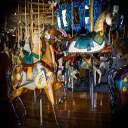

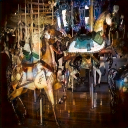

Validation Epoch : [100 / 125]	Loss-37.7453


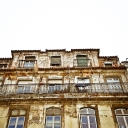

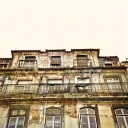

[Training] epoch 14 
Train Epoch : [14] [0 / 1125]	Loss-35.3696
Train Epoch : [14] [100 / 1125]	Loss-39.6070
Train Epoch : [14] [200 / 1125]	Loss-40.7526
Train Epoch : [14] [300 / 1125]	Loss-39.6170
Train Epoch : [14] [400 / 1125]	Loss-38.0827
Train Epoch : [14] [500 / 1125]	Loss-41.1866
Train Epoch : [14] [600 / 1125]	Loss-37.5646
Train Epoch : [14] [700 / 1125]	Loss-36.6886
Train Epoch : [14] [800 / 1125]	Loss-38.6399
Train Epoch : [14] [900 / 1125]	Loss-36.7045
Train Epoch : [14] [1000 / 1125]	Loss-38.5409
Train Epoch : [14] [1100 / 1125]	Loss-41.3225
Validation Epoch : [0 / 125]	Loss-40.6017


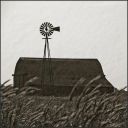

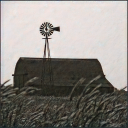

Validation Epoch : [100 / 125]	Loss-40.4414


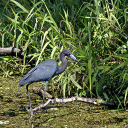

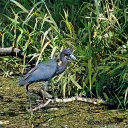

[Training] epoch 15 
Train Epoch : [15] [0 / 1125]	Loss-38.8009
Train Epoch : [15] [100 / 1125]	Loss-32.0046
Train Epoch : [15] [200 / 1125]	Loss-39.0057
Train Epoch : [15] [300 / 1125]	Loss-41.5243
Train Epoch : [15] [400 / 1125]	Loss-40.7156
Train Epoch : [15] [500 / 1125]	Loss-36.6640
Train Epoch : [15] [600 / 1125]	Loss-38.6914
Train Epoch : [15] [700 / 1125]	Loss-37.9662
Train Epoch : [15] [800 / 1125]	Loss-40.9614
Train Epoch : [15] [900 / 1125]	Loss-37.5361
Train Epoch : [15] [1000 / 1125]	Loss-38.5264
Train Epoch : [15] [1100 / 1125]	Loss-38.7827
Validation Epoch : [0 / 125]	Loss-43.5552


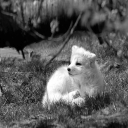

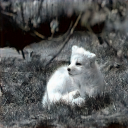

Validation Epoch : [100 / 125]	Loss-41.0762


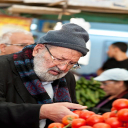

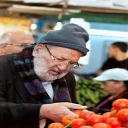

[Training] epoch 16 
Train Epoch : [16] [0 / 1125]	Loss-32.7598
Train Epoch : [16] [100 / 1125]	Loss-39.4159
Train Epoch : [16] [200 / 1125]	Loss-35.7059
Train Epoch : [16] [300 / 1125]	Loss-41.6913
Train Epoch : [16] [400 / 1125]	Loss-38.3128
Train Epoch : [16] [500 / 1125]	Loss-41.3452
Train Epoch : [16] [600 / 1125]	Loss-37.1131
Train Epoch : [16] [700 / 1125]	Loss-36.4838
Train Epoch : [16] [800 / 1125]	Loss-41.2017
Train Epoch : [16] [900 / 1125]	Loss-36.4607
Train Epoch : [16] [1000 / 1125]	Loss-37.5570
Train Epoch : [16] [1100 / 1125]	Loss-37.9003
Validation Epoch : [0 / 125]	Loss-39.7549


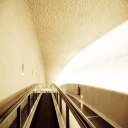

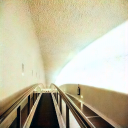

Validation Epoch : [100 / 125]	Loss-39.6131


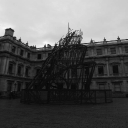

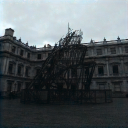

[Training] epoch 17 
Train Epoch : [17] [0 / 1125]	Loss-37.5297
Train Epoch : [17] [100 / 1125]	Loss-34.7199
Train Epoch : [17] [200 / 1125]	Loss-39.4006
Train Epoch : [17] [300 / 1125]	Loss-36.8263
Train Epoch : [17] [400 / 1125]	Loss-36.7799
Train Epoch : [17] [500 / 1125]	Loss-35.6462
Train Epoch : [17] [600 / 1125]	Loss-40.6692
Train Epoch : [17] [700 / 1125]	Loss-39.4339
Train Epoch : [17] [800 / 1125]	Loss-36.4276
Train Epoch : [17] [900 / 1125]	Loss-40.4095
Train Epoch : [17] [1000 / 1125]	Loss-40.3058
Train Epoch : [17] [1100 / 1125]	Loss-43.3625
Validation Epoch : [0 / 125]	Loss-37.2493


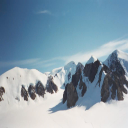

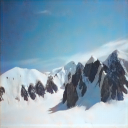

Validation Epoch : [100 / 125]	Loss-38.2122


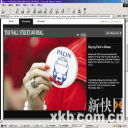

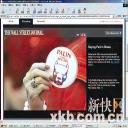

[Training] epoch 18 
Train Epoch : [18] [0 / 1125]	Loss-37.6403
Train Epoch : [18] [100 / 1125]	Loss-40.9885
Train Epoch : [18] [200 / 1125]	Loss-37.7244
Train Epoch : [18] [300 / 1125]	Loss-40.1105
Train Epoch : [18] [400 / 1125]	Loss-38.7821
Train Epoch : [18] [500 / 1125]	Loss-37.8228
Train Epoch : [18] [600 / 1125]	Loss-36.9324
Train Epoch : [18] [700 / 1125]	Loss-40.4179
Train Epoch : [18] [800 / 1125]	Loss-39.9823
Train Epoch : [18] [900 / 1125]	Loss-38.7301
Train Epoch : [18] [1000 / 1125]	Loss-38.1970
Train Epoch : [18] [1100 / 1125]	Loss-40.1457
Validation Epoch : [0 / 125]	Loss-35.9369


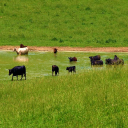

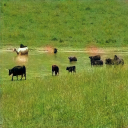

Validation Epoch : [100 / 125]	Loss-42.1057


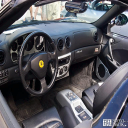

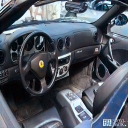

[Training] epoch 19 
Train Epoch : [19] [0 / 1125]	Loss-38.1415
Train Epoch : [19] [100 / 1125]	Loss-39.5915
Train Epoch : [19] [200 / 1125]	Loss-40.0437
Train Epoch : [19] [300 / 1125]	Loss-40.6672
Train Epoch : [19] [400 / 1125]	Loss-38.6671
Train Epoch : [19] [500 / 1125]	Loss-40.7209
Train Epoch : [19] [600 / 1125]	Loss-39.0569
Train Epoch : [19] [700 / 1125]	Loss-36.1825
Train Epoch : [19] [800 / 1125]	Loss-40.0819
Train Epoch : [19] [900 / 1125]	Loss-40.4810
Train Epoch : [19] [1000 / 1125]	Loss-41.4687
Train Epoch : [19] [1100 / 1125]	Loss-37.8584
Validation Epoch : [0 / 125]	Loss-43.0627


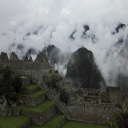

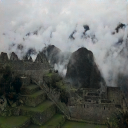

Validation Epoch : [100 / 125]	Loss-40.2148


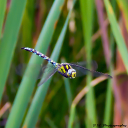

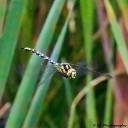

[Training] epoch 20 
Train Epoch : [20] [0 / 1125]	Loss-36.6483
Train Epoch : [20] [100 / 1125]	Loss-38.9029
Train Epoch : [20] [200 / 1125]	Loss-39.7963
Train Epoch : [20] [300 / 1125]	Loss-40.2976
Train Epoch : [20] [400 / 1125]	Loss-39.0806
Train Epoch : [20] [500 / 1125]	Loss-39.8610
Train Epoch : [20] [600 / 1125]	Loss-41.9968
Train Epoch : [20] [700 / 1125]	Loss-42.2156
Train Epoch : [20] [800 / 1125]	Loss-41.6314
Train Epoch : [20] [900 / 1125]	Loss-40.6223
Train Epoch : [20] [1000 / 1125]	Loss-37.0059
Train Epoch : [20] [1100 / 1125]	Loss-42.0402
Validation Epoch : [0 / 125]	Loss-39.6685


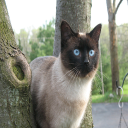

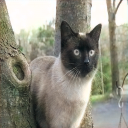

Validation Epoch : [100 / 125]	Loss-39.7819


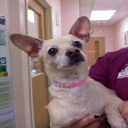

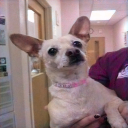

[Training] epoch 21 
Train Epoch : [21] [0 / 1125]	Loss-40.1807
Train Epoch : [21] [100 / 1125]	Loss-40.0300
Train Epoch : [21] [200 / 1125]	Loss-39.1315
Train Epoch : [21] [300 / 1125]	Loss-42.3925
Train Epoch : [21] [400 / 1125]	Loss-37.9605
Train Epoch : [21] [500 / 1125]	Loss-37.9056
Train Epoch : [21] [600 / 1125]	Loss-39.1216
Train Epoch : [21] [700 / 1125]	Loss-39.6787
Train Epoch : [21] [800 / 1125]	Loss-39.4121
Train Epoch : [21] [900 / 1125]	Loss-42.9701
Train Epoch : [21] [1000 / 1125]	Loss-38.2861
Train Epoch : [21] [1100 / 1125]	Loss-34.6186
Validation Epoch : [0 / 125]	Loss-41.3150


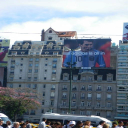

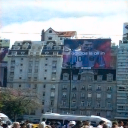

Validation Epoch : [100 / 125]	Loss-40.0621


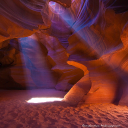

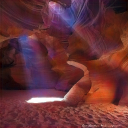

[Training] epoch 22 
Train Epoch : [22] [0 / 1125]	Loss-38.6650
Train Epoch : [22] [100 / 1125]	Loss-37.8191
Train Epoch : [22] [200 / 1125]	Loss-39.3696
Train Epoch : [22] [300 / 1125]	Loss-36.6791
Train Epoch : [22] [400 / 1125]	Loss-40.0948
Train Epoch : [22] [500 / 1125]	Loss-40.2965
Train Epoch : [22] [600 / 1125]	Loss-38.3411
Train Epoch : [22] [700 / 1125]	Loss-40.4042
Train Epoch : [22] [800 / 1125]	Loss-39.5964
Train Epoch : [22] [900 / 1125]	Loss-40.8389
Train Epoch : [22] [1000 / 1125]	Loss-39.3638
Train Epoch : [22] [1100 / 1125]	Loss-38.9409
Validation Epoch : [0 / 125]	Loss-41.1651


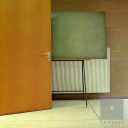

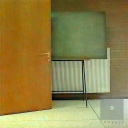

Validation Epoch : [100 / 125]	Loss-39.5547


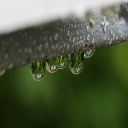

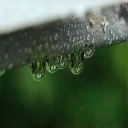

[Training] epoch 23 
Train Epoch : [23] [0 / 1125]	Loss-38.0558
Train Epoch : [23] [100 / 1125]	Loss-41.4136
Train Epoch : [23] [200 / 1125]	Loss-41.6043
Train Epoch : [23] [300 / 1125]	Loss-39.4477
Train Epoch : [23] [400 / 1125]	Loss-39.3162
Train Epoch : [23] [500 / 1125]	Loss-38.1250
Train Epoch : [23] [600 / 1125]	Loss-39.3933
Train Epoch : [23] [700 / 1125]	Loss-37.7665
Train Epoch : [23] [800 / 1125]	Loss-40.2662
Train Epoch : [23] [900 / 1125]	Loss-39.3611
Train Epoch : [23] [1000 / 1125]	Loss-37.7543
Train Epoch : [23] [1100 / 1125]	Loss-39.7177
Validation Epoch : [0 / 125]	Loss-41.2828


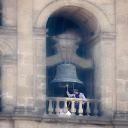

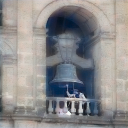

Validation Epoch : [100 / 125]	Loss-42.3358


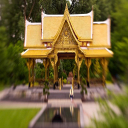

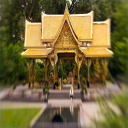

[Training] epoch 24 
Train Epoch : [24] [0 / 1125]	Loss-41.9095
Train Epoch : [24] [100 / 1125]	Loss-43.7719
Train Epoch : [24] [200 / 1125]	Loss-40.7600
Train Epoch : [24] [300 / 1125]	Loss-38.0033
Train Epoch : [24] [400 / 1125]	Loss-38.1426
Train Epoch : [24] [500 / 1125]	Loss-37.1327
Train Epoch : [24] [600 / 1125]	Loss-40.3704
Train Epoch : [24] [700 / 1125]	Loss-39.3829
Train Epoch : [24] [800 / 1125]	Loss-39.3949
Train Epoch : [24] [900 / 1125]	Loss-37.8982
Train Epoch : [24] [1000 / 1125]	Loss-39.6699
Train Epoch : [24] [1100 / 1125]	Loss-41.3994
Validation Epoch : [0 / 125]	Loss-37.3181


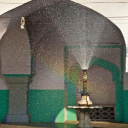

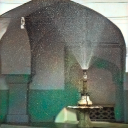

Validation Epoch : [100 / 125]	Loss-35.5268


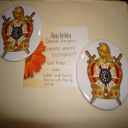

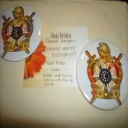

[Training] epoch 25 
Train Epoch : [25] [0 / 1125]	Loss-36.7967
Train Epoch : [25] [100 / 1125]	Loss-41.1076
Train Epoch : [25] [200 / 1125]	Loss-39.8279
Train Epoch : [25] [300 / 1125]	Loss-35.5081
Train Epoch : [25] [400 / 1125]	Loss-41.6510
Train Epoch : [25] [500 / 1125]	Loss-39.3813
Train Epoch : [25] [600 / 1125]	Loss-38.8042
Train Epoch : [25] [700 / 1125]	Loss-39.9116
Train Epoch : [25] [800 / 1125]	Loss-39.4325
Train Epoch : [25] [900 / 1125]	Loss-39.2909
Train Epoch : [25] [1000 / 1125]	Loss-38.2156
Train Epoch : [25] [1100 / 1125]	Loss-39.7242
Validation Epoch : [0 / 125]	Loss-39.4490


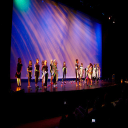

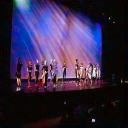

Validation Epoch : [100 / 125]	Loss-39.2433


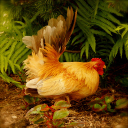

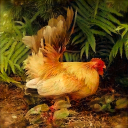

[Training] epoch 26 
Train Epoch : [26] [0 / 1125]	Loss-41.4173
Train Epoch : [26] [100 / 1125]	Loss-41.3361
Train Epoch : [26] [200 / 1125]	Loss-38.4825
Train Epoch : [26] [300 / 1125]	Loss-40.0014
Train Epoch : [26] [400 / 1125]	Loss-40.0887
Train Epoch : [26] [500 / 1125]	Loss-39.2578
Train Epoch : [26] [600 / 1125]	Loss-40.2203
Train Epoch : [26] [700 / 1125]	Loss-42.6156
Train Epoch : [26] [800 / 1125]	Loss-43.1576
Train Epoch : [26] [900 / 1125]	Loss-37.5765
Train Epoch : [26] [1000 / 1125]	Loss-38.4409
Train Epoch : [26] [1100 / 1125]	Loss-43.4934
Validation Epoch : [0 / 125]	Loss-36.7023


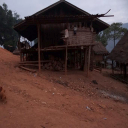

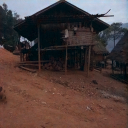

Validation Epoch : [100 / 125]	Loss-40.1586


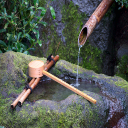

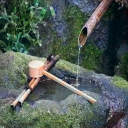

[Training] epoch 27 
Train Epoch : [27] [0 / 1125]	Loss-39.0317
Train Epoch : [27] [100 / 1125]	Loss-37.8867
Train Epoch : [27] [200 / 1125]	Loss-39.9391
Train Epoch : [27] [300 / 1125]	Loss-40.8202
Train Epoch : [27] [400 / 1125]	Loss-40.6687
Train Epoch : [27] [500 / 1125]	Loss-41.2662
Train Epoch : [27] [600 / 1125]	Loss-36.5025
Train Epoch : [27] [700 / 1125]	Loss-39.4349
Train Epoch : [27] [800 / 1125]	Loss-41.1966
Train Epoch : [27] [900 / 1125]	Loss-39.0964
Train Epoch : [27] [1000 / 1125]	Loss-38.2224
Train Epoch : [27] [1100 / 1125]	Loss-39.2971
Validation Epoch : [0 / 125]	Loss-39.3995


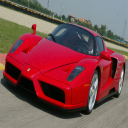

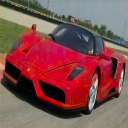

Validation Epoch : [100 / 125]	Loss-41.4669


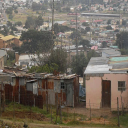

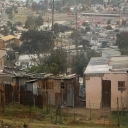

[Training] epoch 28 
Train Epoch : [28] [0 / 1125]	Loss-40.8516
Train Epoch : [28] [100 / 1125]	Loss-36.5243
Train Epoch : [28] [200 / 1125]	Loss-39.0825
Train Epoch : [28] [300 / 1125]	Loss-39.4107
Train Epoch : [28] [400 / 1125]	Loss-36.5149
Train Epoch : [28] [500 / 1125]	Loss-39.2570
Train Epoch : [28] [600 / 1125]	Loss-37.8294
Train Epoch : [28] [700 / 1125]	Loss-38.1467
Train Epoch : [28] [800 / 1125]	Loss-40.9830
Train Epoch : [28] [900 / 1125]	Loss-37.0051
Train Epoch : [28] [1000 / 1125]	Loss-39.4321
Train Epoch : [28] [1100 / 1125]	Loss-41.7643
Validation Epoch : [0 / 125]	Loss-40.5315


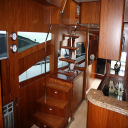

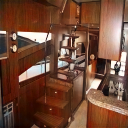

Validation Epoch : [100 / 125]	Loss-42.3082


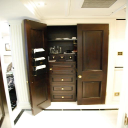

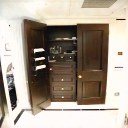

[Training] epoch 29 
Train Epoch : [29] [0 / 1125]	Loss-38.0339
Train Epoch : [29] [100 / 1125]	Loss-39.0355
Train Epoch : [29] [200 / 1125]	Loss-38.3604
Train Epoch : [29] [300 / 1125]	Loss-36.3749
Train Epoch : [29] [400 / 1125]	Loss-38.6677
Train Epoch : [29] [500 / 1125]	Loss-36.1905
Train Epoch : [29] [600 / 1125]	Loss-36.8851
Train Epoch : [29] [700 / 1125]	Loss-41.8048
Train Epoch : [29] [800 / 1125]	Loss-40.5739
Train Epoch : [29] [900 / 1125]	Loss-39.8401
Train Epoch : [29] [1000 / 1125]	Loss-42.5328
Train Epoch : [29] [1100 / 1125]	Loss-40.9053
Validation Epoch : [0 / 125]	Loss-39.6327


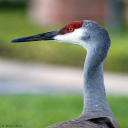

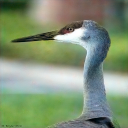

Validation Epoch : [100 / 125]	Loss-36.7505


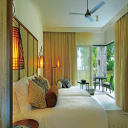

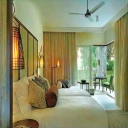

[Training] epoch 30 
Train Epoch : [30] [0 / 1125]	Loss-36.9326
Train Epoch : [30] [100 / 1125]	Loss-40.9288
Train Epoch : [30] [200 / 1125]	Loss-41.4656
Train Epoch : [30] [300 / 1125]	Loss-38.7608
Train Epoch : [30] [400 / 1125]	Loss-40.2827
Train Epoch : [30] [500 / 1125]	Loss-42.7022
Train Epoch : [30] [600 / 1125]	Loss-37.7826
Train Epoch : [30] [700 / 1125]	Loss-40.9092
Train Epoch : [30] [800 / 1125]	Loss-37.5832
Train Epoch : [30] [900 / 1125]	Loss-40.2639
Train Epoch : [30] [1000 / 1125]	Loss-39.7236
Train Epoch : [30] [1100 / 1125]	Loss-40.1209
Validation Epoch : [0 / 125]	Loss-40.8968


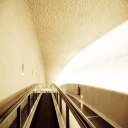

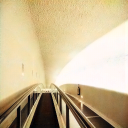

Validation Epoch : [100 / 125]	Loss-37.3953


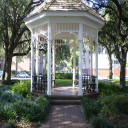

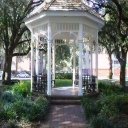

[Training] epoch 31 
Train Epoch : [31] [0 / 1125]	Loss-40.8488
Train Epoch : [31] [100 / 1125]	Loss-39.5854
Train Epoch : [31] [200 / 1125]	Loss-40.1908
Train Epoch : [31] [300 / 1125]	Loss-40.0563
Train Epoch : [31] [400 / 1125]	Loss-40.1952
Train Epoch : [31] [500 / 1125]	Loss-41.0499
Train Epoch : [31] [600 / 1125]	Loss-40.9385
Train Epoch : [31] [700 / 1125]	Loss-38.7201
Train Epoch : [31] [800 / 1125]	Loss-40.4673
Train Epoch : [31] [900 / 1125]	Loss-39.2050
Train Epoch : [31] [1000 / 1125]	Loss-38.7837
Train Epoch : [31] [1100 / 1125]	Loss-40.8615
Validation Epoch : [0 / 125]	Loss-39.1833


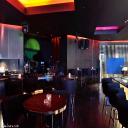

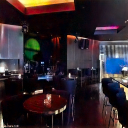

Validation Epoch : [100 / 125]	Loss-37.4640


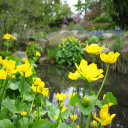

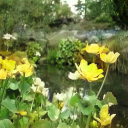

[Training] epoch 32 
Train Epoch : [32] [0 / 1125]	Loss-39.9308
Train Epoch : [32] [100 / 1125]	Loss-41.0236
Train Epoch : [32] [200 / 1125]	Loss-40.6949
Train Epoch : [32] [300 / 1125]	Loss-40.0154
Train Epoch : [32] [400 / 1125]	Loss-41.4606
Train Epoch : [32] [500 / 1125]	Loss-41.9276
Train Epoch : [32] [600 / 1125]	Loss-38.5896
Train Epoch : [32] [700 / 1125]	Loss-41.9724
Train Epoch : [32] [800 / 1125]	Loss-39.3412
Train Epoch : [32] [900 / 1125]	Loss-40.7995
Train Epoch : [32] [1000 / 1125]	Loss-38.3953
Train Epoch : [32] [1100 / 1125]	Loss-44.0026
Validation Epoch : [0 / 125]	Loss-40.0597


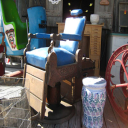

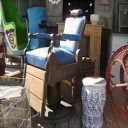

Validation Epoch : [100 / 125]	Loss-42.5685


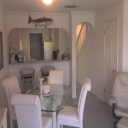

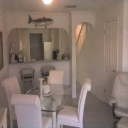

[Training] epoch 33 
Train Epoch : [33] [0 / 1125]	Loss-41.9515
Train Epoch : [33] [100 / 1125]	Loss-39.5009
Train Epoch : [33] [200 / 1125]	Loss-40.5362
Train Epoch : [33] [300 / 1125]	Loss-39.4862
Train Epoch : [33] [400 / 1125]	Loss-40.6182
Train Epoch : [33] [500 / 1125]	Loss-42.7644
Train Epoch : [33] [600 / 1125]	Loss-42.8492
Train Epoch : [33] [700 / 1125]	Loss-42.0718
Train Epoch : [33] [800 / 1125]	Loss-39.6552
Train Epoch : [33] [900 / 1125]	Loss-42.3904
Train Epoch : [33] [1000 / 1125]	Loss-38.5670
Train Epoch : [33] [1100 / 1125]	Loss-41.2927
Validation Epoch : [0 / 125]	Loss-38.7655


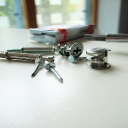

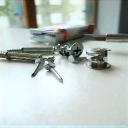

Validation Epoch : [100 / 125]	Loss-41.6871


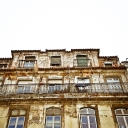

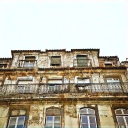

[Training] epoch 34 
Train Epoch : [34] [0 / 1125]	Loss-43.3705
Train Epoch : [34] [100 / 1125]	Loss-32.6221
Train Epoch : [34] [200 / 1125]	Loss-39.7967
Train Epoch : [34] [300 / 1125]	Loss-37.9364
Train Epoch : [34] [400 / 1125]	Loss-42.2510
Train Epoch : [34] [500 / 1125]	Loss-41.2394
Train Epoch : [34] [600 / 1125]	Loss-38.2952
Train Epoch : [34] [700 / 1125]	Loss-41.0810
Train Epoch : [34] [800 / 1125]	Loss-41.9155
Train Epoch : [34] [900 / 1125]	Loss-41.3780
Train Epoch : [34] [1000 / 1125]	Loss-41.5444
Train Epoch : [34] [1100 / 1125]	Loss-37.9585
Validation Epoch : [0 / 125]	Loss-37.3138


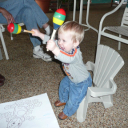

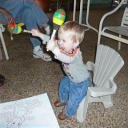

Validation Epoch : [100 / 125]	Loss-39.2808


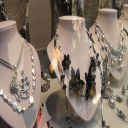

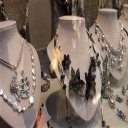

[Training] epoch 35 
Train Epoch : [35] [0 / 1125]	Loss-39.3754
Train Epoch : [35] [100 / 1125]	Loss-38.3717
Train Epoch : [35] [200 / 1125]	Loss-40.5679
Train Epoch : [35] [300 / 1125]	Loss-42.6197
Train Epoch : [35] [400 / 1125]	Loss-39.4326
Train Epoch : [35] [500 / 1125]	Loss-40.5196
Train Epoch : [35] [600 / 1125]	Loss-41.5762
Train Epoch : [35] [700 / 1125]	Loss-41.5682
Train Epoch : [35] [800 / 1125]	Loss-37.5324
Train Epoch : [35] [900 / 1125]	Loss-40.7486
Train Epoch : [35] [1000 / 1125]	Loss-39.7007
Train Epoch : [35] [1100 / 1125]	Loss-41.4797
Validation Epoch : [0 / 125]	Loss-40.3773


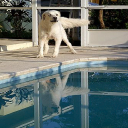

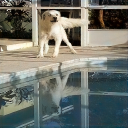

Validation Epoch : [100 / 125]	Loss-37.6104


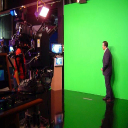

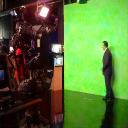

[Training] epoch 36 
Train Epoch : [36] [0 / 1125]	Loss-40.9935
Train Epoch : [36] [100 / 1125]	Loss-40.6194
Train Epoch : [36] [200 / 1125]	Loss-37.5912
Train Epoch : [36] [300 / 1125]	Loss-40.7091
Train Epoch : [36] [400 / 1125]	Loss-42.6236
Train Epoch : [36] [500 / 1125]	Loss-38.4687
Train Epoch : [36] [600 / 1125]	Loss-40.5908
Train Epoch : [36] [700 / 1125]	Loss-39.6256
Train Epoch : [36] [800 / 1125]	Loss-37.4981
Train Epoch : [36] [900 / 1125]	Loss-39.4113
Train Epoch : [36] [1000 / 1125]	Loss-37.1680
Train Epoch : [36] [1100 / 1125]	Loss-40.2928
Validation Epoch : [0 / 125]	Loss-43.8962


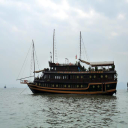

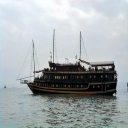

Validation Epoch : [100 / 125]	Loss-42.9973


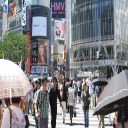

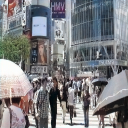

[Training] epoch 37 
Train Epoch : [37] [0 / 1125]	Loss-40.5486
Train Epoch : [37] [100 / 1125]	Loss-38.5159
Train Epoch : [37] [200 / 1125]	Loss-35.8614
Train Epoch : [37] [300 / 1125]	Loss-40.3822
Train Epoch : [37] [400 / 1125]	Loss-40.1904
Train Epoch : [37] [500 / 1125]	Loss-40.7011
Train Epoch : [37] [600 / 1125]	Loss-42.0052
Train Epoch : [37] [700 / 1125]	Loss-41.8402
Train Epoch : [37] [800 / 1125]	Loss-41.9550
Train Epoch : [37] [900 / 1125]	Loss-39.3861
Train Epoch : [37] [1000 / 1125]	Loss-42.4137
Train Epoch : [37] [1100 / 1125]	Loss-39.3265
Validation Epoch : [0 / 125]	Loss-39.3099


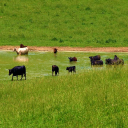

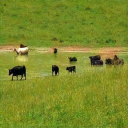

Validation Epoch : [100 / 125]	Loss-39.3148


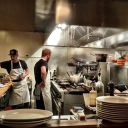

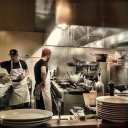

[Training] epoch 38 
Train Epoch : [38] [0 / 1125]	Loss-41.1576
Train Epoch : [38] [100 / 1125]	Loss-41.5932
Train Epoch : [38] [200 / 1125]	Loss-38.9790
Train Epoch : [38] [300 / 1125]	Loss-40.3538
Train Epoch : [38] [400 / 1125]	Loss-42.1132
Train Epoch : [38] [500 / 1125]	Loss-44.1669
Train Epoch : [38] [600 / 1125]	Loss-39.5816
Train Epoch : [38] [700 / 1125]	Loss-38.9941
Train Epoch : [38] [800 / 1125]	Loss-41.4584
Train Epoch : [38] [900 / 1125]	Loss-39.8177
Train Epoch : [38] [1000 / 1125]	Loss-40.3100
Train Epoch : [38] [1100 / 1125]	Loss-43.9190
Validation Epoch : [0 / 125]	Loss-42.3829


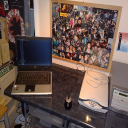

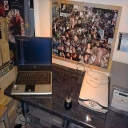

Validation Epoch : [100 / 125]	Loss-41.6984


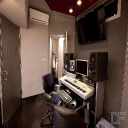

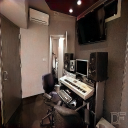

[Training] epoch 39 
Train Epoch : [39] [0 / 1125]	Loss-41.6593
Train Epoch : [39] [100 / 1125]	Loss-40.0371
Train Epoch : [39] [200 / 1125]	Loss-42.1081
Train Epoch : [39] [300 / 1125]	Loss-40.9432
Train Epoch : [39] [400 / 1125]	Loss-37.6810
Train Epoch : [39] [500 / 1125]	Loss-34.1952
Train Epoch : [39] [600 / 1125]	Loss-42.3260
Train Epoch : [39] [700 / 1125]	Loss-36.8176
Train Epoch : [39] [800 / 1125]	Loss-37.4938
Train Epoch : [39] [900 / 1125]	Loss-42.9585
Train Epoch : [39] [1000 / 1125]	Loss-41.8415
Train Epoch : [39] [1100 / 1125]	Loss-42.2443
Validation Epoch : [0 / 125]	Loss-39.7180


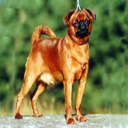

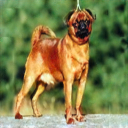

Validation Epoch : [100 / 125]	Loss-41.2209


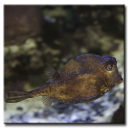

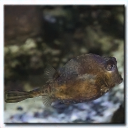

[Training] epoch 40 
Train Epoch : [40] [0 / 1125]	Loss-41.0397
Train Epoch : [40] [100 / 1125]	Loss-39.5565
Train Epoch : [40] [200 / 1125]	Loss-41.7869
Train Epoch : [40] [300 / 1125]	Loss-41.3256
Train Epoch : [40] [400 / 1125]	Loss-39.0028
Train Epoch : [40] [500 / 1125]	Loss-42.2586
Train Epoch : [40] [600 / 1125]	Loss-39.5782
Train Epoch : [40] [700 / 1125]	Loss-42.7401
Train Epoch : [40] [800 / 1125]	Loss-39.4406
Train Epoch : [40] [900 / 1125]	Loss-39.0796
Train Epoch : [40] [1000 / 1125]	Loss-38.9115
Train Epoch : [40] [1100 / 1125]	Loss-42.4635
Validation Epoch : [0 / 125]	Loss-35.5960


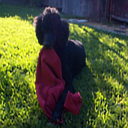

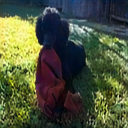

Validation Epoch : [100 / 125]	Loss-42.5522


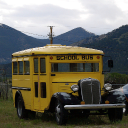

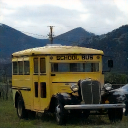

[Training] epoch 41 
Train Epoch : [41] [0 / 1125]	Loss-40.9022
Train Epoch : [41] [100 / 1125]	Loss-37.5247
Train Epoch : [41] [200 / 1125]	Loss-42.9273
Train Epoch : [41] [300 / 1125]	Loss-44.4067
Train Epoch : [41] [400 / 1125]	Loss-39.8643
Train Epoch : [41] [500 / 1125]	Loss-38.9490
Train Epoch : [41] [600 / 1125]	Loss-44.6209
Train Epoch : [41] [700 / 1125]	Loss-42.4733
Train Epoch : [41] [800 / 1125]	Loss-41.1883
Train Epoch : [41] [900 / 1125]	Loss-40.7946
Train Epoch : [41] [1000 / 1125]	Loss-40.4153
Train Epoch : [41] [1100 / 1125]	Loss-38.3276
Validation Epoch : [0 / 125]	Loss-42.6979


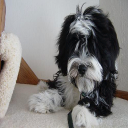

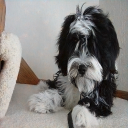

Validation Epoch : [100 / 125]	Loss-40.9418


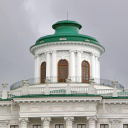

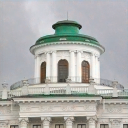

[Training] epoch 42 
Train Epoch : [42] [0 / 1125]	Loss-41.1036
Train Epoch : [42] [100 / 1125]	Loss-39.4206
Train Epoch : [42] [200 / 1125]	Loss-40.3971
Train Epoch : [42] [300 / 1125]	Loss-42.1004
Train Epoch : [42] [400 / 1125]	Loss-40.1242
Train Epoch : [42] [500 / 1125]	Loss-42.2784
Train Epoch : [42] [600 / 1125]	Loss-41.7686
Train Epoch : [42] [700 / 1125]	Loss-44.1918
Train Epoch : [42] [800 / 1125]	Loss-42.0438
Train Epoch : [42] [900 / 1125]	Loss-39.0566
Train Epoch : [42] [1000 / 1125]	Loss-43.3455
Train Epoch : [42] [1100 / 1125]	Loss-42.9789
Validation Epoch : [0 / 125]	Loss-43.2380


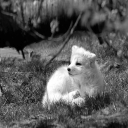

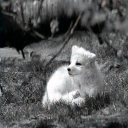

Validation Epoch : [100 / 125]	Loss-40.6432


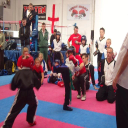

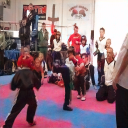

[Training] epoch 43 
Train Epoch : [43] [0 / 1125]	Loss-42.1177
Train Epoch : [43] [100 / 1125]	Loss-40.9470
Train Epoch : [43] [200 / 1125]	Loss-43.1780
Train Epoch : [43] [300 / 1125]	Loss-40.2954
Train Epoch : [43] [400 / 1125]	Loss-38.7805
Train Epoch : [43] [500 / 1125]	Loss-40.6779
Train Epoch : [43] [600 / 1125]	Loss-40.8378
Train Epoch : [43] [700 / 1125]	Loss-39.6760
Train Epoch : [43] [800 / 1125]	Loss-39.6544
Train Epoch : [43] [900 / 1125]	Loss-43.7236
Train Epoch : [43] [1000 / 1125]	Loss-38.1161
Train Epoch : [43] [1100 / 1125]	Loss-38.8023
Validation Epoch : [0 / 125]	Loss-40.8716


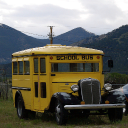

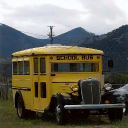

Validation Epoch : [100 / 125]	Loss-42.4097


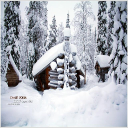

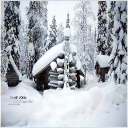

[Training] epoch 44 
Train Epoch : [44] [0 / 1125]	Loss-43.3615
Train Epoch : [44] [100 / 1125]	Loss-42.0913
Train Epoch : [44] [200 / 1125]	Loss-46.6574
Train Epoch : [44] [300 / 1125]	Loss-38.7280
Train Epoch : [44] [400 / 1125]	Loss-39.1751
Train Epoch : [44] [500 / 1125]	Loss-38.5006
Train Epoch : [44] [600 / 1125]	Loss-41.3894
Train Epoch : [44] [700 / 1125]	Loss-41.9881
Train Epoch : [44] [800 / 1125]	Loss-39.1069
Train Epoch : [44] [900 / 1125]	Loss-39.7650
Train Epoch : [44] [1000 / 1125]	Loss-42.1069
Train Epoch : [44] [1100 / 1125]	Loss-40.1512
Validation Epoch : [0 / 125]	Loss-43.5064


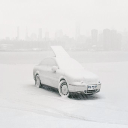

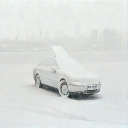

Validation Epoch : [100 / 125]	Loss-38.6511


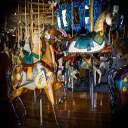

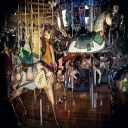

[Training] epoch 45 
Train Epoch : [45] [0 / 1125]	Loss-42.4769
Train Epoch : [45] [100 / 1125]	Loss-38.5797
Train Epoch : [45] [200 / 1125]	Loss-40.2350
Train Epoch : [45] [300 / 1125]	Loss-42.0521
Train Epoch : [45] [400 / 1125]	Loss-41.0333
Train Epoch : [45] [500 / 1125]	Loss-41.8934
Train Epoch : [45] [600 / 1125]	Loss-43.2045
Train Epoch : [45] [700 / 1125]	Loss-43.0389
Train Epoch : [45] [800 / 1125]	Loss-42.8670
Train Epoch : [45] [900 / 1125]	Loss-40.2858
Train Epoch : [45] [1000 / 1125]	Loss-39.8172
Train Epoch : [45] [1100 / 1125]	Loss-39.2645
Validation Epoch : [0 / 125]	Loss-42.1187


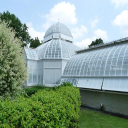

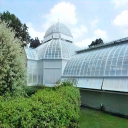

Validation Epoch : [100 / 125]	Loss-41.5120


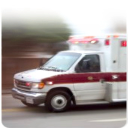

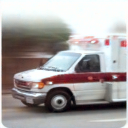

[Training] epoch 46 
Train Epoch : [46] [0 / 1125]	Loss-43.2177
Train Epoch : [46] [100 / 1125]	Loss-41.1789
Train Epoch : [46] [200 / 1125]	Loss-41.7117
Train Epoch : [46] [300 / 1125]	Loss-40.0632
Train Epoch : [46] [400 / 1125]	Loss-41.4867
Train Epoch : [46] [500 / 1125]	Loss-37.6367
Train Epoch : [46] [600 / 1125]	Loss-39.5035
Train Epoch : [46] [700 / 1125]	Loss-43.9222
Train Epoch : [46] [800 / 1125]	Loss-40.1617
Train Epoch : [46] [900 / 1125]	Loss-42.8535
Train Epoch : [46] [1000 / 1125]	Loss-41.1990
Train Epoch : [46] [1100 / 1125]	Loss-44.6866
Validation Epoch : [0 / 125]	Loss-41.1639


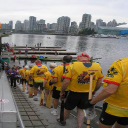

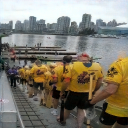

Validation Epoch : [100 / 125]	Loss-42.8538


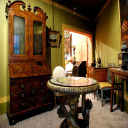

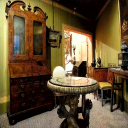

[Training] epoch 47 
Train Epoch : [47] [0 / 1125]	Loss-39.4681
Train Epoch : [47] [100 / 1125]	Loss-41.6876
Train Epoch : [47] [200 / 1125]	Loss-42.6373
Train Epoch : [47] [300 / 1125]	Loss-42.9591
Train Epoch : [47] [400 / 1125]	Loss-40.3296
Train Epoch : [47] [500 / 1125]	Loss-40.5440
Train Epoch : [47] [600 / 1125]	Loss-44.2252
Train Epoch : [47] [700 / 1125]	Loss-43.8472
Train Epoch : [47] [800 / 1125]	Loss-45.1952
Train Epoch : [47] [900 / 1125]	Loss-38.6243
Train Epoch : [47] [1000 / 1125]	Loss-42.8406
Train Epoch : [47] [1100 / 1125]	Loss-41.1610
Validation Epoch : [0 / 125]	Loss-43.1471


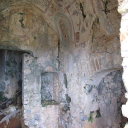

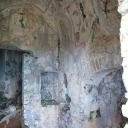

Validation Epoch : [100 / 125]	Loss-41.8270


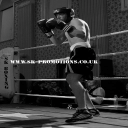

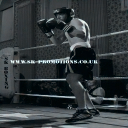

[Training] epoch 48 
Train Epoch : [48] [0 / 1125]	Loss-41.1622
Train Epoch : [48] [100 / 1125]	Loss-45.3792
Train Epoch : [48] [200 / 1125]	Loss-41.3238
Train Epoch : [48] [300 / 1125]	Loss-44.2333
Train Epoch : [48] [400 / 1125]	Loss-42.9706
Train Epoch : [48] [500 / 1125]	Loss-37.7131
Train Epoch : [48] [600 / 1125]	Loss-42.5420
Train Epoch : [48] [700 / 1125]	Loss-35.5345
Train Epoch : [48] [800 / 1125]	Loss-41.2403
Train Epoch : [48] [900 / 1125]	Loss-41.5066
Train Epoch : [48] [1000 / 1125]	Loss-41.3977
Train Epoch : [48] [1100 / 1125]	Loss-40.6808
Validation Epoch : [0 / 125]	Loss-41.8678


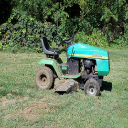

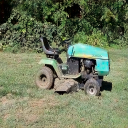

Validation Epoch : [100 / 125]	Loss-40.5049


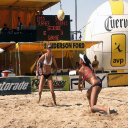

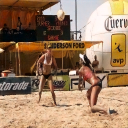

[Training] epoch 49 
Train Epoch : [49] [0 / 1125]	Loss-41.0006
Train Epoch : [49] [100 / 1125]	Loss-45.0655
Train Epoch : [49] [200 / 1125]	Loss-41.7908
Train Epoch : [49] [300 / 1125]	Loss-41.9024
Train Epoch : [49] [400 / 1125]	Loss-40.3156
Train Epoch : [49] [500 / 1125]	Loss-39.8790
Train Epoch : [49] [600 / 1125]	Loss-43.7158
Train Epoch : [49] [700 / 1125]	Loss-38.8212
Train Epoch : [49] [800 / 1125]	Loss-40.0708
Train Epoch : [49] [900 / 1125]	Loss-42.5520
Train Epoch : [49] [1000 / 1125]	Loss-41.7393
Train Epoch : [49] [1100 / 1125]	Loss-41.9368
Validation Epoch : [0 / 125]	Loss-43.0938


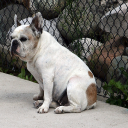

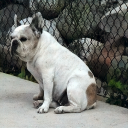

Validation Epoch : [100 / 125]	Loss-41.9768


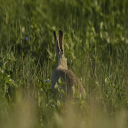

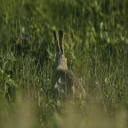

[Training] epoch 50 
Train Epoch : [50] [0 / 1125]	Loss-40.7833
Train Epoch : [50] [100 / 1125]	Loss-41.2594
Train Epoch : [50] [200 / 1125]	Loss-44.4270
Train Epoch : [50] [300 / 1125]	Loss-41.9247
Train Epoch : [50] [400 / 1125]	Loss-40.4197
Train Epoch : [50] [500 / 1125]	Loss-38.5227
Train Epoch : [50] [600 / 1125]	Loss-42.4114
Train Epoch : [50] [700 / 1125]	Loss-40.8927
Train Epoch : [50] [800 / 1125]	Loss-43.8288
Train Epoch : [50] [900 / 1125]	Loss-43.4361
Train Epoch : [50] [1000 / 1125]	Loss-40.8348
Train Epoch : [50] [1100 / 1125]	Loss-42.8139
Validation Epoch : [0 / 125]	Loss-41.5763


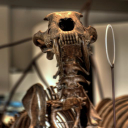

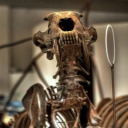

Validation Epoch : [100 / 125]	Loss-45.9433


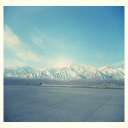

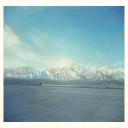

[Training] epoch 51 
Train Epoch : [51] [0 / 1125]	Loss-43.6531
Train Epoch : [51] [100 / 1125]	Loss-40.3944
Train Epoch : [51] [200 / 1125]	Loss-40.5844
Train Epoch : [51] [300 / 1125]	Loss-40.3945
Train Epoch : [51] [400 / 1125]	Loss-44.0648
Train Epoch : [51] [500 / 1125]	Loss-42.8099
Train Epoch : [51] [600 / 1125]	Loss-41.7957
Train Epoch : [51] [700 / 1125]	Loss-43.2897
Train Epoch : [51] [800 / 1125]	Loss-40.7335
Train Epoch : [51] [900 / 1125]	Loss-41.3917
Train Epoch : [51] [1000 / 1125]	Loss-39.2904
Train Epoch : [51] [1100 / 1125]	Loss-39.9005
Validation Epoch : [0 / 125]	Loss-41.4540


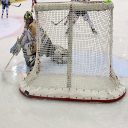

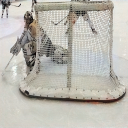

Validation Epoch : [100 / 125]	Loss-42.1629


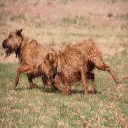

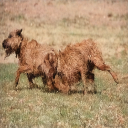

[Training] epoch 52 
Train Epoch : [52] [0 / 1125]	Loss-39.3455
Train Epoch : [52] [100 / 1125]	Loss-40.9982
Train Epoch : [52] [200 / 1125]	Loss-43.0678
Train Epoch : [52] [300 / 1125]	Loss-41.3598
Train Epoch : [52] [400 / 1125]	Loss-41.7586
Train Epoch : [52] [500 / 1125]	Loss-42.1645
Train Epoch : [52] [600 / 1125]	Loss-44.4580
Train Epoch : [52] [700 / 1125]	Loss-40.1759
Train Epoch : [52] [800 / 1125]	Loss-38.4671
Train Epoch : [52] [900 / 1125]	Loss-43.2551
Train Epoch : [52] [1000 / 1125]	Loss-41.0509
Train Epoch : [52] [1100 / 1125]	Loss-41.0567
Validation Epoch : [0 / 125]	Loss-44.8951


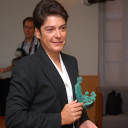

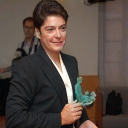

Validation Epoch : [100 / 125]	Loss-41.1020


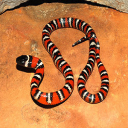

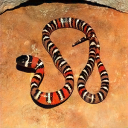

[Training] epoch 53 
Train Epoch : [53] [0 / 1125]	Loss-42.0507
Train Epoch : [53] [100 / 1125]	Loss-39.8614
Train Epoch : [53] [200 / 1125]	Loss-43.8029
Train Epoch : [53] [300 / 1125]	Loss-37.2246
Train Epoch : [53] [400 / 1125]	Loss-36.4743
Train Epoch : [53] [500 / 1125]	Loss-42.5074
Train Epoch : [53] [600 / 1125]	Loss-42.1651
Train Epoch : [53] [700 / 1125]	Loss-40.6038
Train Epoch : [53] [800 / 1125]	Loss-39.8041
Train Epoch : [53] [900 / 1125]	Loss-38.2353
Train Epoch : [53] [1000 / 1125]	Loss-42.6881
Train Epoch : [53] [1100 / 1125]	Loss-41.2736
Validation Epoch : [0 / 125]	Loss-41.8918


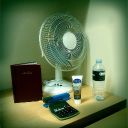

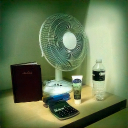

Validation Epoch : [100 / 125]	Loss-38.4556


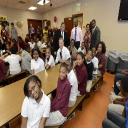

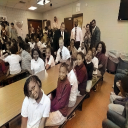

[Training] epoch 54 
Train Epoch : [54] [0 / 1125]	Loss-41.7259
Train Epoch : [54] [100 / 1125]	Loss-41.5306
Train Epoch : [54] [200 / 1125]	Loss-44.5814
Train Epoch : [54] [300 / 1125]	Loss-42.2317
Train Epoch : [54] [400 / 1125]	Loss-41.6886
Train Epoch : [54] [500 / 1125]	Loss-43.7826
Train Epoch : [54] [600 / 1125]	Loss-41.5611
Train Epoch : [54] [700 / 1125]	Loss-44.9376
Train Epoch : [54] [800 / 1125]	Loss-40.4758
Train Epoch : [54] [900 / 1125]	Loss-41.7765
Train Epoch : [54] [1000 / 1125]	Loss-39.9377
Train Epoch : [54] [1100 / 1125]	Loss-39.4542
Validation Epoch : [0 / 125]	Loss-40.6616


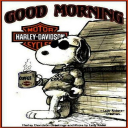

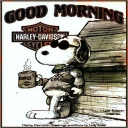

Validation Epoch : [100 / 125]	Loss-41.6235


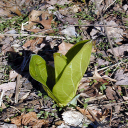

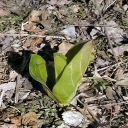

[Training] epoch 55 
Train Epoch : [55] [0 / 1125]	Loss-38.3757
Train Epoch : [55] [100 / 1125]	Loss-41.4253
Train Epoch : [55] [200 / 1125]	Loss-41.2517
Train Epoch : [55] [300 / 1125]	Loss-43.3352
Train Epoch : [55] [400 / 1125]	Loss-41.4252
Train Epoch : [55] [500 / 1125]	Loss-39.8387
Train Epoch : [55] [600 / 1125]	Loss-39.1272
Train Epoch : [55] [700 / 1125]	Loss-40.7335
Train Epoch : [55] [800 / 1125]	Loss-38.3673
Train Epoch : [55] [900 / 1125]	Loss-38.9595
Train Epoch : [55] [1000 / 1125]	Loss-38.9934
Train Epoch : [55] [1100 / 1125]	Loss-40.1062
Validation Epoch : [0 / 125]	Loss-40.0625


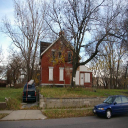

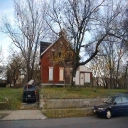

Validation Epoch : [100 / 125]	Loss-37.9524


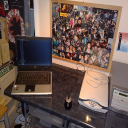

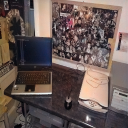

[Training] epoch 56 
Train Epoch : [56] [0 / 1125]	Loss-45.7286
Train Epoch : [56] [100 / 1125]	Loss-41.0959
Train Epoch : [56] [200 / 1125]	Loss-41.4747
Train Epoch : [56] [300 / 1125]	Loss-40.6089
Train Epoch : [56] [400 / 1125]	Loss-40.2287
Train Epoch : [56] [500 / 1125]	Loss-41.8000
Train Epoch : [56] [600 / 1125]	Loss-38.2894
Train Epoch : [56] [700 / 1125]	Loss-40.7811
Train Epoch : [56] [800 / 1125]	Loss-40.5187
Train Epoch : [56] [900 / 1125]	Loss-39.3582
Train Epoch : [56] [1000 / 1125]	Loss-42.0263
Train Epoch : [56] [1100 / 1125]	Loss-43.5741
Validation Epoch : [0 / 125]	Loss-39.3793


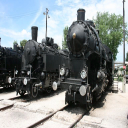

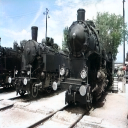

Validation Epoch : [100 / 125]	Loss-44.1911


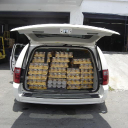

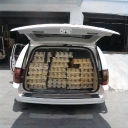

[Training] epoch 57 
Train Epoch : [57] [0 / 1125]	Loss-41.4579
Train Epoch : [57] [100 / 1125]	Loss-43.2296
Train Epoch : [57] [200 / 1125]	Loss-39.9137
Train Epoch : [57] [300 / 1125]	Loss-40.4597
Train Epoch : [57] [400 / 1125]	Loss-42.2215
Train Epoch : [57] [500 / 1125]	Loss-43.0999
Train Epoch : [57] [600 / 1125]	Loss-43.0766
Train Epoch : [57] [700 / 1125]	Loss-43.4001
Train Epoch : [57] [800 / 1125]	Loss-36.8827
Train Epoch : [57] [900 / 1125]	Loss-41.6561
Train Epoch : [57] [1000 / 1125]	Loss-42.0359
Train Epoch : [57] [1100 / 1125]	Loss-41.4462
Validation Epoch : [0 / 125]	Loss-42.4658


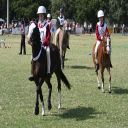

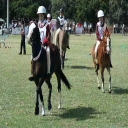

Validation Epoch : [100 / 125]	Loss-39.7203


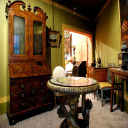

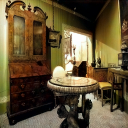

[Training] epoch 58 
Train Epoch : [58] [0 / 1125]	Loss-42.5525
Train Epoch : [58] [100 / 1125]	Loss-41.8218
Train Epoch : [58] [200 / 1125]	Loss-37.3977
Train Epoch : [58] [300 / 1125]	Loss-41.6214
Train Epoch : [58] [400 / 1125]	Loss-40.8659
Train Epoch : [58] [500 / 1125]	Loss-42.2585
Train Epoch : [58] [600 / 1125]	Loss-41.8782
Train Epoch : [58] [700 / 1125]	Loss-39.9939
Train Epoch : [58] [800 / 1125]	Loss-44.2881
Train Epoch : [58] [900 / 1125]	Loss-39.7578
Train Epoch : [58] [1000 / 1125]	Loss-40.6220
Train Epoch : [58] [1100 / 1125]	Loss-40.8300
Validation Epoch : [0 / 125]	Loss-41.2214


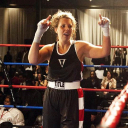

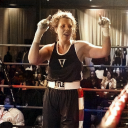

Validation Epoch : [100 / 125]	Loss-41.9219


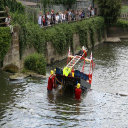

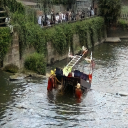

[Training] epoch 59 
Train Epoch : [59] [0 / 1125]	Loss-41.7912
Train Epoch : [59] [100 / 1125]	Loss-40.4713
Train Epoch : [59] [200 / 1125]	Loss-40.5718
Train Epoch : [59] [300 / 1125]	Loss-41.2181
Train Epoch : [59] [400 / 1125]	Loss-40.6529
Train Epoch : [59] [500 / 1125]	Loss-42.8221
Train Epoch : [59] [600 / 1125]	Loss-44.2424
Train Epoch : [59] [700 / 1125]	Loss-42.5984
Train Epoch : [59] [800 / 1125]	Loss-41.4213
Train Epoch : [59] [900 / 1125]	Loss-39.3411
Train Epoch : [59] [1000 / 1125]	Loss-40.0851
Train Epoch : [59] [1100 / 1125]	Loss-41.9624
Validation Epoch : [0 / 125]	Loss-44.2286


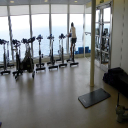

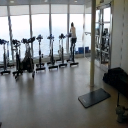

Validation Epoch : [100 / 125]	Loss-37.7936


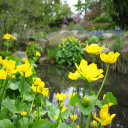

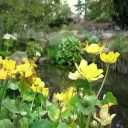

[Training] epoch 60 
Train Epoch : [60] [0 / 1125]	Loss-45.9782
Train Epoch : [60] [100 / 1125]	Loss-39.5457
Train Epoch : [60] [200 / 1125]	Loss-43.1063
Train Epoch : [60] [300 / 1125]	Loss-44.3453
Train Epoch : [60] [400 / 1125]	Loss-44.2229
Train Epoch : [60] [500 / 1125]	Loss-42.0144
Train Epoch : [60] [600 / 1125]	Loss-41.7058
Train Epoch : [60] [700 / 1125]	Loss-45.4528
Train Epoch : [60] [800 / 1125]	Loss-42.7116
Train Epoch : [60] [900 / 1125]	Loss-45.4647
Train Epoch : [60] [1000 / 1125]	Loss-38.4266
Train Epoch : [60] [1100 / 1125]	Loss-39.6036
Validation Epoch : [0 / 125]	Loss-38.8133


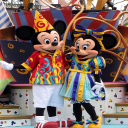

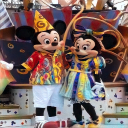

Validation Epoch : [100 / 125]	Loss-40.6981


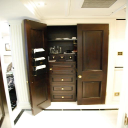

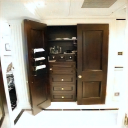

[Training] epoch 61 
Train Epoch : [61] [0 / 1125]	Loss-40.7895
Train Epoch : [61] [100 / 1125]	Loss-41.8915
Train Epoch : [61] [200 / 1125]	Loss-40.9740
Train Epoch : [61] [300 / 1125]	Loss-41.0632
Train Epoch : [61] [400 / 1125]	Loss-40.0819
Train Epoch : [61] [500 / 1125]	Loss-41.8188
Train Epoch : [61] [600 / 1125]	Loss-40.3609
Train Epoch : [61] [700 / 1125]	Loss-41.3465
Train Epoch : [61] [800 / 1125]	Loss-40.6271
Train Epoch : [61] [900 / 1125]	Loss-39.4049
Train Epoch : [61] [1000 / 1125]	Loss-40.9160
Train Epoch : [61] [1100 / 1125]	Loss-41.4877
Validation Epoch : [0 / 125]	Loss-40.6531


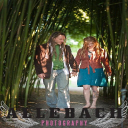

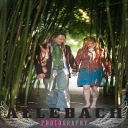

Validation Epoch : [100 / 125]	Loss-39.5204


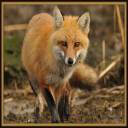

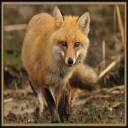

[Training] epoch 62 
Train Epoch : [62] [0 / 1125]	Loss-38.5742
Train Epoch : [62] [100 / 1125]	Loss-42.6207
Train Epoch : [62] [200 / 1125]	Loss-41.3227
Train Epoch : [62] [300 / 1125]	Loss-38.7009
Train Epoch : [62] [400 / 1125]	Loss-40.7110
Train Epoch : [62] [500 / 1125]	Loss-39.4428
Train Epoch : [62] [600 / 1125]	Loss-41.1765
Train Epoch : [62] [700 / 1125]	Loss-41.2676
Train Epoch : [62] [800 / 1125]	Loss-41.7661
Train Epoch : [62] [900 / 1125]	Loss-39.0062
Train Epoch : [62] [1000 / 1125]	Loss-45.6104
Train Epoch : [62] [1100 / 1125]	Loss-39.6186
Validation Epoch : [0 / 125]	Loss-41.9432


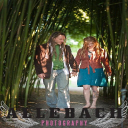

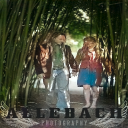

Validation Epoch : [100 / 125]	Loss-40.9711


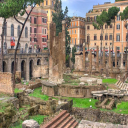

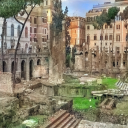

[Training] epoch 63 
Train Epoch : [63] [0 / 1125]	Loss-42.6512
Train Epoch : [63] [100 / 1125]	Loss-41.8768
Train Epoch : [63] [200 / 1125]	Loss-41.1486
Train Epoch : [63] [300 / 1125]	Loss-41.5050
Train Epoch : [63] [400 / 1125]	Loss-39.2035
Train Epoch : [63] [500 / 1125]	Loss-41.1810
Train Epoch : [63] [600 / 1125]	Loss-37.5533
Train Epoch : [63] [700 / 1125]	Loss-41.2935
Train Epoch : [63] [800 / 1125]	Loss-41.8574
Train Epoch : [63] [900 / 1125]	Loss-41.5409
Train Epoch : [63] [1000 / 1125]	Loss-41.5394
Train Epoch : [63] [1100 / 1125]	Loss-43.4997
Validation Epoch : [0 / 125]	Loss-40.3169


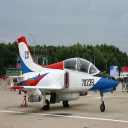

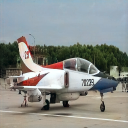

Validation Epoch : [100 / 125]	Loss-37.6607


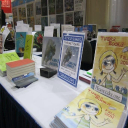

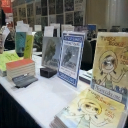

[Training] epoch 64 
Train Epoch : [64] [0 / 1125]	Loss-37.7571
Train Epoch : [64] [100 / 1125]	Loss-37.8575
Train Epoch : [64] [200 / 1125]	Loss-45.6763
Train Epoch : [64] [300 / 1125]	Loss-42.1009
Train Epoch : [64] [400 / 1125]	Loss-41.2582
Train Epoch : [64] [500 / 1125]	Loss-37.2719
Train Epoch : [64] [600 / 1125]	Loss-40.5732
Train Epoch : [64] [700 / 1125]	Loss-39.0888
Train Epoch : [64] [800 / 1125]	Loss-41.4405
Train Epoch : [64] [900 / 1125]	Loss-42.1480
Train Epoch : [64] [1000 / 1125]	Loss-43.8122
Train Epoch : [64] [1100 / 1125]	Loss-42.8603
Validation Epoch : [0 / 125]	Loss-43.8362


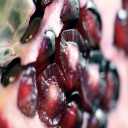

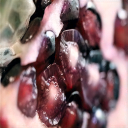

Validation Epoch : [100 / 125]	Loss-41.4846


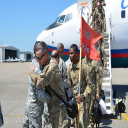

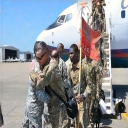

[Training] epoch 65 
Train Epoch : [65] [0 / 1125]	Loss-39.7168
Train Epoch : [65] [100 / 1125]	Loss-40.9562
Train Epoch : [65] [200 / 1125]	Loss-41.9738
Train Epoch : [65] [300 / 1125]	Loss-37.9051
Train Epoch : [65] [400 / 1125]	Loss-36.5620
Train Epoch : [65] [500 / 1125]	Loss-40.4277
Train Epoch : [65] [600 / 1125]	Loss-43.3005
Train Epoch : [65] [700 / 1125]	Loss-43.7204
Train Epoch : [65] [800 / 1125]	Loss-41.1273
Train Epoch : [65] [900 / 1125]	Loss-44.4602
Train Epoch : [65] [1000 / 1125]	Loss-38.8186
Train Epoch : [65] [1100 / 1125]	Loss-42.9557
Validation Epoch : [0 / 125]	Loss-42.5280


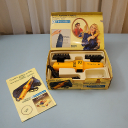

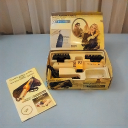

Validation Epoch : [100 / 125]	Loss-41.7020


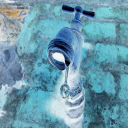

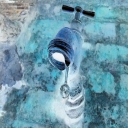

[Training] epoch 66 
Train Epoch : [66] [0 / 1125]	Loss-43.5749
Train Epoch : [66] [100 / 1125]	Loss-43.1490
Train Epoch : [66] [200 / 1125]	Loss-39.8181
Train Epoch : [66] [300 / 1125]	Loss-39.5232
Train Epoch : [66] [400 / 1125]	Loss-39.6223
Train Epoch : [66] [500 / 1125]	Loss-39.6672
Train Epoch : [66] [600 / 1125]	Loss-39.1308
Train Epoch : [66] [700 / 1125]	Loss-43.4868
Train Epoch : [66] [800 / 1125]	Loss-41.2148
Train Epoch : [66] [900 / 1125]	Loss-38.6273
Train Epoch : [66] [1000 / 1125]	Loss-42.4246
Train Epoch : [66] [1100 / 1125]	Loss-39.2887
Validation Epoch : [0 / 125]	Loss-43.3387


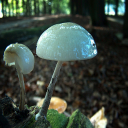

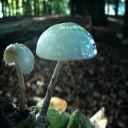

Validation Epoch : [100 / 125]	Loss-42.9826


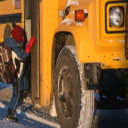

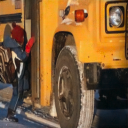

[Training] epoch 67 
Train Epoch : [67] [0 / 1125]	Loss-40.5779
Train Epoch : [67] [100 / 1125]	Loss-43.2737
Train Epoch : [67] [200 / 1125]	Loss-46.7159
Train Epoch : [67] [300 / 1125]	Loss-38.6436
Train Epoch : [67] [400 / 1125]	Loss-43.9217
Train Epoch : [67] [500 / 1125]	Loss-41.2531
Train Epoch : [67] [600 / 1125]	Loss-45.7778
Train Epoch : [67] [700 / 1125]	Loss-40.5142
Train Epoch : [67] [800 / 1125]	Loss-40.7650
Train Epoch : [67] [900 / 1125]	Loss-45.7034
Train Epoch : [67] [1000 / 1125]	Loss-44.1174
Train Epoch : [67] [1100 / 1125]	Loss-42.6681
Validation Epoch : [0 / 125]	Loss-40.6897


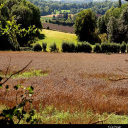

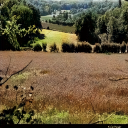

Validation Epoch : [100 / 125]	Loss-41.0654


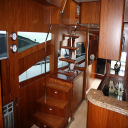

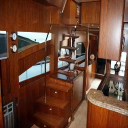

[Training] epoch 68 
Train Epoch : [68] [0 / 1125]	Loss-40.6109
Train Epoch : [68] [100 / 1125]	Loss-42.4837
Train Epoch : [68] [200 / 1125]	Loss-39.6347
Train Epoch : [68] [300 / 1125]	Loss-39.6781
Train Epoch : [68] [400 / 1125]	Loss-41.3810
Train Epoch : [68] [500 / 1125]	Loss-40.6282
Train Epoch : [68] [600 / 1125]	Loss-43.5382
Train Epoch : [68] [700 / 1125]	Loss-39.6572
Train Epoch : [68] [800 / 1125]	Loss-41.1034
Train Epoch : [68] [900 / 1125]	Loss-41.3733
Train Epoch : [68] [1000 / 1125]	Loss-43.7535
Train Epoch : [68] [1100 / 1125]	Loss-41.6244
Validation Epoch : [0 / 125]	Loss-39.3307


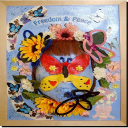

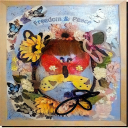

Validation Epoch : [100 / 125]	Loss-41.1123


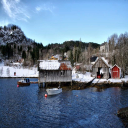

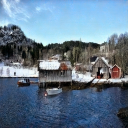

[Training] epoch 69 
Train Epoch : [69] [0 / 1125]	Loss-41.2344
Train Epoch : [69] [100 / 1125]	Loss-41.2452
Train Epoch : [69] [200 / 1125]	Loss-42.5727
Train Epoch : [69] [300 / 1125]	Loss-39.6426
Train Epoch : [69] [400 / 1125]	Loss-44.6628
Train Epoch : [69] [500 / 1125]	Loss-43.6607
Train Epoch : [69] [600 / 1125]	Loss-40.9267
Train Epoch : [69] [700 / 1125]	Loss-40.6979
Train Epoch : [69] [800 / 1125]	Loss-44.4163
Train Epoch : [69] [900 / 1125]	Loss-42.8115
Train Epoch : [69] [1000 / 1125]	Loss-41.4542
Train Epoch : [69] [1100 / 1125]	Loss-42.8016
Validation Epoch : [0 / 125]	Loss-42.5769


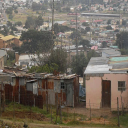

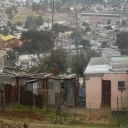

Validation Epoch : [100 / 125]	Loss-41.4131


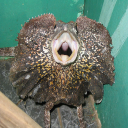

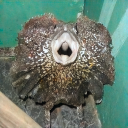

[Training] epoch 70 
Train Epoch : [70] [0 / 1125]	Loss-41.9949
Train Epoch : [70] [100 / 1125]	Loss-39.3439
Train Epoch : [70] [200 / 1125]	Loss-45.3239
Train Epoch : [70] [300 / 1125]	Loss-42.9357
Train Epoch : [70] [400 / 1125]	Loss-39.3191
Train Epoch : [70] [500 / 1125]	Loss-42.4321
Train Epoch : [70] [600 / 1125]	Loss-38.2947
Train Epoch : [70] [700 / 1125]	Loss-44.2244
Train Epoch : [70] [800 / 1125]	Loss-42.2710
Train Epoch : [70] [900 / 1125]	Loss-41.1995
Train Epoch : [70] [1000 / 1125]	Loss-41.4411
Train Epoch : [70] [1100 / 1125]	Loss-38.2561
Validation Epoch : [0 / 125]	Loss-39.6328


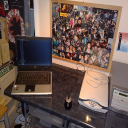

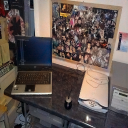

Validation Epoch : [100 / 125]	Loss-40.4084


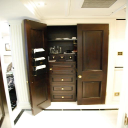

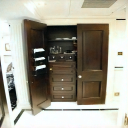

[Training] epoch 71 
Train Epoch : [71] [0 / 1125]	Loss-40.1606
Train Epoch : [71] [100 / 1125]	Loss-43.3468
Train Epoch : [71] [200 / 1125]	Loss-41.3098
Train Epoch : [71] [300 / 1125]	Loss-43.2830
Train Epoch : [71] [400 / 1125]	Loss-43.0882
Train Epoch : [71] [500 / 1125]	Loss-47.0420
Train Epoch : [71] [600 / 1125]	Loss-41.6849
Train Epoch : [71] [700 / 1125]	Loss-41.6345
Train Epoch : [71] [800 / 1125]	Loss-41.5824
Train Epoch : [71] [900 / 1125]	Loss-43.6803
Train Epoch : [71] [1000 / 1125]	Loss-44.2363
Train Epoch : [71] [1100 / 1125]	Loss-40.6855
Validation Epoch : [0 / 125]	Loss-41.6293


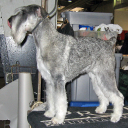

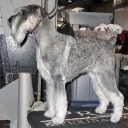

Validation Epoch : [100 / 125]	Loss-41.2823


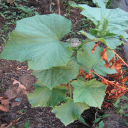

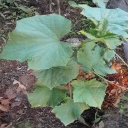

[Training] epoch 72 
Train Epoch : [72] [0 / 1125]	Loss-38.9426
Train Epoch : [72] [100 / 1125]	Loss-39.9112
Train Epoch : [72] [200 / 1125]	Loss-41.5484
Train Epoch : [72] [300 / 1125]	Loss-42.5533
Train Epoch : [72] [400 / 1125]	Loss-41.6878
Train Epoch : [72] [500 / 1125]	Loss-39.8021
Train Epoch : [72] [600 / 1125]	Loss-38.2545
Train Epoch : [72] [700 / 1125]	Loss-42.4789
Train Epoch : [72] [800 / 1125]	Loss-37.8708
Train Epoch : [72] [900 / 1125]	Loss-44.2020
Train Epoch : [72] [1000 / 1125]	Loss-39.6145
Train Epoch : [72] [1100 / 1125]	Loss-37.8947
Validation Epoch : [0 / 125]	Loss-39.1321


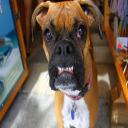

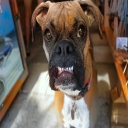

Validation Epoch : [100 / 125]	Loss-39.8548


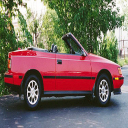

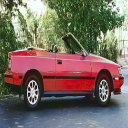

[Training] epoch 73 
Train Epoch : [73] [0 / 1125]	Loss-41.5997
Train Epoch : [73] [100 / 1125]	Loss-44.2475
Train Epoch : [73] [200 / 1125]	Loss-42.5960
Train Epoch : [73] [300 / 1125]	Loss-40.7593
Train Epoch : [73] [400 / 1125]	Loss-40.5471
Train Epoch : [73] [500 / 1125]	Loss-42.6887
Train Epoch : [73] [600 / 1125]	Loss-34.7962
Train Epoch : [73] [700 / 1125]	Loss-39.9130
Train Epoch : [73] [800 / 1125]	Loss-45.9291
Train Epoch : [73] [900 / 1125]	Loss-42.7529
Train Epoch : [73] [1000 / 1125]	Loss-42.9642
Train Epoch : [73] [1100 / 1125]	Loss-39.3637
Validation Epoch : [0 / 125]	Loss-38.9238


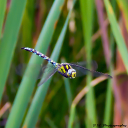

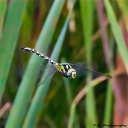

Validation Epoch : [100 / 125]	Loss-40.8479


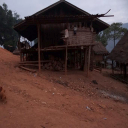

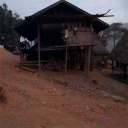

[Training] epoch 74 
Train Epoch : [74] [0 / 1125]	Loss-41.0740
Train Epoch : [74] [100 / 1125]	Loss-38.6963
Train Epoch : [74] [200 / 1125]	Loss-40.8619
Train Epoch : [74] [300 / 1125]	Loss-45.1283
Train Epoch : [74] [400 / 1125]	Loss-44.9762
Train Epoch : [74] [500 / 1125]	Loss-46.8176
Train Epoch : [74] [600 / 1125]	Loss-40.1718
Train Epoch : [74] [700 / 1125]	Loss-40.8601
Train Epoch : [74] [800 / 1125]	Loss-44.0467
Train Epoch : [74] [900 / 1125]	Loss-39.4542
Train Epoch : [74] [1000 / 1125]	Loss-41.6581
Train Epoch : [74] [1100 / 1125]	Loss-44.3719
Validation Epoch : [0 / 125]	Loss-40.7199


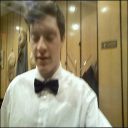

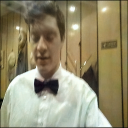

Validation Epoch : [100 / 125]	Loss-43.2071


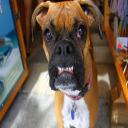

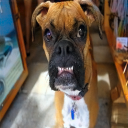

[Training] epoch 75 
Train Epoch : [75] [0 / 1125]	Loss-39.2878
Train Epoch : [75] [100 / 1125]	Loss-39.5763
Train Epoch : [75] [200 / 1125]	Loss-40.3588
Train Epoch : [75] [300 / 1125]	Loss-42.9162
Train Epoch : [75] [400 / 1125]	Loss-42.3964
Train Epoch : [75] [500 / 1125]	Loss-46.1416
Train Epoch : [75] [600 / 1125]	Loss-39.8253
Train Epoch : [75] [700 / 1125]	Loss-42.3229
Train Epoch : [75] [800 / 1125]	Loss-43.8477
Train Epoch : [75] [900 / 1125]	Loss-37.2357
Train Epoch : [75] [1000 / 1125]	Loss-42.7103
Train Epoch : [75] [1100 / 1125]	Loss-43.1042
Validation Epoch : [0 / 125]	Loss-39.7397


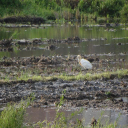

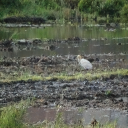

Validation Epoch : [100 / 125]	Loss-40.3960


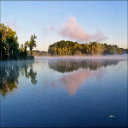

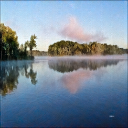

[Training] epoch 76 
Train Epoch : [76] [0 / 1125]	Loss-39.5344
Train Epoch : [76] [100 / 1125]	Loss-42.1553
Train Epoch : [76] [200 / 1125]	Loss-40.9065
Train Epoch : [76] [300 / 1125]	Loss-41.0774
Train Epoch : [76] [400 / 1125]	Loss-41.5504
Train Epoch : [76] [500 / 1125]	Loss-43.2688
Train Epoch : [76] [600 / 1125]	Loss-40.6221
Train Epoch : [76] [700 / 1125]	Loss-40.2493
Train Epoch : [76] [800 / 1125]	Loss-44.8117
Train Epoch : [76] [900 / 1125]	Loss-40.7372
Train Epoch : [76] [1000 / 1125]	Loss-42.7285
Train Epoch : [76] [1100 / 1125]	Loss-43.2850
Validation Epoch : [0 / 125]	Loss-42.3260


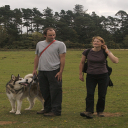

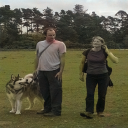

Validation Epoch : [100 / 125]	Loss-44.2617


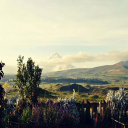

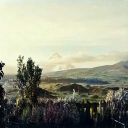

[Training] epoch 77 
Train Epoch : [77] [0 / 1125]	Loss-40.9615
Train Epoch : [77] [100 / 1125]	Loss-42.1891
Train Epoch : [77] [200 / 1125]	Loss-37.4049
Train Epoch : [77] [300 / 1125]	Loss-41.3211
Train Epoch : [77] [400 / 1125]	Loss-40.7956
Train Epoch : [77] [500 / 1125]	Loss-39.3584
Train Epoch : [77] [600 / 1125]	Loss-40.4357
Train Epoch : [77] [700 / 1125]	Loss-36.9600
Train Epoch : [77] [800 / 1125]	Loss-42.9567
Train Epoch : [77] [900 / 1125]	Loss-41.1674
Train Epoch : [77] [1000 / 1125]	Loss-42.9261
Train Epoch : [77] [1100 / 1125]	Loss-39.8460
Validation Epoch : [0 / 125]	Loss-42.9658


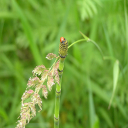

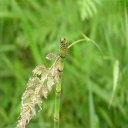

Validation Epoch : [100 / 125]	Loss-41.2068


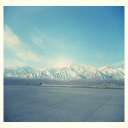

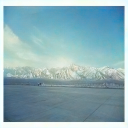

[Training] epoch 78 
Train Epoch : [78] [0 / 1125]	Loss-40.5719
Train Epoch : [78] [100 / 1125]	Loss-40.0788
Train Epoch : [78] [200 / 1125]	Loss-43.3303
Train Epoch : [78] [300 / 1125]	Loss-44.5131
Train Epoch : [78] [400 / 1125]	Loss-36.6526
Train Epoch : [78] [500 / 1125]	Loss-42.3895
Train Epoch : [78] [600 / 1125]	Loss-41.2384
Train Epoch : [78] [700 / 1125]	Loss-40.4736
Train Epoch : [78] [800 / 1125]	Loss-41.0893
Train Epoch : [78] [900 / 1125]	Loss-41.6097
Train Epoch : [78] [1000 / 1125]	Loss-45.1500
Train Epoch : [78] [1100 / 1125]	Loss-42.7564
Validation Epoch : [0 / 125]	Loss-44.5031


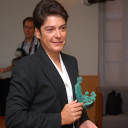

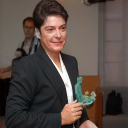

Validation Epoch : [100 / 125]	Loss-43.2648


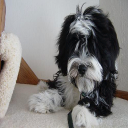

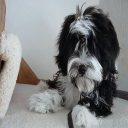

[Training] epoch 79 
Train Epoch : [79] [0 / 1125]	Loss-39.7005
Train Epoch : [79] [100 / 1125]	Loss-43.0746
Train Epoch : [79] [200 / 1125]	Loss-39.2529
Train Epoch : [79] [300 / 1125]	Loss-43.4732
Train Epoch : [79] [400 / 1125]	Loss-39.9923
Train Epoch : [79] [500 / 1125]	Loss-40.0103
Train Epoch : [79] [600 / 1125]	Loss-45.8403
Train Epoch : [79] [700 / 1125]	Loss-40.4570
Train Epoch : [79] [800 / 1125]	Loss-41.5369
Train Epoch : [79] [900 / 1125]	Loss-39.3731
Train Epoch : [79] [1000 / 1125]	Loss-42.7527
Train Epoch : [79] [1100 / 1125]	Loss-40.6758
Validation Epoch : [0 / 125]	Loss-41.2372


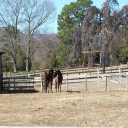

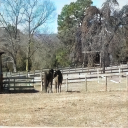

Validation Epoch : [100 / 125]	Loss-41.4750


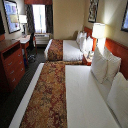

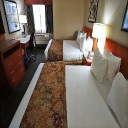

[Training] epoch 80 
Train Epoch : [80] [0 / 1125]	Loss-42.7477
Train Epoch : [80] [100 / 1125]	Loss-38.4896
Train Epoch : [80] [200 / 1125]	Loss-44.1821
Train Epoch : [80] [300 / 1125]	Loss-43.8259
Train Epoch : [80] [400 / 1125]	Loss-42.2936
Train Epoch : [80] [500 / 1125]	Loss-42.3359
Train Epoch : [80] [600 / 1125]	Loss-46.7765
Train Epoch : [80] [700 / 1125]	Loss-41.9490
Train Epoch : [80] [800 / 1125]	Loss-41.5182
Train Epoch : [80] [900 / 1125]	Loss-40.6659
Train Epoch : [80] [1000 / 1125]	Loss-40.1460
Train Epoch : [80] [1100 / 1125]	Loss-39.3759
Validation Epoch : [0 / 125]	Loss-36.6029


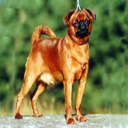

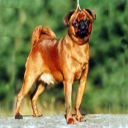

Validation Epoch : [100 / 125]	Loss-39.2092


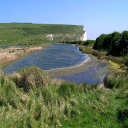

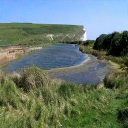

[Training] epoch 81 
Train Epoch : [81] [0 / 1125]	Loss-41.4841
Train Epoch : [81] [100 / 1125]	Loss-41.7450
Train Epoch : [81] [200 / 1125]	Loss-39.5590
Train Epoch : [81] [300 / 1125]	Loss-41.6443
Train Epoch : [81] [400 / 1125]	Loss-37.9385
Train Epoch : [81] [500 / 1125]	Loss-41.2018
Train Epoch : [81] [600 / 1125]	Loss-44.2514
Train Epoch : [81] [700 / 1125]	Loss-43.7647
Train Epoch : [81] [800 / 1125]	Loss-45.9695
Train Epoch : [81] [900 / 1125]	Loss-42.6648
Train Epoch : [81] [1000 / 1125]	Loss-40.9805
Train Epoch : [81] [1100 / 1125]	Loss-41.2647
Validation Epoch : [0 / 125]	Loss-40.8076


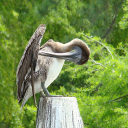

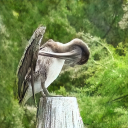

Validation Epoch : [100 / 125]	Loss-42.1102


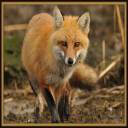

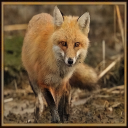

[Training] epoch 82 
Train Epoch : [82] [0 / 1125]	Loss-39.6007
Train Epoch : [82] [100 / 1125]	Loss-41.8714
Train Epoch : [82] [200 / 1125]	Loss-42.1530
Train Epoch : [82] [300 / 1125]	Loss-41.0238
Train Epoch : [82] [400 / 1125]	Loss-47.9247
Train Epoch : [82] [500 / 1125]	Loss-44.1060
Train Epoch : [82] [600 / 1125]	Loss-43.3229
Train Epoch : [82] [700 / 1125]	Loss-43.9526
Train Epoch : [82] [800 / 1125]	Loss-45.1678
Train Epoch : [82] [900 / 1125]	Loss-40.4424
Train Epoch : [82] [1000 / 1125]	Loss-39.8026
Train Epoch : [82] [1100 / 1125]	Loss-42.3333
Validation Epoch : [0 / 125]	Loss-40.5893


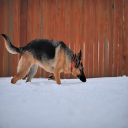

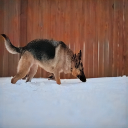

Validation Epoch : [100 / 125]	Loss-39.2384


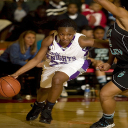

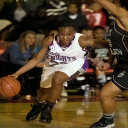

[Training] epoch 83 
Train Epoch : [83] [0 / 1125]	Loss-39.5110
Train Epoch : [83] [100 / 1125]	Loss-44.3092
Train Epoch : [83] [200 / 1125]	Loss-44.9076
Train Epoch : [83] [300 / 1125]	Loss-42.4843
Train Epoch : [83] [400 / 1125]	Loss-43.5778
Train Epoch : [83] [500 / 1125]	Loss-40.1146
Train Epoch : [83] [600 / 1125]	Loss-40.6659
Train Epoch : [83] [700 / 1125]	Loss-42.2755
Train Epoch : [83] [800 / 1125]	Loss-40.6882
Train Epoch : [83] [900 / 1125]	Loss-40.1298
Train Epoch : [83] [1000 / 1125]	Loss-46.3778
Train Epoch : [83] [1100 / 1125]	Loss-40.5102
Validation Epoch : [0 / 125]	Loss-44.0050


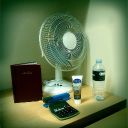

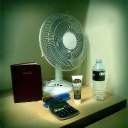

Validation Epoch : [100 / 125]	Loss-44.7735


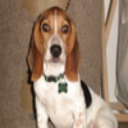

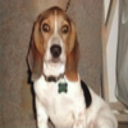

[Training] epoch 84 
Train Epoch : [84] [0 / 1125]	Loss-40.5057
Train Epoch : [84] [100 / 1125]	Loss-36.8350
Train Epoch : [84] [200 / 1125]	Loss-42.6563
Train Epoch : [84] [300 / 1125]	Loss-42.1731
Train Epoch : [84] [400 / 1125]	Loss-44.1092
Train Epoch : [84] [500 / 1125]	Loss-42.4385
Train Epoch : [84] [600 / 1125]	Loss-42.3454
Train Epoch : [84] [700 / 1125]	Loss-41.8885
Train Epoch : [84] [800 / 1125]	Loss-38.4073
Train Epoch : [84] [900 / 1125]	Loss-41.6639
Train Epoch : [84] [1000 / 1125]	Loss-43.7467
Train Epoch : [84] [1100 / 1125]	Loss-46.1617
Validation Epoch : [0 / 125]	Loss-43.4831


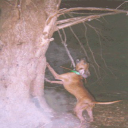

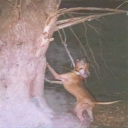

Validation Epoch : [100 / 125]	Loss-42.2153


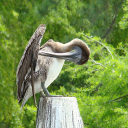

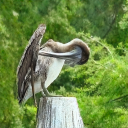

[Training] epoch 85 
Train Epoch : [85] [0 / 1125]	Loss-40.9761
Train Epoch : [85] [100 / 1125]	Loss-43.3039
Train Epoch : [85] [200 / 1125]	Loss-43.0496
Train Epoch : [85] [300 / 1125]	Loss-43.7939
Train Epoch : [85] [400 / 1125]	Loss-40.8913
Train Epoch : [85] [500 / 1125]	Loss-42.8303
Train Epoch : [85] [600 / 1125]	Loss-43.9322
Train Epoch : [85] [700 / 1125]	Loss-41.4651
Train Epoch : [85] [800 / 1125]	Loss-42.8984
Train Epoch : [85] [900 / 1125]	Loss-41.7536
Train Epoch : [85] [1000 / 1125]	Loss-43.4928
Train Epoch : [85] [1100 / 1125]	Loss-40.0234
Validation Epoch : [0 / 125]	Loss-42.4760


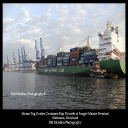

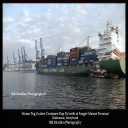

Validation Epoch : [100 / 125]	Loss-44.6225


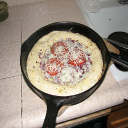

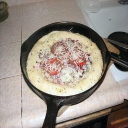

[Training] epoch 86 
Train Epoch : [86] [0 / 1125]	Loss-40.8551
Train Epoch : [86] [100 / 1125]	Loss-40.4095
Train Epoch : [86] [200 / 1125]	Loss-43.6086
Train Epoch : [86] [300 / 1125]	Loss-41.9816
Train Epoch : [86] [400 / 1125]	Loss-40.1959
Train Epoch : [86] [500 / 1125]	Loss-41.9238
Train Epoch : [86] [600 / 1125]	Loss-40.8195
Train Epoch : [86] [700 / 1125]	Loss-43.8498
Train Epoch : [86] [800 / 1125]	Loss-41.7036
Train Epoch : [86] [900 / 1125]	Loss-40.8521
Train Epoch : [86] [1000 / 1125]	Loss-39.0759
Train Epoch : [86] [1100 / 1125]	Loss-45.7499
Validation Epoch : [0 / 125]	Loss-41.9560


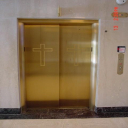

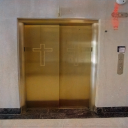

Validation Epoch : [100 / 125]	Loss-39.8804


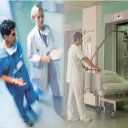

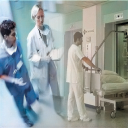

[Training] epoch 87 
Train Epoch : [87] [0 / 1125]	Loss-39.2678
Train Epoch : [87] [100 / 1125]	Loss-39.0580
Train Epoch : [87] [200 / 1125]	Loss-41.9065
Train Epoch : [87] [300 / 1125]	Loss-43.7323
Train Epoch : [87] [400 / 1125]	Loss-37.1916
Train Epoch : [87] [500 / 1125]	Loss-42.6631
Train Epoch : [87] [600 / 1125]	Loss-43.3015
Train Epoch : [87] [700 / 1125]	Loss-43.5636
Train Epoch : [87] [800 / 1125]	Loss-42.0341
Train Epoch : [87] [900 / 1125]	Loss-41.3670
Train Epoch : [87] [1000 / 1125]	Loss-42.0968
Train Epoch : [87] [1100 / 1125]	Loss-43.2994
Validation Epoch : [0 / 125]	Loss-42.6412


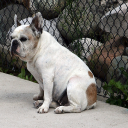

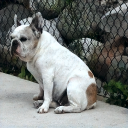

Validation Epoch : [100 / 125]	Loss-43.1062


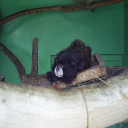

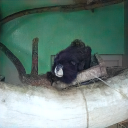

[Training] epoch 88 
Train Epoch : [88] [0 / 1125]	Loss-43.6756
Train Epoch : [88] [100 / 1125]	Loss-43.4734
Train Epoch : [88] [200 / 1125]	Loss-41.9173
Train Epoch : [88] [300 / 1125]	Loss-42.8861
Train Epoch : [88] [400 / 1125]	Loss-40.1862
Train Epoch : [88] [500 / 1125]	Loss-43.9038
Train Epoch : [88] [600 / 1125]	Loss-39.0619
Train Epoch : [88] [700 / 1125]	Loss-43.5792
Train Epoch : [88] [800 / 1125]	Loss-41.5667
Train Epoch : [88] [900 / 1125]	Loss-41.8377
Train Epoch : [88] [1000 / 1125]	Loss-40.6185
Train Epoch : [88] [1100 / 1125]	Loss-45.3832
Validation Epoch : [0 / 125]	Loss-41.8243


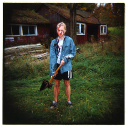

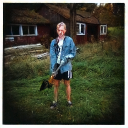

Validation Epoch : [100 / 125]	Loss-43.6111


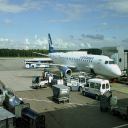

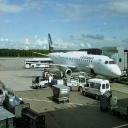

[Training] epoch 89 
Train Epoch : [89] [0 / 1125]	Loss-44.3598
Train Epoch : [89] [100 / 1125]	Loss-40.8961
Train Epoch : [89] [200 / 1125]	Loss-39.5775
Train Epoch : [89] [300 / 1125]	Loss-39.8350
Train Epoch : [89] [400 / 1125]	Loss-42.6157
Train Epoch : [89] [500 / 1125]	Loss-42.7870
Train Epoch : [89] [600 / 1125]	Loss-41.6983
Train Epoch : [89] [700 / 1125]	Loss-43.7121
Train Epoch : [89] [800 / 1125]	Loss-42.8084
Train Epoch : [89] [900 / 1125]	Loss-48.2310
Train Epoch : [89] [1000 / 1125]	Loss-45.1972
Train Epoch : [89] [1100 / 1125]	Loss-41.0281
Validation Epoch : [0 / 125]	Loss-42.0183


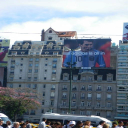

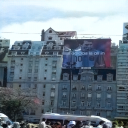

Validation Epoch : [100 / 125]	Loss-43.8903


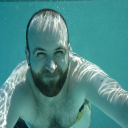

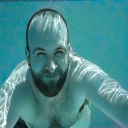

[Training] epoch 90 
Train Epoch : [90] [0 / 1125]	Loss-41.7839
Train Epoch : [90] [100 / 1125]	Loss-41.9593
Train Epoch : [90] [200 / 1125]	Loss-39.4205
Train Epoch : [90] [300 / 1125]	Loss-43.3725
Train Epoch : [90] [400 / 1125]	Loss-40.7595
Train Epoch : [90] [500 / 1125]	Loss-41.0326
Train Epoch : [90] [600 / 1125]	Loss-45.6150
Train Epoch : [90] [700 / 1125]	Loss-40.0125
Train Epoch : [90] [800 / 1125]	Loss-44.7265
Train Epoch : [90] [900 / 1125]	Loss-38.8444
Train Epoch : [90] [1000 / 1125]	Loss-40.1545
Train Epoch : [90] [1100 / 1125]	Loss-43.0959
Validation Epoch : [0 / 125]	Loss-42.7204


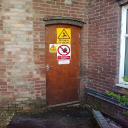

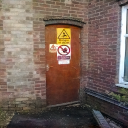

Validation Epoch : [100 / 125]	Loss-44.1573


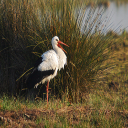

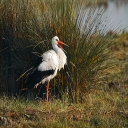

[Training] epoch 91 
Train Epoch : [91] [0 / 1125]	Loss-41.7179
Train Epoch : [91] [100 / 1125]	Loss-41.6010
Train Epoch : [91] [200 / 1125]	Loss-45.8899
Train Epoch : [91] [300 / 1125]	Loss-42.4162
Train Epoch : [91] [400 / 1125]	Loss-39.3378
Train Epoch : [91] [500 / 1125]	Loss-41.1929
Train Epoch : [91] [600 / 1125]	Loss-44.8568
Train Epoch : [91] [700 / 1125]	Loss-41.0947
Train Epoch : [91] [800 / 1125]	Loss-40.8324
Train Epoch : [91] [900 / 1125]	Loss-46.8201
Train Epoch : [91] [1000 / 1125]	Loss-41.2273
Train Epoch : [91] [1100 / 1125]	Loss-43.9943
Validation Epoch : [0 / 125]	Loss-38.4135


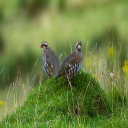

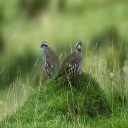

Validation Epoch : [100 / 125]	Loss-40.7792


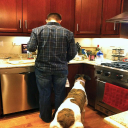

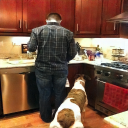

[Training] epoch 92 
Train Epoch : [92] [0 / 1125]	Loss-39.9389
Train Epoch : [92] [100 / 1125]	Loss-39.5020
Train Epoch : [92] [200 / 1125]	Loss-41.9014
Train Epoch : [92] [300 / 1125]	Loss-46.1307
Train Epoch : [92] [400 / 1125]	Loss-46.2066
Train Epoch : [92] [500 / 1125]	Loss-42.3566
Train Epoch : [92] [600 / 1125]	Loss-41.3464
Train Epoch : [92] [700 / 1125]	Loss-43.3367
Train Epoch : [92] [800 / 1125]	Loss-42.2034
Train Epoch : [92] [900 / 1125]	Loss-39.9450
Train Epoch : [92] [1000 / 1125]	Loss-42.3030
Train Epoch : [92] [1100 / 1125]	Loss-44.2303
Validation Epoch : [0 / 125]	Loss-43.2124


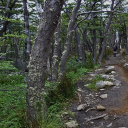

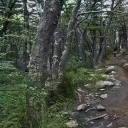

Validation Epoch : [100 / 125]	Loss-44.1800


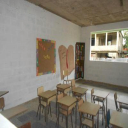

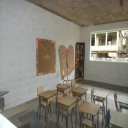

[Training] epoch 93 
Train Epoch : [93] [0 / 1125]	Loss-41.4325
Train Epoch : [93] [100 / 1125]	Loss-39.5079
Train Epoch : [93] [200 / 1125]	Loss-39.0909
Train Epoch : [93] [300 / 1125]	Loss-40.5047
Train Epoch : [93] [400 / 1125]	Loss-43.6317
Train Epoch : [93] [500 / 1125]	Loss-43.1519
Train Epoch : [93] [600 / 1125]	Loss-43.0781
Train Epoch : [93] [700 / 1125]	Loss-40.1640
Train Epoch : [93] [800 / 1125]	Loss-42.1277
Train Epoch : [93] [900 / 1125]	Loss-43.3415
Train Epoch : [93] [1000 / 1125]	Loss-39.3484
Train Epoch : [93] [1100 / 1125]	Loss-43.6479
Validation Epoch : [0 / 125]	Loss-40.4068


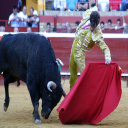

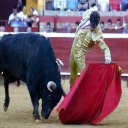

Validation Epoch : [100 / 125]	Loss-43.6283


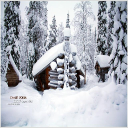

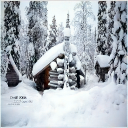

[Training] epoch 94 
Train Epoch : [94] [0 / 1125]	Loss-41.8031
Train Epoch : [94] [100 / 1125]	Loss-42.1897
Train Epoch : [94] [200 / 1125]	Loss-40.8272
Train Epoch : [94] [300 / 1125]	Loss-40.2923
Train Epoch : [94] [400 / 1125]	Loss-41.5982
Train Epoch : [94] [500 / 1125]	Loss-41.8179
Train Epoch : [94] [600 / 1125]	Loss-44.5896
Train Epoch : [94] [700 / 1125]	Loss-41.4664
Train Epoch : [94] [800 / 1125]	Loss-41.7131
Train Epoch : [94] [900 / 1125]	Loss-41.6582
Train Epoch : [94] [1000 / 1125]	Loss-41.9666
Train Epoch : [94] [1100 / 1125]	Loss-42.7119
Validation Epoch : [0 / 125]	Loss-39.7312


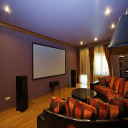

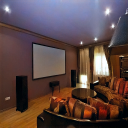

Validation Epoch : [100 / 125]	Loss-39.2106


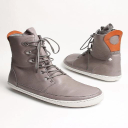

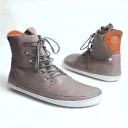

[Training] epoch 95 
Train Epoch : [95] [0 / 1125]	Loss-42.6370
Train Epoch : [95] [100 / 1125]	Loss-43.5595
Train Epoch : [95] [200 / 1125]	Loss-43.0152
Train Epoch : [95] [300 / 1125]	Loss-39.6761
Train Epoch : [95] [400 / 1125]	Loss-37.4293
Train Epoch : [95] [500 / 1125]	Loss-43.9442
Train Epoch : [95] [600 / 1125]	Loss-43.7518
Train Epoch : [95] [700 / 1125]	Loss-39.8982
Train Epoch : [95] [800 / 1125]	Loss-42.9444
Train Epoch : [95] [900 / 1125]	Loss-44.2736
Train Epoch : [95] [1000 / 1125]	Loss-41.3779
Train Epoch : [95] [1100 / 1125]	Loss-41.1401
Validation Epoch : [0 / 125]	Loss-43.6071


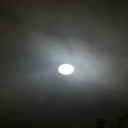

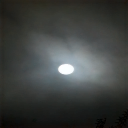

Validation Epoch : [100 / 125]	Loss-41.4631


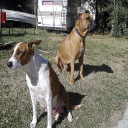

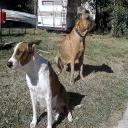

[Training] epoch 96 
Train Epoch : [96] [0 / 1125]	Loss-40.9354
Train Epoch : [96] [100 / 1125]	Loss-44.0724
Train Epoch : [96] [200 / 1125]	Loss-43.4024
Train Epoch : [96] [300 / 1125]	Loss-45.1212
Train Epoch : [96] [400 / 1125]	Loss-45.0932
Train Epoch : [96] [500 / 1125]	Loss-43.1547
Train Epoch : [96] [600 / 1125]	Loss-40.0333
Train Epoch : [96] [700 / 1125]	Loss-40.4093
Train Epoch : [96] [800 / 1125]	Loss-40.8019
Train Epoch : [96] [900 / 1125]	Loss-40.7727
Train Epoch : [96] [1000 / 1125]	Loss-43.8085
Train Epoch : [96] [1100 / 1125]	Loss-43.7812
Validation Epoch : [0 / 125]	Loss-41.8851


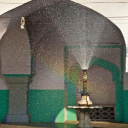

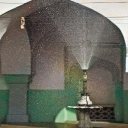

Validation Epoch : [100 / 125]	Loss-41.5721


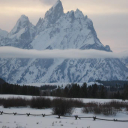

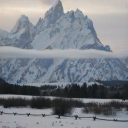

[Training] epoch 97 
Train Epoch : [97] [0 / 1125]	Loss-39.2659
Train Epoch : [97] [100 / 1125]	Loss-46.1676
Train Epoch : [97] [200 / 1125]	Loss-42.1692
Train Epoch : [97] [300 / 1125]	Loss-41.3371
Train Epoch : [97] [400 / 1125]	Loss-41.1750
Train Epoch : [97] [500 / 1125]	Loss-42.6009
Train Epoch : [97] [600 / 1125]	Loss-40.4235
Train Epoch : [97] [700 / 1125]	Loss-41.2927
Train Epoch : [97] [800 / 1125]	Loss-43.4273
Train Epoch : [97] [900 / 1125]	Loss-45.0271
Train Epoch : [97] [1000 / 1125]	Loss-41.2910
Train Epoch : [97] [1100 / 1125]	Loss-40.8952
Validation Epoch : [0 / 125]	Loss-44.2982


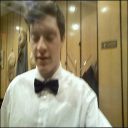

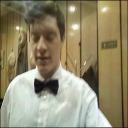

Validation Epoch : [100 / 125]	Loss-40.0810


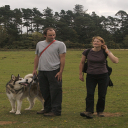

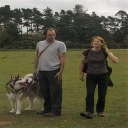

[Training] epoch 98 
Train Epoch : [98] [0 / 1125]	Loss-43.9091
Train Epoch : [98] [100 / 1125]	Loss-43.2646
Train Epoch : [98] [200 / 1125]	Loss-41.5913
Train Epoch : [98] [300 / 1125]	Loss-41.1119
Train Epoch : [98] [400 / 1125]	Loss-45.0348
Train Epoch : [98] [500 / 1125]	Loss-43.6967
Train Epoch : [98] [600 / 1125]	Loss-42.0520
Train Epoch : [98] [700 / 1125]	Loss-42.2214
Train Epoch : [98] [800 / 1125]	Loss-40.9086
Train Epoch : [98] [900 / 1125]	Loss-38.9899
Train Epoch : [98] [1000 / 1125]	Loss-46.7024
Train Epoch : [98] [1100 / 1125]	Loss-41.0918
Validation Epoch : [0 / 125]	Loss-41.3533


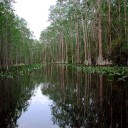

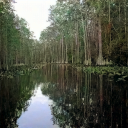

Validation Epoch : [100 / 125]	Loss-39.8554


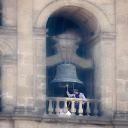

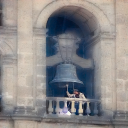

[Training] epoch 99 
Train Epoch : [99] [0 / 1125]	Loss-42.7345
Train Epoch : [99] [100 / 1125]	Loss-40.9533
Train Epoch : [99] [200 / 1125]	Loss-42.6648
Train Epoch : [99] [300 / 1125]	Loss-41.2664
Train Epoch : [99] [400 / 1125]	Loss-42.0721
Train Epoch : [99] [500 / 1125]	Loss-40.6033
Train Epoch : [99] [600 / 1125]	Loss-42.1717
Train Epoch : [99] [700 / 1125]	Loss-42.7973
Train Epoch : [99] [800 / 1125]	Loss-40.7349
Train Epoch : [99] [900 / 1125]	Loss-43.1180
Train Epoch : [99] [1000 / 1125]	Loss-39.9777
Train Epoch : [99] [1100 / 1125]	Loss-40.8471
Validation Epoch : [0 / 125]	Loss-43.3883


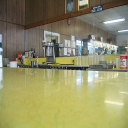

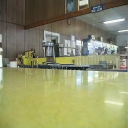

Validation Epoch : [100 / 125]	Loss-40.3611


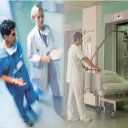

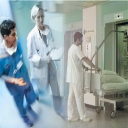

[Training] epoch 100 
Train Epoch : [100] [0 / 1125]	Loss-42.7045
Train Epoch : [100] [100 / 1125]	Loss-45.8738
Train Epoch : [100] [200 / 1125]	Loss-45.6348
Train Epoch : [100] [300 / 1125]	Loss-39.2363
Train Epoch : [100] [400 / 1125]	Loss-46.5203
Train Epoch : [100] [500 / 1125]	Loss-41.4638
Train Epoch : [100] [600 / 1125]	Loss-43.6381
Train Epoch : [100] [700 / 1125]	Loss-43.7044
Train Epoch : [100] [800 / 1125]	Loss-43.1770
Train Epoch : [100] [900 / 1125]	Loss-41.3890
Train Epoch : [100] [1000 / 1125]	Loss-41.5418
Train Epoch : [100] [1100 / 1125]	Loss-44.3897
Validation Epoch : [0 / 125]	Loss-40.2480


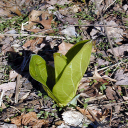

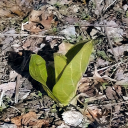

Validation Epoch : [100 / 125]	Loss-44.4819


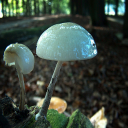

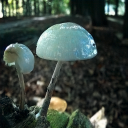

[Training] epoch 101 
Train Epoch : [101] [0 / 1125]	Loss-41.9959
Train Epoch : [101] [100 / 1125]	Loss-42.3798
Train Epoch : [101] [200 / 1125]	Loss-41.5853
Train Epoch : [101] [300 / 1125]	Loss-46.6412
Train Epoch : [101] [400 / 1125]	Loss-41.9528
Train Epoch : [101] [500 / 1125]	Loss-43.3117
Train Epoch : [101] [600 / 1125]	Loss-39.7189
Train Epoch : [101] [700 / 1125]	Loss-42.8918
Train Epoch : [101] [800 / 1125]	Loss-45.0622
Train Epoch : [101] [900 / 1125]	Loss-42.7621
Train Epoch : [101] [1000 / 1125]	Loss-45.1510
Train Epoch : [101] [1100 / 1125]	Loss-44.1834
Validation Epoch : [0 / 125]	Loss-37.8641


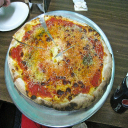

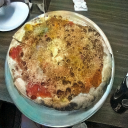

Validation Epoch : [100 / 125]	Loss-41.7000


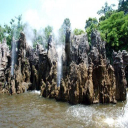

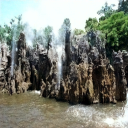

[Training] epoch 102 
Train Epoch : [102] [0 / 1125]	Loss-41.8943
Train Epoch : [102] [100 / 1125]	Loss-41.8723
Train Epoch : [102] [200 / 1125]	Loss-44.3046
Train Epoch : [102] [300 / 1125]	Loss-40.8768
Train Epoch : [102] [400 / 1125]	Loss-43.0067
Train Epoch : [102] [500 / 1125]	Loss-41.3815
Train Epoch : [102] [600 / 1125]	Loss-40.8044
Train Epoch : [102] [700 / 1125]	Loss-41.8253
Train Epoch : [102] [800 / 1125]	Loss-39.2752
Train Epoch : [102] [900 / 1125]	Loss-43.5926
Train Epoch : [102] [1000 / 1125]	Loss-40.6946
Train Epoch : [102] [1100 / 1125]	Loss-42.6772
Validation Epoch : [0 / 125]	Loss-42.9683


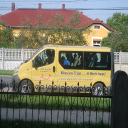

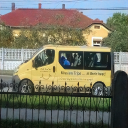

Validation Epoch : [100 / 125]	Loss-41.4384


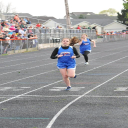

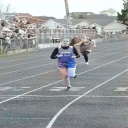

[Training] epoch 103 
Train Epoch : [103] [0 / 1125]	Loss-41.4745
Train Epoch : [103] [100 / 1125]	Loss-39.7229
Train Epoch : [103] [200 / 1125]	Loss-45.5853
Train Epoch : [103] [300 / 1125]	Loss-40.5245
Train Epoch : [103] [400 / 1125]	Loss-40.8483
Train Epoch : [103] [500 / 1125]	Loss-39.1876
Train Epoch : [103] [600 / 1125]	Loss-42.0192
Train Epoch : [103] [700 / 1125]	Loss-43.3791
Train Epoch : [103] [800 / 1125]	Loss-43.8005
Train Epoch : [103] [900 / 1125]	Loss-43.7355
Train Epoch : [103] [1000 / 1125]	Loss-42.8775
Train Epoch : [103] [1100 / 1125]	Loss-44.6438
Validation Epoch : [0 / 125]	Loss-43.2155


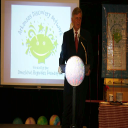

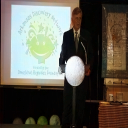

Validation Epoch : [100 / 125]	Loss-38.3022


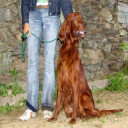

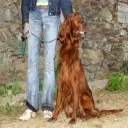

[Training] epoch 104 
Train Epoch : [104] [0 / 1125]	Loss-45.8900
Train Epoch : [104] [100 / 1125]	Loss-47.5021
Train Epoch : [104] [200 / 1125]	Loss-42.5561
Train Epoch : [104] [300 / 1125]	Loss-45.7192
Train Epoch : [104] [400 / 1125]	Loss-42.7579
Train Epoch : [104] [500 / 1125]	Loss-40.8841
Train Epoch : [104] [600 / 1125]	Loss-44.3011
Train Epoch : [104] [700 / 1125]	Loss-42.2762
Train Epoch : [104] [800 / 1125]	Loss-38.2169
Train Epoch : [104] [900 / 1125]	Loss-37.1262
Train Epoch : [104] [1000 / 1125]	Loss-45.7347
Train Epoch : [104] [1100 / 1125]	Loss-40.2720
Validation Epoch : [0 / 125]	Loss-39.9212


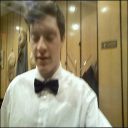

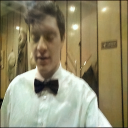

Validation Epoch : [100 / 125]	Loss-42.0975


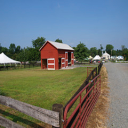

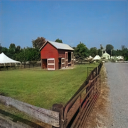

[Training] epoch 105 
Train Epoch : [105] [0 / 1125]	Loss-40.4622
Train Epoch : [105] [100 / 1125]	Loss-40.1749
Train Epoch : [105] [200 / 1125]	Loss-42.3504
Train Epoch : [105] [300 / 1125]	Loss-42.4119
Train Epoch : [105] [400 / 1125]	Loss-42.5671
Train Epoch : [105] [500 / 1125]	Loss-37.7567
Train Epoch : [105] [600 / 1125]	Loss-38.1703
Train Epoch : [105] [700 / 1125]	Loss-42.0468
Train Epoch : [105] [800 / 1125]	Loss-45.5925
Train Epoch : [105] [900 / 1125]	Loss-43.5875
Train Epoch : [105] [1000 / 1125]	Loss-45.0837
Train Epoch : [105] [1100 / 1125]	Loss-42.9041
Validation Epoch : [0 / 125]	Loss-40.2854


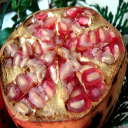

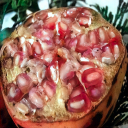

Validation Epoch : [100 / 125]	Loss-42.1063


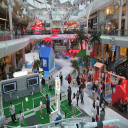

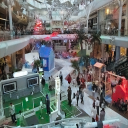

[Training] epoch 106 
Train Epoch : [106] [0 / 1125]	Loss-45.8372
Train Epoch : [106] [100 / 1125]	Loss-42.1708
Train Epoch : [106] [200 / 1125]	Loss-45.1107
Train Epoch : [106] [300 / 1125]	Loss-41.3345
Train Epoch : [106] [400 / 1125]	Loss-43.7190
Train Epoch : [106] [500 / 1125]	Loss-42.0135
Train Epoch : [106] [600 / 1125]	Loss-43.2182
Train Epoch : [106] [700 / 1125]	Loss-45.5418
Train Epoch : [106] [800 / 1125]	Loss-39.6173
Train Epoch : [106] [900 / 1125]	Loss-42.2709
Train Epoch : [106] [1000 / 1125]	Loss-41.3402
Train Epoch : [106] [1100 / 1125]	Loss-40.6888
Validation Epoch : [0 / 125]	Loss-40.4253


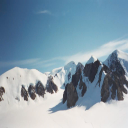

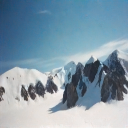

Validation Epoch : [100 / 125]	Loss-44.3527


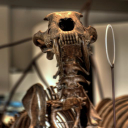

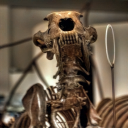

[Training] epoch 107 
Train Epoch : [107] [0 / 1125]	Loss-42.4854
Train Epoch : [107] [100 / 1125]	Loss-40.5170
Train Epoch : [107] [200 / 1125]	Loss-45.8115
Train Epoch : [107] [300 / 1125]	Loss-43.0217
Train Epoch : [107] [400 / 1125]	Loss-40.4385
Train Epoch : [107] [500 / 1125]	Loss-45.4059
Train Epoch : [107] [600 / 1125]	Loss-41.1244
Train Epoch : [107] [700 / 1125]	Loss-39.9839
Train Epoch : [107] [800 / 1125]	Loss-42.0712
Train Epoch : [107] [900 / 1125]	Loss-44.7876
Train Epoch : [107] [1000 / 1125]	Loss-44.6397
Train Epoch : [107] [1100 / 1125]	Loss-42.0379
Validation Epoch : [0 / 125]	Loss-45.0878


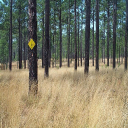

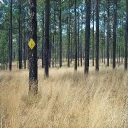

Validation Epoch : [100 / 125]	Loss-42.2511


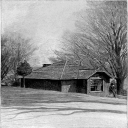

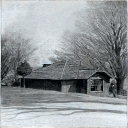

[Training] epoch 108 
Train Epoch : [108] [0 / 1125]	Loss-40.5004
Train Epoch : [108] [100 / 1125]	Loss-42.7947
Train Epoch : [108] [200 / 1125]	Loss-45.4361
Train Epoch : [108] [300 / 1125]	Loss-46.1733
Train Epoch : [108] [400 / 1125]	Loss-42.9010
Train Epoch : [108] [500 / 1125]	Loss-41.3648
Train Epoch : [108] [600 / 1125]	Loss-45.0478
Train Epoch : [108] [700 / 1125]	Loss-45.8108
Train Epoch : [108] [800 / 1125]	Loss-42.3430
Train Epoch : [108] [900 / 1125]	Loss-40.7519
Train Epoch : [108] [1000 / 1125]	Loss-44.3142
Train Epoch : [108] [1100 / 1125]	Loss-41.4175
Validation Epoch : [0 / 125]	Loss-42.3682


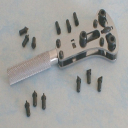

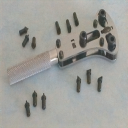

Validation Epoch : [100 / 125]	Loss-42.4956


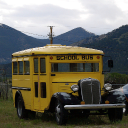

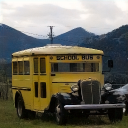

[Training] epoch 109 
Train Epoch : [109] [0 / 1125]	Loss-37.1226
Train Epoch : [109] [100 / 1125]	Loss-43.3829
Train Epoch : [109] [200 / 1125]	Loss-41.0618
Train Epoch : [109] [300 / 1125]	Loss-38.7538
Train Epoch : [109] [400 / 1125]	Loss-42.1027
Train Epoch : [109] [500 / 1125]	Loss-44.2533
Train Epoch : [109] [600 / 1125]	Loss-40.7235
Train Epoch : [109] [700 / 1125]	Loss-43.3408
Train Epoch : [109] [800 / 1125]	Loss-40.9868
Train Epoch : [109] [900 / 1125]	Loss-41.0687
Train Epoch : [109] [1000 / 1125]	Loss-44.3629
Train Epoch : [109] [1100 / 1125]	Loss-42.5430
Validation Epoch : [0 / 125]	Loss-38.0758


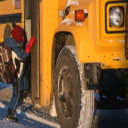

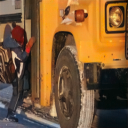

Validation Epoch : [100 / 125]	Loss-39.3576


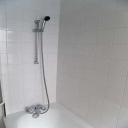

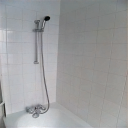

[Training] epoch 110 
Train Epoch : [110] [0 / 1125]	Loss-40.5056
Train Epoch : [110] [100 / 1125]	Loss-48.5285
Train Epoch : [110] [200 / 1125]	Loss-42.1676
Train Epoch : [110] [300 / 1125]	Loss-45.0951
Train Epoch : [110] [400 / 1125]	Loss-40.5902
Train Epoch : [110] [500 / 1125]	Loss-43.0926
Train Epoch : [110] [600 / 1125]	Loss-40.1556
Train Epoch : [110] [700 / 1125]	Loss-43.1320
Train Epoch : [110] [800 / 1125]	Loss-42.9381
Train Epoch : [110] [900 / 1125]	Loss-40.8289
Train Epoch : [110] [1000 / 1125]	Loss-44.1567
Train Epoch : [110] [1100 / 1125]	Loss-41.3735
Validation Epoch : [0 / 125]	Loss-41.0074


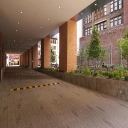

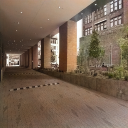

Validation Epoch : [100 / 125]	Loss-42.9330


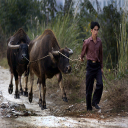

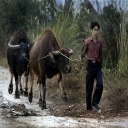

[Training] epoch 111 
Train Epoch : [111] [0 / 1125]	Loss-43.0922
Train Epoch : [111] [100 / 1125]	Loss-46.3736
Train Epoch : [111] [200 / 1125]	Loss-41.7726
Train Epoch : [111] [300 / 1125]	Loss-41.5374
Train Epoch : [111] [400 / 1125]	Loss-44.2957
Train Epoch : [111] [500 / 1125]	Loss-40.6076
Train Epoch : [111] [600 / 1125]	Loss-44.0294
Train Epoch : [111] [700 / 1125]	Loss-41.4955
Train Epoch : [111] [800 / 1125]	Loss-36.9698
Train Epoch : [111] [900 / 1125]	Loss-42.2707
Train Epoch : [111] [1000 / 1125]	Loss-40.1670
Train Epoch : [111] [1100 / 1125]	Loss-39.7608
Validation Epoch : [0 / 125]	Loss-40.2551


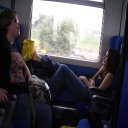

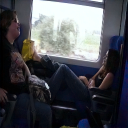

Validation Epoch : [100 / 125]	Loss-42.9873


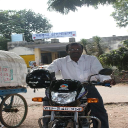

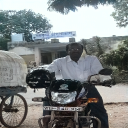

[Training] epoch 112 
Train Epoch : [112] [0 / 1125]	Loss-42.3357
Train Epoch : [112] [100 / 1125]	Loss-42.4699
Train Epoch : [112] [200 / 1125]	Loss-42.1640
Train Epoch : [112] [300 / 1125]	Loss-44.1601
Train Epoch : [112] [400 / 1125]	Loss-43.3857
Train Epoch : [112] [500 / 1125]	Loss-45.5373
Train Epoch : [112] [600 / 1125]	Loss-46.1290
Train Epoch : [112] [700 / 1125]	Loss-40.7323
Train Epoch : [112] [800 / 1125]	Loss-42.5918
Train Epoch : [112] [900 / 1125]	Loss-41.1281
Train Epoch : [112] [1000 / 1125]	Loss-41.7718
Train Epoch : [112] [1100 / 1125]	Loss-42.6342
Validation Epoch : [0 / 125]	Loss-44.7463


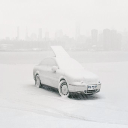

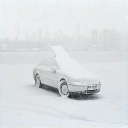

Validation Epoch : [100 / 125]	Loss-43.7857


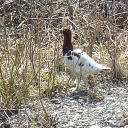

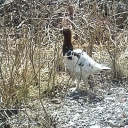

[Training] epoch 113 
Train Epoch : [113] [0 / 1125]	Loss-42.1226
Train Epoch : [113] [100 / 1125]	Loss-42.3445
Train Epoch : [113] [200 / 1125]	Loss-45.6568
Train Epoch : [113] [300 / 1125]	Loss-41.7897
Train Epoch : [113] [400 / 1125]	Loss-41.2401
Train Epoch : [113] [500 / 1125]	Loss-43.5364
Train Epoch : [113] [600 / 1125]	Loss-41.5296
Train Epoch : [113] [700 / 1125]	Loss-43.6313
Train Epoch : [113] [800 / 1125]	Loss-39.3882
Train Epoch : [113] [900 / 1125]	Loss-40.8522
Train Epoch : [113] [1000 / 1125]	Loss-42.9608
Train Epoch : [113] [1100 / 1125]	Loss-42.2749
Validation Epoch : [0 / 125]	Loss-39.1174


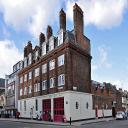

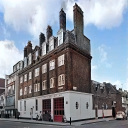

Validation Epoch : [100 / 125]	Loss-45.2057


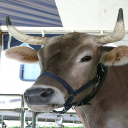

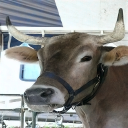

[Training] epoch 114 
Train Epoch : [114] [0 / 1125]	Loss-43.8557
Train Epoch : [114] [100 / 1125]	Loss-45.1825
Train Epoch : [114] [200 / 1125]	Loss-40.1831
Train Epoch : [114] [300 / 1125]	Loss-42.7902
Train Epoch : [114] [400 / 1125]	Loss-44.8825
Train Epoch : [114] [500 / 1125]	Loss-42.6546
Train Epoch : [114] [600 / 1125]	Loss-42.2163
Train Epoch : [114] [700 / 1125]	Loss-40.1180
Train Epoch : [114] [800 / 1125]	Loss-42.4294
Train Epoch : [114] [900 / 1125]	Loss-41.8558
Train Epoch : [114] [1000 / 1125]	Loss-43.4826
Train Epoch : [114] [1100 / 1125]	Loss-38.1443
Validation Epoch : [0 / 125]	Loss-40.7060


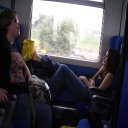

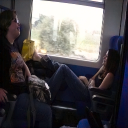

Validation Epoch : [100 / 125]	Loss-40.8605


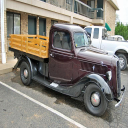

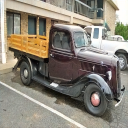

[Training] epoch 115 
Train Epoch : [115] [0 / 1125]	Loss-43.0869
Train Epoch : [115] [100 / 1125]	Loss-41.3984
Train Epoch : [115] [200 / 1125]	Loss-41.9567
Train Epoch : [115] [300 / 1125]	Loss-38.9542
Train Epoch : [115] [400 / 1125]	Loss-38.3636
Train Epoch : [115] [500 / 1125]	Loss-45.3143
Train Epoch : [115] [600 / 1125]	Loss-40.6651
Train Epoch : [115] [700 / 1125]	Loss-42.5312
Train Epoch : [115] [800 / 1125]	Loss-39.6960
Train Epoch : [115] [900 / 1125]	Loss-38.9279
Train Epoch : [115] [1000 / 1125]	Loss-40.5550
Train Epoch : [115] [1100 / 1125]	Loss-43.8411
Validation Epoch : [0 / 125]	Loss-41.8619


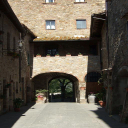

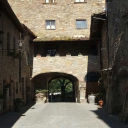

Validation Epoch : [100 / 125]	Loss-42.2466


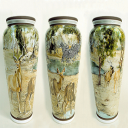

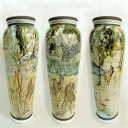

[Training] epoch 116 
Train Epoch : [116] [0 / 1125]	Loss-38.5678
Train Epoch : [116] [100 / 1125]	Loss-43.9452
Train Epoch : [116] [200 / 1125]	Loss-40.5449
Train Epoch : [116] [300 / 1125]	Loss-41.4556
Train Epoch : [116] [400 / 1125]	Loss-39.2532
Train Epoch : [116] [500 / 1125]	Loss-40.4713
Train Epoch : [116] [600 / 1125]	Loss-44.0685
Train Epoch : [116] [700 / 1125]	Loss-40.6627
Train Epoch : [116] [800 / 1125]	Loss-43.4905
Train Epoch : [116] [900 / 1125]	Loss-43.6496
Train Epoch : [116] [1000 / 1125]	Loss-41.4113
Train Epoch : [116] [1100 / 1125]	Loss-44.5435
Validation Epoch : [0 / 125]	Loss-45.8802


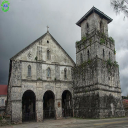

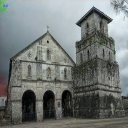

Validation Epoch : [100 / 125]	Loss-43.8922


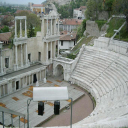

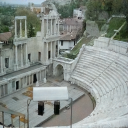

[Training] epoch 117 
Train Epoch : [117] [0 / 1125]	Loss-40.1497
Train Epoch : [117] [100 / 1125]	Loss-43.9104
Train Epoch : [117] [200 / 1125]	Loss-45.6506
Train Epoch : [117] [300 / 1125]	Loss-42.3451
Train Epoch : [117] [400 / 1125]	Loss-39.2308
Train Epoch : [117] [500 / 1125]	Loss-45.1568
Train Epoch : [117] [600 / 1125]	Loss-43.2746
Train Epoch : [117] [700 / 1125]	Loss-44.3254
Train Epoch : [117] [800 / 1125]	Loss-38.6815
Train Epoch : [117] [900 / 1125]	Loss-42.6719
Train Epoch : [117] [1000 / 1125]	Loss-39.6828
Train Epoch : [117] [1100 / 1125]	Loss-40.3686
Validation Epoch : [0 / 125]	Loss-42.1457


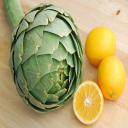

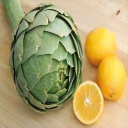

Validation Epoch : [100 / 125]	Loss-44.3820


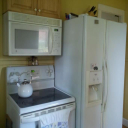

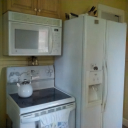

[Training] epoch 118 
Train Epoch : [118] [0 / 1125]	Loss-44.5032
Train Epoch : [118] [100 / 1125]	Loss-40.4933
Train Epoch : [118] [200 / 1125]	Loss-44.0679
Train Epoch : [118] [300 / 1125]	Loss-39.9275
Train Epoch : [118] [400 / 1125]	Loss-41.2077
Train Epoch : [118] [500 / 1125]	Loss-44.5689
Train Epoch : [118] [600 / 1125]	Loss-39.6512
Train Epoch : [118] [700 / 1125]	Loss-45.3316
Train Epoch : [118] [800 / 1125]	Loss-45.9419
Train Epoch : [118] [900 / 1125]	Loss-42.5286
Train Epoch : [118] [1000 / 1125]	Loss-44.0306
Train Epoch : [118] [1100 / 1125]	Loss-44.0068
Validation Epoch : [0 / 125]	Loss-45.4128


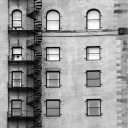

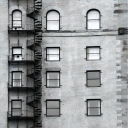

Validation Epoch : [100 / 125]	Loss-42.6972


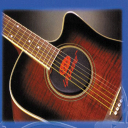

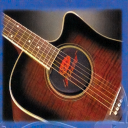

[Training] epoch 119 
Train Epoch : [119] [0 / 1125]	Loss-42.4203
Train Epoch : [119] [100 / 1125]	Loss-40.8428
Train Epoch : [119] [200 / 1125]	Loss-42.7462
Train Epoch : [119] [300 / 1125]	Loss-41.8570
Train Epoch : [119] [400 / 1125]	Loss-42.1551
Train Epoch : [119] [500 / 1125]	Loss-44.3621
Train Epoch : [119] [600 / 1125]	Loss-42.4552
Train Epoch : [119] [700 / 1125]	Loss-41.0552
Train Epoch : [119] [800 / 1125]	Loss-44.1675
Train Epoch : [119] [900 / 1125]	Loss-40.5090
Train Epoch : [119] [1000 / 1125]	Loss-41.8386
Train Epoch : [119] [1100 / 1125]	Loss-40.6785
Validation Epoch : [0 / 125]	Loss-40.7751


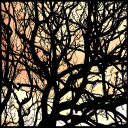

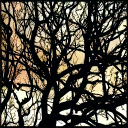

Validation Epoch : [100 / 125]	Loss-42.8560


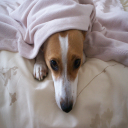

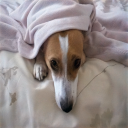

[Training] epoch 120 
Train Epoch : [120] [0 / 1125]	Loss-41.1281
Train Epoch : [120] [100 / 1125]	Loss-38.0257
Train Epoch : [120] [200 / 1125]	Loss-39.7330
Train Epoch : [120] [300 / 1125]	Loss-40.8084
Train Epoch : [120] [400 / 1125]	Loss-40.8517
Train Epoch : [120] [500 / 1125]	Loss-42.7569
Train Epoch : [120] [600 / 1125]	Loss-43.5281
Train Epoch : [120] [700 / 1125]	Loss-41.4600
Train Epoch : [120] [800 / 1125]	Loss-45.9672
Train Epoch : [120] [900 / 1125]	Loss-41.8104
Train Epoch : [120] [1000 / 1125]	Loss-39.7241
Train Epoch : [120] [1100 / 1125]	Loss-44.2482
Validation Epoch : [0 / 125]	Loss-41.4333


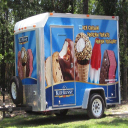

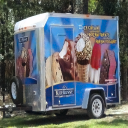

Validation Epoch : [100 / 125]	Loss-45.5501


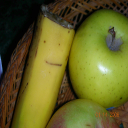

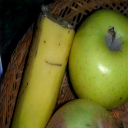

[Training] epoch 121 
Train Epoch : [121] [0 / 1125]	Loss-41.7847
Train Epoch : [121] [100 / 1125]	Loss-41.5372
Train Epoch : [121] [200 / 1125]	Loss-40.1115
Train Epoch : [121] [300 / 1125]	Loss-39.5936
Train Epoch : [121] [400 / 1125]	Loss-42.5513
Train Epoch : [121] [500 / 1125]	Loss-42.6685
Train Epoch : [121] [600 / 1125]	Loss-42.9531
Train Epoch : [121] [700 / 1125]	Loss-44.3407
Train Epoch : [121] [800 / 1125]	Loss-42.7239
Train Epoch : [121] [900 / 1125]	Loss-41.2193
Train Epoch : [121] [1000 / 1125]	Loss-38.5424
Train Epoch : [121] [1100 / 1125]	Loss-40.9085
Validation Epoch : [0 / 125]	Loss-40.5525


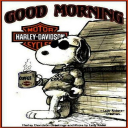

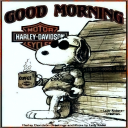

Validation Epoch : [100 / 125]	Loss-43.0959


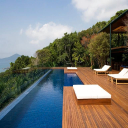

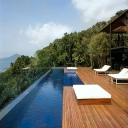

[Training] epoch 122 
Train Epoch : [122] [0 / 1125]	Loss-41.7129
Train Epoch : [122] [100 / 1125]	Loss-41.7711
Train Epoch : [122] [200 / 1125]	Loss-45.6393
Train Epoch : [122] [300 / 1125]	Loss-43.8553
Train Epoch : [122] [400 / 1125]	Loss-41.2987
Train Epoch : [122] [500 / 1125]	Loss-39.7404
Train Epoch : [122] [600 / 1125]	Loss-44.2603
Train Epoch : [122] [700 / 1125]	Loss-42.5191
Train Epoch : [122] [800 / 1125]	Loss-42.3626
Train Epoch : [122] [900 / 1125]	Loss-43.3570
Train Epoch : [122] [1000 / 1125]	Loss-42.7996
Train Epoch : [122] [1100 / 1125]	Loss-47.1076
Validation Epoch : [0 / 125]	Loss-41.8380


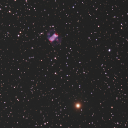

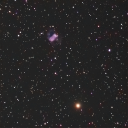

Validation Epoch : [100 / 125]	Loss-41.8469


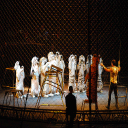

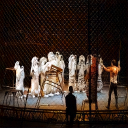

[Training] epoch 123 
Train Epoch : [123] [0 / 1125]	Loss-42.3485
Train Epoch : [123] [100 / 1125]	Loss-36.9415
Train Epoch : [123] [200 / 1125]	Loss-44.0816
Train Epoch : [123] [300 / 1125]	Loss-41.8499
Train Epoch : [123] [400 / 1125]	Loss-43.5719
Train Epoch : [123] [500 / 1125]	Loss-41.4016
Train Epoch : [123] [600 / 1125]	Loss-41.3328
Train Epoch : [123] [700 / 1125]	Loss-44.2178
Train Epoch : [123] [800 / 1125]	Loss-39.2158
Train Epoch : [123] [900 / 1125]	Loss-45.5732
Train Epoch : [123] [1000 / 1125]	Loss-38.9016
Train Epoch : [123] [1100 / 1125]	Loss-41.7677
Validation Epoch : [0 / 125]	Loss-44.4061


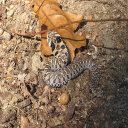

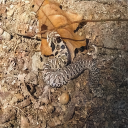

Validation Epoch : [100 / 125]	Loss-41.5127


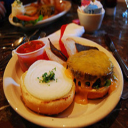

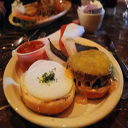

[Training] epoch 124 
Train Epoch : [124] [0 / 1125]	Loss-42.5049
Train Epoch : [124] [100 / 1125]	Loss-42.7209
Train Epoch : [124] [200 / 1125]	Loss-42.9725
Train Epoch : [124] [300 / 1125]	Loss-41.1151
Train Epoch : [124] [400 / 1125]	Loss-41.8696
Train Epoch : [124] [500 / 1125]	Loss-41.1344
Train Epoch : [124] [600 / 1125]	Loss-39.7234
Train Epoch : [124] [700 / 1125]	Loss-41.8735
Train Epoch : [124] [800 / 1125]	Loss-45.7522
Train Epoch : [124] [900 / 1125]	Loss-43.7307
Train Epoch : [124] [1000 / 1125]	Loss-40.8241
Train Epoch : [124] [1100 / 1125]	Loss-40.6605
Validation Epoch : [0 / 125]	Loss-41.2206


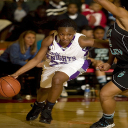

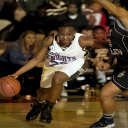

Validation Epoch : [100 / 125]	Loss-39.3317


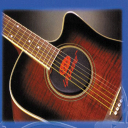

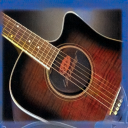

[Training] epoch 125 
Train Epoch : [125] [0 / 1125]	Loss-44.3554
Train Epoch : [125] [100 / 1125]	Loss-38.5446
Train Epoch : [125] [200 / 1125]	Loss-42.9894
Train Epoch : [125] [300 / 1125]	Loss-39.5038
Train Epoch : [125] [400 / 1125]	Loss-39.0061
Train Epoch : [125] [500 / 1125]	Loss-40.3165
Train Epoch : [125] [600 / 1125]	Loss-46.4763
Train Epoch : [125] [700 / 1125]	Loss-44.9848
Train Epoch : [125] [800 / 1125]	Loss-40.2484
Train Epoch : [125] [900 / 1125]	Loss-39.8149
Train Epoch : [125] [1000 / 1125]	Loss-40.6169
Train Epoch : [125] [1100 / 1125]	Loss-46.1398
Validation Epoch : [0 / 125]	Loss-42.3911


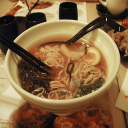

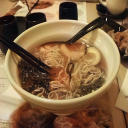

Validation Epoch : [100 / 125]	Loss-43.4475


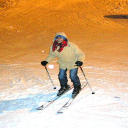

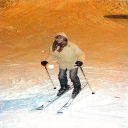

[Training] epoch 126 
Train Epoch : [126] [0 / 1125]	Loss-43.8867
Train Epoch : [126] [100 / 1125]	Loss-41.5649
Train Epoch : [126] [200 / 1125]	Loss-43.0186
Train Epoch : [126] [300 / 1125]	Loss-42.1192
Train Epoch : [126] [400 / 1125]	Loss-41.2068
Train Epoch : [126] [500 / 1125]	Loss-43.4982
Train Epoch : [126] [600 / 1125]	Loss-37.6400
Train Epoch : [126] [700 / 1125]	Loss-43.2924
Train Epoch : [126] [800 / 1125]	Loss-38.4596
Train Epoch : [126] [900 / 1125]	Loss-40.6041
Train Epoch : [126] [1000 / 1125]	Loss-42.6402
Train Epoch : [126] [1100 / 1125]	Loss-47.2670
Validation Epoch : [0 / 125]	Loss-46.3955


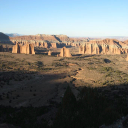

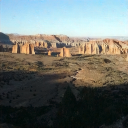

Validation Epoch : [100 / 125]	Loss-40.3256


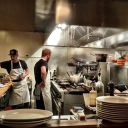

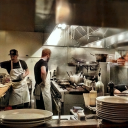

[Training] epoch 127 
Train Epoch : [127] [0 / 1125]	Loss-40.4030
Train Epoch : [127] [100 / 1125]	Loss-45.2812
Train Epoch : [127] [200 / 1125]	Loss-41.7232
Train Epoch : [127] [300 / 1125]	Loss-43.7786
Train Epoch : [127] [400 / 1125]	Loss-38.7670
Train Epoch : [127] [500 / 1125]	Loss-42.0367
Train Epoch : [127] [600 / 1125]	Loss-41.6387
Train Epoch : [127] [700 / 1125]	Loss-41.3727
Train Epoch : [127] [800 / 1125]	Loss-43.3411
Train Epoch : [127] [900 / 1125]	Loss-43.2029
Train Epoch : [127] [1000 / 1125]	Loss-41.6363
Train Epoch : [127] [1100 / 1125]	Loss-43.7124
Validation Epoch : [0 / 125]	Loss-43.0196


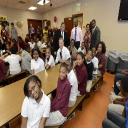

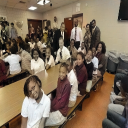

Validation Epoch : [100 / 125]	Loss-45.2119


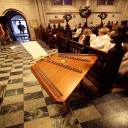

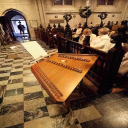

[Training] epoch 128 
Train Epoch : [128] [0 / 1125]	Loss-38.9600
Train Epoch : [128] [100 / 1125]	Loss-41.0798
Train Epoch : [128] [200 / 1125]	Loss-43.8984
Train Epoch : [128] [300 / 1125]	Loss-40.3087
Train Epoch : [128] [400 / 1125]	Loss-43.8535
Train Epoch : [128] [500 / 1125]	Loss-44.6515
Train Epoch : [128] [600 / 1125]	Loss-38.4111
Train Epoch : [128] [700 / 1125]	Loss-42.4531
Train Epoch : [128] [800 / 1125]	Loss-41.8261
Train Epoch : [128] [900 / 1125]	Loss-43.1606
Train Epoch : [128] [1000 / 1125]	Loss-40.4193
Train Epoch : [128] [1100 / 1125]	Loss-42.0023
Validation Epoch : [0 / 125]	Loss-37.7071


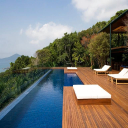

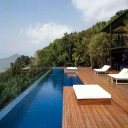

Validation Epoch : [100 / 125]	Loss-43.4248


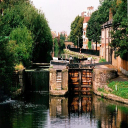

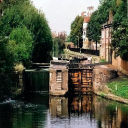

[Training] epoch 129 
Train Epoch : [129] [0 / 1125]	Loss-39.9489
Train Epoch : [129] [100 / 1125]	Loss-42.8565
Train Epoch : [129] [200 / 1125]	Loss-42.1352
Train Epoch : [129] [300 / 1125]	Loss-39.1311
Train Epoch : [129] [400 / 1125]	Loss-42.5186
Train Epoch : [129] [500 / 1125]	Loss-39.5192
Train Epoch : [129] [600 / 1125]	Loss-46.1948
Train Epoch : [129] [700 / 1125]	Loss-39.9009
Train Epoch : [129] [800 / 1125]	Loss-40.1609
Train Epoch : [129] [900 / 1125]	Loss-44.0322
Train Epoch : [129] [1000 / 1125]	Loss-45.3170
Train Epoch : [129] [1100 / 1125]	Loss-40.8902
Validation Epoch : [0 / 125]	Loss-42.6322


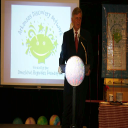

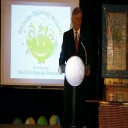

Validation Epoch : [100 / 125]	Loss-43.5664


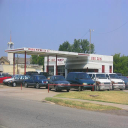

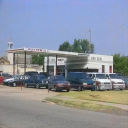

[Training] epoch 130 
Train Epoch : [130] [0 / 1125]	Loss-41.1257
Train Epoch : [130] [100 / 1125]	Loss-41.1650
Train Epoch : [130] [200 / 1125]	Loss-43.6399
Train Epoch : [130] [300 / 1125]	Loss-42.5050
Train Epoch : [130] [400 / 1125]	Loss-41.5313
Train Epoch : [130] [500 / 1125]	Loss-41.9731
Train Epoch : [130] [600 / 1125]	Loss-42.8303
Train Epoch : [130] [700 / 1125]	Loss-39.5490
Train Epoch : [130] [800 / 1125]	Loss-44.0830
Train Epoch : [130] [900 / 1125]	Loss-42.3458
Train Epoch : [130] [1000 / 1125]	Loss-42.4284
Train Epoch : [130] [1100 / 1125]	Loss-41.8440
Validation Epoch : [0 / 125]	Loss-45.3166


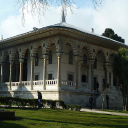

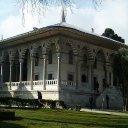

Validation Epoch : [100 / 125]	Loss-39.7606


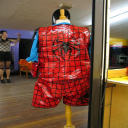

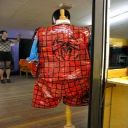

[Training] epoch 131 
Train Epoch : [131] [0 / 1125]	Loss-45.4457
Train Epoch : [131] [100 / 1125]	Loss-42.9393
Train Epoch : [131] [200 / 1125]	Loss-44.7714
Train Epoch : [131] [300 / 1125]	Loss-44.4125
Train Epoch : [131] [400 / 1125]	Loss-41.6088
Train Epoch : [131] [500 / 1125]	Loss-40.3053
Train Epoch : [131] [600 / 1125]	Loss-43.7761
Train Epoch : [131] [700 / 1125]	Loss-42.4474
Train Epoch : [131] [800 / 1125]	Loss-38.8145
Train Epoch : [131] [900 / 1125]	Loss-44.4529
Train Epoch : [131] [1000 / 1125]	Loss-40.7858
Train Epoch : [131] [1100 / 1125]	Loss-41.6154
Validation Epoch : [0 / 125]	Loss-41.5271


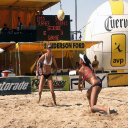

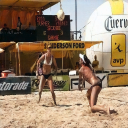

Validation Epoch : [100 / 125]	Loss-42.5225


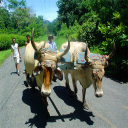

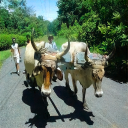

[Training] epoch 132 
Train Epoch : [132] [0 / 1125]	Loss-40.3662
Train Epoch : [132] [100 / 1125]	Loss-43.3013
Train Epoch : [132] [200 / 1125]	Loss-43.7615
Train Epoch : [132] [300 / 1125]	Loss-44.6962
Train Epoch : [132] [400 / 1125]	Loss-43.9461
Train Epoch : [132] [500 / 1125]	Loss-40.6441
Train Epoch : [132] [600 / 1125]	Loss-39.9094
Train Epoch : [132] [700 / 1125]	Loss-45.9767
Train Epoch : [132] [800 / 1125]	Loss-44.3538
Train Epoch : [132] [900 / 1125]	Loss-41.1212
Train Epoch : [132] [1000 / 1125]	Loss-43.6063
Train Epoch : [132] [1100 / 1125]	Loss-42.6397
Validation Epoch : [0 / 125]	Loss-39.8412


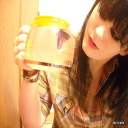

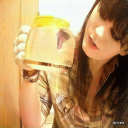

Validation Epoch : [100 / 125]	Loss-42.4438


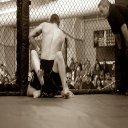

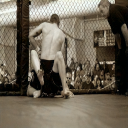

[Training] epoch 133 
Train Epoch : [133] [0 / 1125]	Loss-43.1494
Train Epoch : [133] [100 / 1125]	Loss-43.6288
Train Epoch : [133] [200 / 1125]	Loss-38.8934
Train Epoch : [133] [300 / 1125]	Loss-43.0697
Train Epoch : [133] [400 / 1125]	Loss-42.8231
Train Epoch : [133] [500 / 1125]	Loss-43.7485
Train Epoch : [133] [600 / 1125]	Loss-43.8360
Train Epoch : [133] [700 / 1125]	Loss-39.6773
Train Epoch : [133] [800 / 1125]	Loss-42.3616
Train Epoch : [133] [900 / 1125]	Loss-46.9378
Train Epoch : [133] [1000 / 1125]	Loss-44.9540
Train Epoch : [133] [1100 / 1125]	Loss-45.6975
Validation Epoch : [0 / 125]	Loss-46.8085


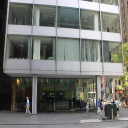

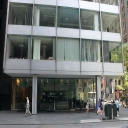

Validation Epoch : [100 / 125]	Loss-43.9445


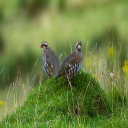

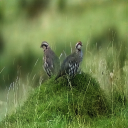

[Training] epoch 134 
Train Epoch : [134] [0 / 1125]	Loss-39.8806
Train Epoch : [134] [100 / 1125]	Loss-45.6831
Train Epoch : [134] [200 / 1125]	Loss-43.7463
Train Epoch : [134] [300 / 1125]	Loss-42.1188
Train Epoch : [134] [400 / 1125]	Loss-40.7860
Train Epoch : [134] [500 / 1125]	Loss-47.8124
Train Epoch : [134] [600 / 1125]	Loss-40.6123
Train Epoch : [134] [700 / 1125]	Loss-41.0528
Train Epoch : [134] [800 / 1125]	Loss-43.6810
Train Epoch : [134] [900 / 1125]	Loss-41.7973
Train Epoch : [134] [1000 / 1125]	Loss-40.4906
Train Epoch : [134] [1100 / 1125]	Loss-42.4951
Validation Epoch : [0 / 125]	Loss-42.6358


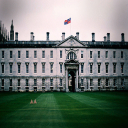

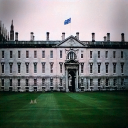

Validation Epoch : [100 / 125]	Loss-41.3373


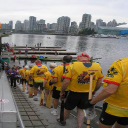

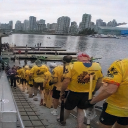

[Training] epoch 135 
Train Epoch : [135] [0 / 1125]	Loss-42.9710
Train Epoch : [135] [100 / 1125]	Loss-41.6813
Train Epoch : [135] [200 / 1125]	Loss-41.4994
Train Epoch : [135] [300 / 1125]	Loss-42.3437
Train Epoch : [135] [400 / 1125]	Loss-44.0710
Train Epoch : [135] [500 / 1125]	Loss-39.6099
Train Epoch : [135] [600 / 1125]	Loss-41.5913
Train Epoch : [135] [700 / 1125]	Loss-44.6063
Train Epoch : [135] [800 / 1125]	Loss-44.1276
Train Epoch : [135] [900 / 1125]	Loss-43.5976
Train Epoch : [135] [1000 / 1125]	Loss-40.8164
Train Epoch : [135] [1100 / 1125]	Loss-43.3248
Validation Epoch : [0 / 125]	Loss-47.1361


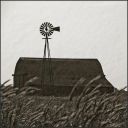

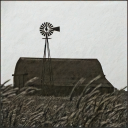

Validation Epoch : [100 / 125]	Loss-44.5192


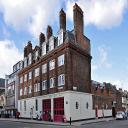

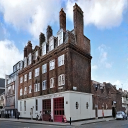

[Training] epoch 136 
Train Epoch : [136] [0 / 1125]	Loss-43.9173
Train Epoch : [136] [100 / 1125]	Loss-42.4460
Train Epoch : [136] [200 / 1125]	Loss-45.8245
Train Epoch : [136] [300 / 1125]	Loss-44.9186
Train Epoch : [136] [400 / 1125]	Loss-41.6347
Train Epoch : [136] [500 / 1125]	Loss-42.6973
Train Epoch : [136] [600 / 1125]	Loss-46.5263
Train Epoch : [136] [700 / 1125]	Loss-42.8785
Train Epoch : [136] [800 / 1125]	Loss-43.2881
Train Epoch : [136] [900 / 1125]	Loss-42.9841
Train Epoch : [136] [1000 / 1125]	Loss-46.2321
Train Epoch : [136] [1100 / 1125]	Loss-41.4453
Validation Epoch : [0 / 125]	Loss-39.2676


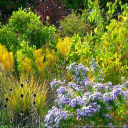

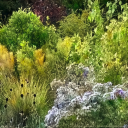

Validation Epoch : [100 / 125]	Loss-44.5151


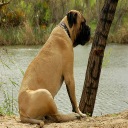

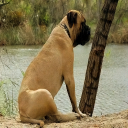

[Training] epoch 137 
Train Epoch : [137] [0 / 1125]	Loss-44.6947
Train Epoch : [137] [100 / 1125]	Loss-46.0541
Train Epoch : [137] [200 / 1125]	Loss-40.7316
Train Epoch : [137] [300 / 1125]	Loss-41.3390
Train Epoch : [137] [400 / 1125]	Loss-44.0368
Train Epoch : [137] [500 / 1125]	Loss-43.2425
Train Epoch : [137] [600 / 1125]	Loss-40.0569
Train Epoch : [137] [700 / 1125]	Loss-44.1367
Train Epoch : [137] [800 / 1125]	Loss-42.2381
Train Epoch : [137] [900 / 1125]	Loss-41.5096
Train Epoch : [137] [1000 / 1125]	Loss-41.0175
Train Epoch : [137] [1100 / 1125]	Loss-39.8373
Validation Epoch : [0 / 125]	Loss-39.3177


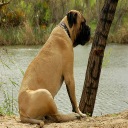

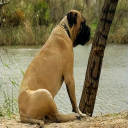

Validation Epoch : [100 / 125]	Loss-43.4811


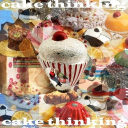

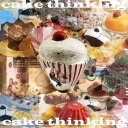

[Training] epoch 138 
Train Epoch : [138] [0 / 1125]	Loss-41.1619
Train Epoch : [138] [100 / 1125]	Loss-42.3393
Train Epoch : [138] [200 / 1125]	Loss-41.9466
Train Epoch : [138] [300 / 1125]	Loss-43.0283
Train Epoch : [138] [400 / 1125]	Loss-38.8501
Train Epoch : [138] [500 / 1125]	Loss-46.0911
Train Epoch : [138] [600 / 1125]	Loss-40.4779
Train Epoch : [138] [700 / 1125]	Loss-45.7607
Train Epoch : [138] [800 / 1125]	Loss-41.5111
Train Epoch : [138] [900 / 1125]	Loss-43.2614
Train Epoch : [138] [1000 / 1125]	Loss-43.0886
Train Epoch : [138] [1100 / 1125]	Loss-42.2803
Validation Epoch : [0 / 125]	Loss-43.6822


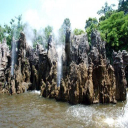

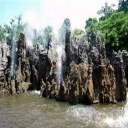

Validation Epoch : [100 / 125]	Loss-44.9736


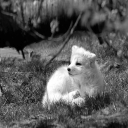

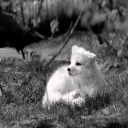

[Training] epoch 139 
Train Epoch : [139] [0 / 1125]	Loss-39.5184
Train Epoch : [139] [100 / 1125]	Loss-41.0490
Train Epoch : [139] [200 / 1125]	Loss-44.6112
Train Epoch : [139] [300 / 1125]	Loss-41.6597
Train Epoch : [139] [400 / 1125]	Loss-44.7158
Train Epoch : [139] [500 / 1125]	Loss-48.1161
Train Epoch : [139] [600 / 1125]	Loss-43.2977
Train Epoch : [139] [700 / 1125]	Loss-41.0140
Train Epoch : [139] [800 / 1125]	Loss-42.7914
Train Epoch : [139] [900 / 1125]	Loss-41.7084
Train Epoch : [139] [1000 / 1125]	Loss-40.1487
Train Epoch : [139] [1100 / 1125]	Loss-40.1778
Validation Epoch : [0 / 125]	Loss-37.9209


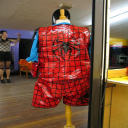

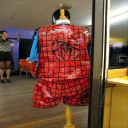

Validation Epoch : [100 / 125]	Loss-42.8128


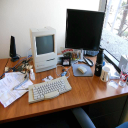

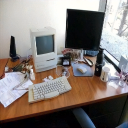

[Training] epoch 140 
Train Epoch : [140] [0 / 1125]	Loss-44.6061
Train Epoch : [140] [100 / 1125]	Loss-44.4192
Train Epoch : [140] [200 / 1125]	Loss-36.5024
Train Epoch : [140] [300 / 1125]	Loss-40.9781
Train Epoch : [140] [400 / 1125]	Loss-44.4340
Train Epoch : [140] [500 / 1125]	Loss-41.2646
Train Epoch : [140] [600 / 1125]	Loss-44.9043
Train Epoch : [140] [700 / 1125]	Loss-41.0407
Train Epoch : [140] [800 / 1125]	Loss-39.3379
Train Epoch : [140] [900 / 1125]	Loss-42.1423
Train Epoch : [140] [1000 / 1125]	Loss-42.1359
Train Epoch : [140] [1100 / 1125]	Loss-41.7098
Validation Epoch : [0 / 125]	Loss-43.5938


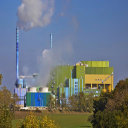

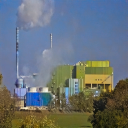

Validation Epoch : [100 / 125]	Loss-42.1144


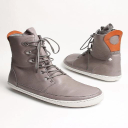

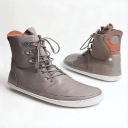

[Training] epoch 141 
Train Epoch : [141] [0 / 1125]	Loss-41.8764
Train Epoch : [141] [100 / 1125]	Loss-42.4711
Train Epoch : [141] [200 / 1125]	Loss-46.2800
Train Epoch : [141] [300 / 1125]	Loss-38.5939
Train Epoch : [141] [400 / 1125]	Loss-42.3438
Train Epoch : [141] [500 / 1125]	Loss-43.3544
Train Epoch : [141] [600 / 1125]	Loss-44.8107
Train Epoch : [141] [700 / 1125]	Loss-43.0716
Train Epoch : [141] [800 / 1125]	Loss-41.6307
Train Epoch : [141] [900 / 1125]	Loss-44.8150
Train Epoch : [141] [1000 / 1125]	Loss-35.3561
Train Epoch : [141] [1100 / 1125]	Loss-41.1660
Validation Epoch : [0 / 125]	Loss-42.4927


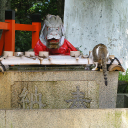

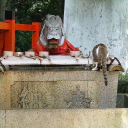

Validation Epoch : [100 / 125]	Loss-42.7186


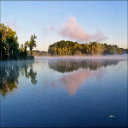

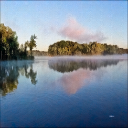

[Training] epoch 142 
Train Epoch : [142] [0 / 1125]	Loss-38.5182
Train Epoch : [142] [100 / 1125]	Loss-38.4537
Train Epoch : [142] [200 / 1125]	Loss-41.9687
Train Epoch : [142] [300 / 1125]	Loss-41.6487
Train Epoch : [142] [400 / 1125]	Loss-41.0846
Train Epoch : [142] [500 / 1125]	Loss-39.4138
Train Epoch : [142] [600 / 1125]	Loss-41.1330
Train Epoch : [142] [700 / 1125]	Loss-41.0464
Train Epoch : [142] [800 / 1125]	Loss-41.4582
Train Epoch : [142] [900 / 1125]	Loss-43.7075
Train Epoch : [142] [1000 / 1125]	Loss-47.1743
Train Epoch : [142] [1100 / 1125]	Loss-41.3211
Validation Epoch : [0 / 125]	Loss-42.9998


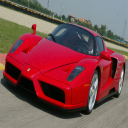

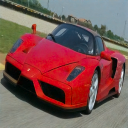

Validation Epoch : [100 / 125]	Loss-42.2890


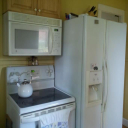

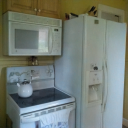

[Training] epoch 143 
Train Epoch : [143] [0 / 1125]	Loss-42.6791
Train Epoch : [143] [100 / 1125]	Loss-43.8690
Train Epoch : [143] [200 / 1125]	Loss-43.4609
Train Epoch : [143] [300 / 1125]	Loss-44.8096
Train Epoch : [143] [400 / 1125]	Loss-41.7191
Train Epoch : [143] [500 / 1125]	Loss-44.0093
Train Epoch : [143] [600 / 1125]	Loss-41.1352
Train Epoch : [143] [700 / 1125]	Loss-42.0760
Train Epoch : [143] [800 / 1125]	Loss-43.4284
Train Epoch : [143] [900 / 1125]	Loss-44.7424
Train Epoch : [143] [1000 / 1125]	Loss-45.5673
Train Epoch : [143] [1100 / 1125]	Loss-43.6399
Validation Epoch : [0 / 125]	Loss-44.0792


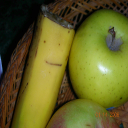

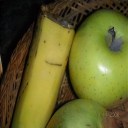

Validation Epoch : [100 / 125]	Loss-43.8027


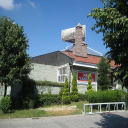

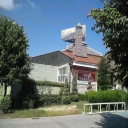

[Training] epoch 144 
Train Epoch : [144] [0 / 1125]	Loss-42.5376
Train Epoch : [144] [100 / 1125]	Loss-43.1770
Train Epoch : [144] [200 / 1125]	Loss-42.7584
Train Epoch : [144] [300 / 1125]	Loss-44.6813
Train Epoch : [144] [400 / 1125]	Loss-45.6381
Train Epoch : [144] [500 / 1125]	Loss-44.9752
Train Epoch : [144] [600 / 1125]	Loss-41.9060
Train Epoch : [144] [700 / 1125]	Loss-42.7431
Train Epoch : [144] [800 / 1125]	Loss-43.2553
Train Epoch : [144] [900 / 1125]	Loss-44.4258
Train Epoch : [144] [1000 / 1125]	Loss-39.2355
Train Epoch : [144] [1100 / 1125]	Loss-43.3675
Validation Epoch : [0 / 125]	Loss-47.4662


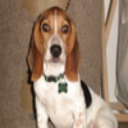

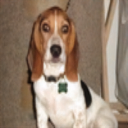

Validation Epoch : [100 / 125]	Loss-42.5540


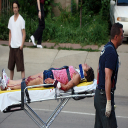

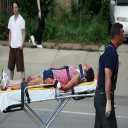

[Training] epoch 145 
Train Epoch : [145] [0 / 1125]	Loss-44.3340
Train Epoch : [145] [100 / 1125]	Loss-43.8356
Train Epoch : [145] [200 / 1125]	Loss-41.9430
Train Epoch : [145] [300 / 1125]	Loss-41.3507
Train Epoch : [145] [400 / 1125]	Loss-42.8567
Train Epoch : [145] [500 / 1125]	Loss-39.7797
Train Epoch : [145] [600 / 1125]	Loss-40.8096
Train Epoch : [145] [700 / 1125]	Loss-43.1659
Train Epoch : [145] [800 / 1125]	Loss-40.0803
Train Epoch : [145] [900 / 1125]	Loss-42.8541
Train Epoch : [145] [1000 / 1125]	Loss-44.0740
Train Epoch : [145] [1100 / 1125]	Loss-45.1061
Validation Epoch : [0 / 125]	Loss-41.7604


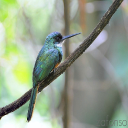

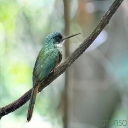

Validation Epoch : [100 / 125]	Loss-44.3307


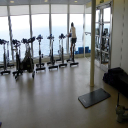

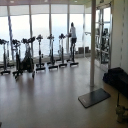

[Training] epoch 146 
Train Epoch : [146] [0 / 1125]	Loss-44.4826
Train Epoch : [146] [100 / 1125]	Loss-40.2284
Train Epoch : [146] [200 / 1125]	Loss-40.2730
Train Epoch : [146] [300 / 1125]	Loss-45.8285
Train Epoch : [146] [400 / 1125]	Loss-40.5629
Train Epoch : [146] [500 / 1125]	Loss-46.9314
Train Epoch : [146] [600 / 1125]	Loss-42.2640
Train Epoch : [146] [700 / 1125]	Loss-42.3980
Train Epoch : [146] [800 / 1125]	Loss-41.8608
Train Epoch : [146] [900 / 1125]	Loss-46.1768
Train Epoch : [146] [1000 / 1125]	Loss-46.2019
Train Epoch : [146] [1100 / 1125]	Loss-44.3399
Validation Epoch : [0 / 125]	Loss-41.7067


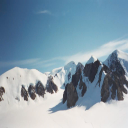

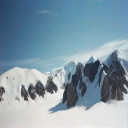

Validation Epoch : [100 / 125]	Loss-44.8626


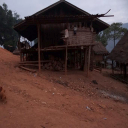

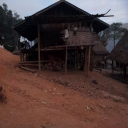

[Training] epoch 147 
Train Epoch : [147] [0 / 1125]	Loss-43.8875
Train Epoch : [147] [100 / 1125]	Loss-44.4104
Train Epoch : [147] [200 / 1125]	Loss-42.4899
Train Epoch : [147] [300 / 1125]	Loss-42.7330
Train Epoch : [147] [400 / 1125]	Loss-44.3344
Train Epoch : [147] [500 / 1125]	Loss-46.2045
Train Epoch : [147] [600 / 1125]	Loss-45.0355
Train Epoch : [147] [700 / 1125]	Loss-46.2941
Train Epoch : [147] [800 / 1125]	Loss-46.5087
Train Epoch : [147] [900 / 1125]	Loss-42.6934
Train Epoch : [147] [1000 / 1125]	Loss-44.9640
Train Epoch : [147] [1100 / 1125]	Loss-43.4176
Validation Epoch : [0 / 125]	Loss-40.4079


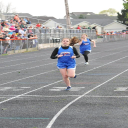

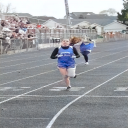

Validation Epoch : [100 / 125]	Loss-40.2465


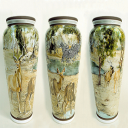

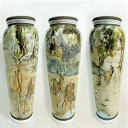

[Training] epoch 148 
Train Epoch : [148] [0 / 1125]	Loss-43.0243
Train Epoch : [148] [100 / 1125]	Loss-42.9352
Train Epoch : [148] [200 / 1125]	Loss-42.0055
Train Epoch : [148] [300 / 1125]	Loss-40.7415
Train Epoch : [148] [400 / 1125]	Loss-47.2771
Train Epoch : [148] [500 / 1125]	Loss-39.7342
Train Epoch : [148] [600 / 1125]	Loss-41.6040
Train Epoch : [148] [700 / 1125]	Loss-43.4552
Train Epoch : [148] [800 / 1125]	Loss-44.5046
Train Epoch : [148] [900 / 1125]	Loss-47.2013
Train Epoch : [148] [1000 / 1125]	Loss-40.8479
Train Epoch : [148] [1100 / 1125]	Loss-44.0944
Validation Epoch : [0 / 125]	Loss-44.4865


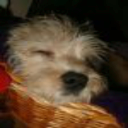

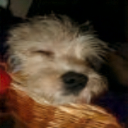

Validation Epoch : [100 / 125]	Loss-45.2673


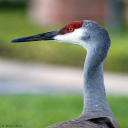

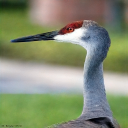

[Training] epoch 149 
Train Epoch : [149] [0 / 1125]	Loss-44.2850
Train Epoch : [149] [100 / 1125]	Loss-41.7999
Train Epoch : [149] [200 / 1125]	Loss-38.6777
Train Epoch : [149] [300 / 1125]	Loss-43.0783
Train Epoch : [149] [400 / 1125]	Loss-41.3572
Train Epoch : [149] [500 / 1125]	Loss-44.7398
Train Epoch : [149] [600 / 1125]	Loss-40.3981
Train Epoch : [149] [700 / 1125]	Loss-42.8364
Train Epoch : [149] [800 / 1125]	Loss-42.6494
Train Epoch : [149] [900 / 1125]	Loss-42.9298
Train Epoch : [149] [1000 / 1125]	Loss-44.4665
Train Epoch : [149] [1100 / 1125]	Loss-44.5913
Validation Epoch : [0 / 125]	Loss-43.0469


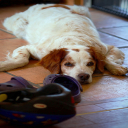

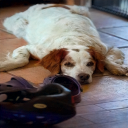

Validation Epoch : [100 / 125]	Loss-42.5238


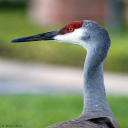

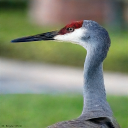

In [ ]:
import torch
import torch.utils.data  as data
import os
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from torchvision import transforms
import torch.optim as optim
import tqdm
from PIL import Image
import numpy as np

import torch.nn as nn   
from torch.nn.functional import mse_loss as mse   

# Change to your data root directory
root_path = "/content/"
# Depend on runtime setting
device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 

train_dataset = ColorHintDataset(root_path, 128)
train_dataset.set_mode("training")

val_dataset = ColorHintDataset(root_path, 128)
val_dataset.set_mode("validation")

train_dataloader = data.DataLoader(train_dataset, batch_size=4, shuffle=True)
val_dataloader = data.DataLoader(val_dataset, batch_size=4, shuffle=True)

# ================== define helper function ==================

class AverageMeter(object):
  def __init__(self):
    self.reset()
  def reset(self):
    self.val, self.avg, self.sum, self.count = 0, 0, 0, 0
  def update(self, val, n=1):
    self.val = val
    self.sum += val * n
    self.count += n
    self.avg = self.sum / self.count

# ================== define train and validation ==================

def train(model, train_dataloader, optimizer, criterion, epoch):
  print('[Training] epoch {} '.format(epoch))
  model.train()
  losses = AverageMeter()
  
  for i, data in enumerate(train_dataloader):
    
    # if use_cuda:
    l = data["l"].cuda()
    ab = data["ab"].cuda()
    hint = data["hint"].cuda()
    mask = data["mask"].cuda()
    
    # concat
    gt_image = torch.cat((l, ab), dim=1).cuda()
    #print('\n===== img size =====\n', gt_image.shape)
    hint_image = torch.cat((l, hint, mask), dim=1).cuda()
    #print('===== hint size =====\n', hint_image.shape)

    # run forward
    output_ab = model(hint_image)
    loss = criterion(output_ab, gt_image)
    losses.update(loss.item(), hint_image.size(0))

    # compute gradient and optimize
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if i%100==0:
      print('Train Epoch : [{}] [{} / {}]\tLoss{loss.val:.4f}'.format(epoch, i, len(train_dataloader),loss=losses))


def validation(model, train_dataloader, criterion, epoch):
  model.eval()
  losses = AverageMeter()
  
  for i, data in enumerate(val_dataloader):
    
    # if use_cuda:
    l = data["l"].cuda()
    ab = data["ab"].cuda()
    hint = data["hint"].cuda()
    mask = data["mask"].cuda()

    # concat
    gt_image = torch.cat((l, ab), dim=1).cuda()
    #print('\n===== img size =====\n', gt_image.shape)
    hint_image = torch.cat((l, hint, mask), dim=1).cuda()
    #print('===== hint size =====\n', hint_image.shape)

    # run model and store loss
    output_ab = model(hint_image)
    loss = criterion(output_ab, gt_image)
    losses.update(loss.item(), hint_image.size(0))
      
    gt_np = tensor2im(gt_image)
    #print('\n===== gt size =====\n', gt_np.shape)
    hint_np = tensor2im(output_ab)
    #print('===== hint size =====\n', hint_np.shape)

    gt_bgr = cv2.cvtColor(gt_np, cv2.COLOR_LAB2BGR)
    hint_bgr = cv2.cvtColor(hint_np, cv2.COLOR_LAB2BGR)
  
    os.makedirs('/content/predictions',exist_ok=True)
    cv2.imwrite('/content/predictions/pred_'+str(i)+'.jpg',hint_bgr)

    os.makedirs('/content/gt',exist_ok=True)
    cv2.imwrite('/content/gt/gt_'+str(i)+'.jpg',gt_bgr)

    if i%100==0:
      print('Validation Epoch : [{} / {}]\tLoss{loss.val:.4f}'.format(i, len(val_dataloader),loss=losses))

      cv2_imshow(gt_bgr)
      cv2_imshow(hint_bgr)
  
  return losses.avg

# ================== define psnr and psnr_loss ==================

def psnr(input: torch.Tensor, target: torch.Tensor, max_val: float) -> torch.Tensor:
  if not isinstance(input, torch.Tensor):
      raise TypeError(f"Expected torch.Tensor but got {type(target)}.")

  if not isinstance(target, torch.Tensor):
      raise TypeError(f"Expected torch.Tensor but got {type(input)}.")

  if input.shape != target.shape:
      raise TypeError(f"Expected tensors of equal shapes, but got {input.shape} and {target.shape}")

  return 10. * torch.log10(max_val ** 2 / mse(input, target, reduction='mean'))

def psnr_loss(input: torch.Tensor, target: torch.Tensor, max_val: float) -> torch.Tensor:
  return -1. * psnr(input, target, max_val)

# ================== class PSNRLoss ================== 

class PSNRLoss(nn.Module):
  def __init__(self, max_val: float) -> None:
    super(PSNRLoss, self).__init__()
    self.max_val: float = max_val

  def forward(self, input: torch.Tensor, target: torch.Tensor) -> torch.Tensor:
    return psnr_loss(input, target, self.max_val)

# ====================================================

model = UnetGenerator()
criterion = PSNRLoss(2.)
# criterion = nn.BCELoss()
# criterion = nn.MSELoss()
# criterion = nn.BCEWithLogitsLoss()
# criterion = nn.CrossEntropyLoss()

optimizer = optim.Adam(model.parameters(), lr=0.00025) # 1e-2 # 0.0005 # 0.00025 # 0.0002
epochs = 150 
best_losses = 10

save_path = './Result'
os.makedirs(save_path, exist_ok=True)
output_path = os.path.join(save_path, 'validation_model.tar')

model.cuda()

for epoch in range(epochs):
  train(model, train_dataloader, optimizer, criterion, epoch)
  with torch.no_grad():
    val_losses = validation(model, val_dataloader, criterion, epoch)

  if best_losses > val_losses:
    best_losses = val_losses
    torch.save(model.state_dict(), '/content/drive/MyDrive/Myungji/PSNR/PSNR-epoch-{}-losses-{:.5f}.pth'.format(epoch + 1, best_losses))
    

# Testing

In [ ]:
import os
import zipfile
import tqdm

file_name = "colorization_test_dataset.zip"
zip_path = os.path.join('/content/drive/MyDrive/colorization_test_dataset.zip')

!cp "{zip_path}" .
!unzip -q "{file_name}"

replace hint/0.png? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [ ]:
import torch
import os
import cv2
import numpy as np
from PIL import Image
from google.colab import drive

def image_save(img, path):
  if isinstance(img, torch.Tensor):
    img = np.asarray(transforms.ToPILImage()(img))
  img = cv2.cvtColor(img, cv2.COLOR_LAB2BGR)
  cv2.imwrite(path, img)

root_path = "/content/"
result_save_path = "/content/drive/MyDrive/Myungji/result2" # input best loss's model

test_dataset = ColorHintDataset(root_path, 128)
test_dataset.set_mode('testing')
print('Test length : ', len(test_dataset))

test_dataloader = data.DataLoader(test_dataset, batch_size=1, shuffle=False)

model = UnetGenerator().cuda()

# input best loss model
model_path = os.path.join('/content/drive/MyDrive/Myungji/PSNR/PSNR-epoch-114-losses--42.57659.pth')
model.load_state_dict(torch.load(model_path))

# =========================================================

def test(model, test_dataloader): 
  
  model.eval() # same as testing mode
  for i, data in enumerate(test_dataloader):
    l = data["l"].cuda()
    # print('\n===== l size =====\n', l.shape) # [1, 1, 128, 128]
    hint = data["hint"].cuda()
    # print('\n===== hint size =====\n', hint.shape) # [1, 2, 128, 128]
    mask = data["mask"].cuda()  # add mask

    file_name = data['file_name']

    with torch.no_grad():
      out = torch.cat((l, hint, mask), dim=1) # add mask
      pred_image = model(out)

      for idx in range(len(file_name)):
        image_save(pred_image[idx], os.path.join(result_save_path, file_name[idx]))

# =========================================================

test(model, test_dataloader)


Test length :  1000
